이미지 크기: (1411, 1058)


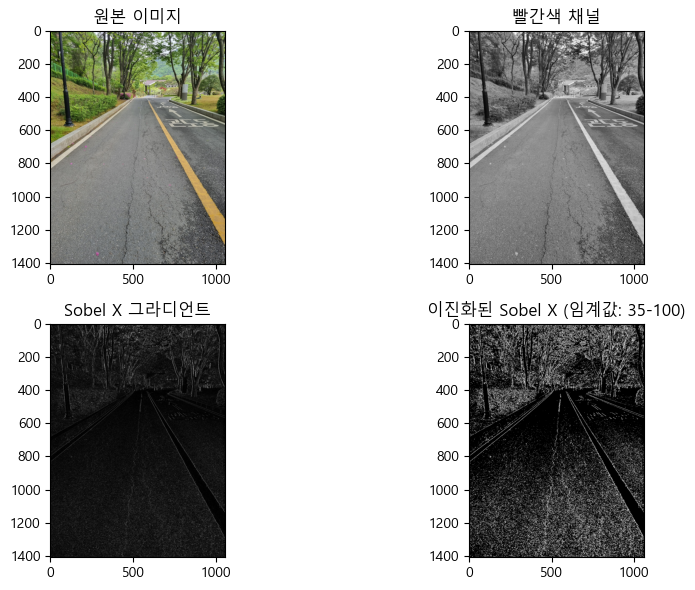

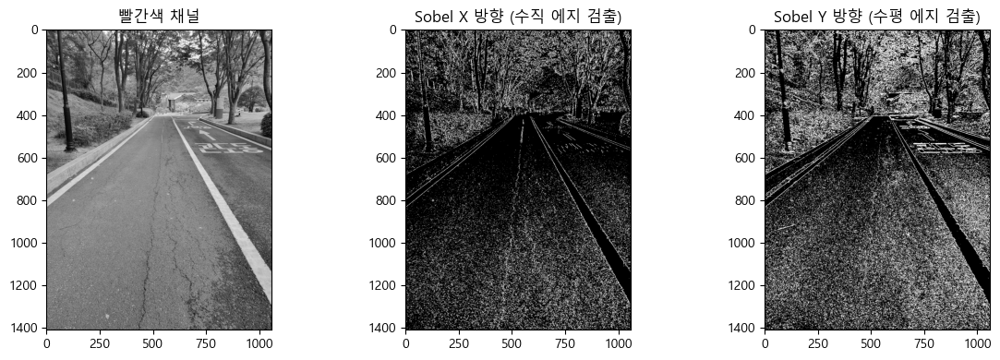

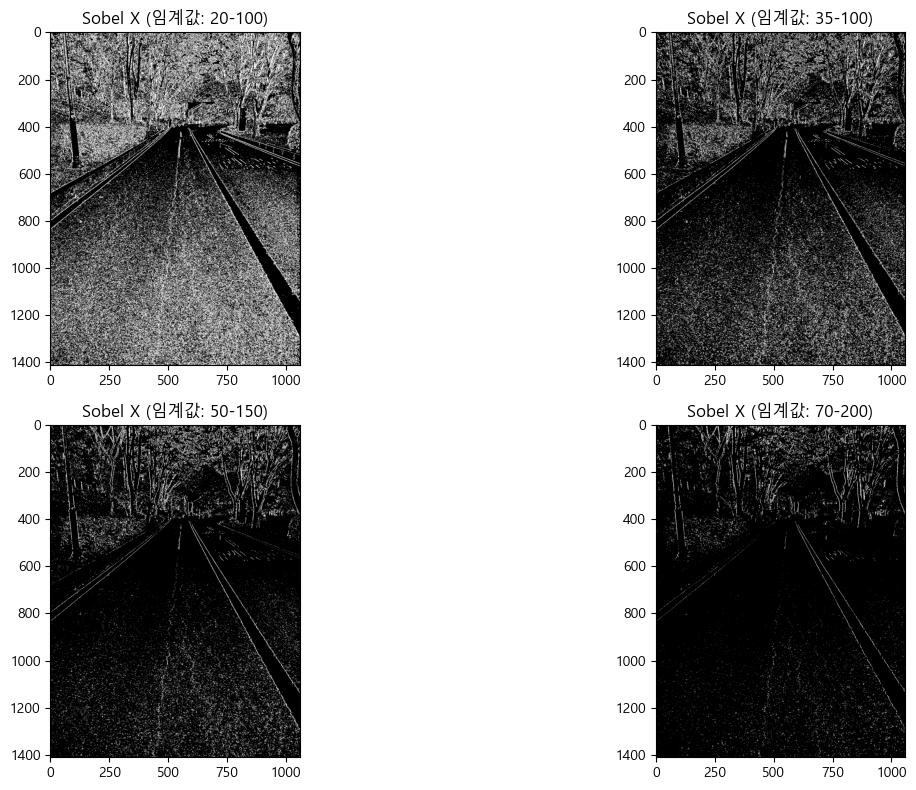

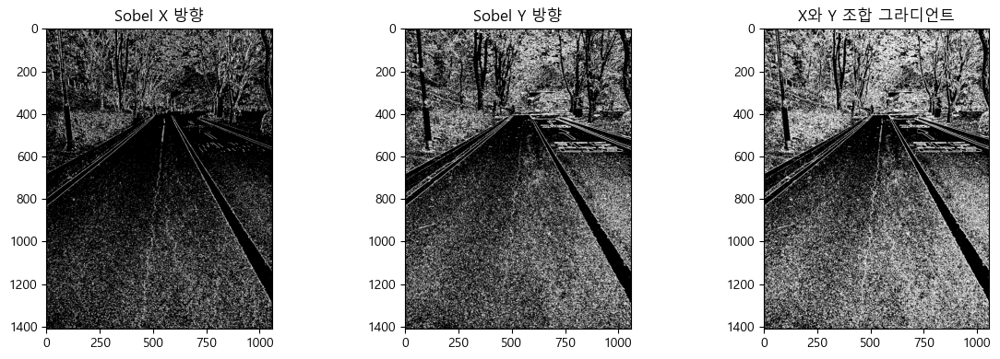

In [8]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage import exposure
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows용)
import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# 이미지 읽기 (리사이징 없이 원본 크기 그대로)
img = cv2.imread('./image/test_image_01.jpg')

# 이미지의 높이와 너비 추출
height, width = img.shape[:2]
print(f"이미지 크기: {img.shape[:2]}")

# 이미지 표시
plt.figure(figsize=(10, 6))
plt.subplot(2, 2, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

# 관심 영역을 원본 이미지 전체로 설정 (빨간색 채널만 사용)
roi = img[:, :, 2]  # 전체 이미지의 빨간색 채널 사용

plt.subplot(2, 2, 2)
plt.title('빨간색 채널')
plt.imshow(roi, cmap='gray')

# Sobel X 방향 그라디언트 계산
abs_sobel = np.absolute(cv2.Sobel(roi, cv2.CV_64F, 1, 0))
scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

# 이진화 (임계값 적용)
th_sobelx = (35, 100)
sobel_x = np.zeros_like(scaled_sobel)
sobel_x[(scaled_sobel >= th_sobelx[0]) & (scaled_sobel <= th_sobelx[1])] = 255

plt.subplot(2, 2, 3)
plt.title('Sobel X 그라디언트')
plt.imshow(scaled_sobel, cmap='gray')

plt.subplot(2, 2, 4)
plt.title('이진화된 Sobel X (임계값: 35-100)')
plt.imshow(sobel_x, cmap='gray')

plt.tight_layout()
plt.show()

# Sobel XY 함수 정의
def sobel_xy(img, orient='x', thresh=(20, 100)):
    """
    X 또는 Y 방향으로 Sobel 필터를 적용하는 함수
    X 방향 그라디언트는 수직에 가까운 에지를 강조 (차선과 같은 수직선)
    Y 방향 그라디언트는 수평에 가까운 에지를 강조
    """
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))
    else:  # orient == 'y'
        abs_sobel = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))
    
    # 8비트 정수로 스케일링
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    binary_output = np.zeros_like(scaled_sobel)
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 255
    
    return binary_output

# X와 Y 방향 소벨 필터 적용 결과 표시
plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.title('빨간색 채널')
plt.imshow(roi, cmap='gray')

sobelx_result = sobel_xy(roi, orient='x', thresh=th_sobelx)
plt.subplot(1, 3, 2)
plt.title('Sobel X 방향 (수직 에지 검출)')
plt.imshow(sobelx_result, cmap='gray')

sobely_result = sobel_xy(roi, orient='y', thresh=(30, 255))
plt.subplot(1, 3, 3)
plt.title('Sobel Y 방향 (수평 에지 검출)')
plt.imshow(sobely_result, cmap='gray')

plt.tight_layout()
plt.show()

# 추가로 다양한 임계값에 따른 결과 비교
plt.figure(figsize=(15, 8))

thresholds = [(20, 100), (35, 100), (50, 150), (70, 200)]
for i, thresh in enumerate(thresholds):
    plt.subplot(2, 2, i+1)
    result = sobel_xy(roi, orient='x', thresh=thresh)
    plt.title(f'Sobel X (임계값: {thresh[0]}-{thresh[1]})')
    plt.imshow(result, cmap='gray')

plt.tight_layout()
plt.show()

# X, Y 그라디언트 조합
def combine_gradients(img):
    """
    X와 Y 방향 그라디언트를 조합하여 에지 검출
    """
    # X, Y 방향 소벨 필터 적용
    sobelx = sobel_xy(img, orient='x', thresh=th_sobelx)
    sobely = sobel_xy(img, orient='y', thresh=(30, 255))
    
    # 그라디언트 조합: X 또는 Y 방향 그라디언트가 감지된 픽셀
    combined = np.zeros_like(sobelx)
    combined[(sobelx == 255) | (sobely == 255)] = 255
    
    return combined

# 그라디언트 조합 결과 표시
combined_gradient = combine_gradients(roi)

plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1)
plt.title('Sobel X 방향')
plt.imshow(sobelx_result, cmap='gray')

plt.subplot(1, 3, 2)
plt.title('Sobel Y 방향')
plt.imshow(sobely_result, cmap='gray')

plt.subplot(1, 3, 3)
plt.title('X와 Y 조합 그라디언트')
plt.imshow(combined_gradient, cmap='gray')

plt.tight_layout()
plt.show()

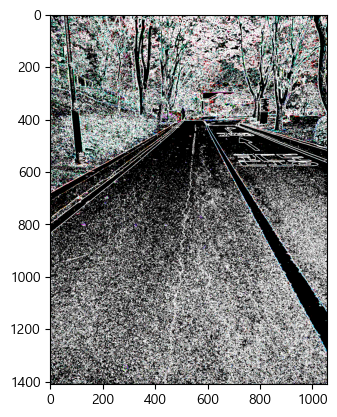

In [9]:
# gradient magnitude is used to measure how strong the change in image intensity is

# Take both Sobel x and y gradients
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)

# Calculate the gradient magnitude
gradmag = np.sqrt(sobelx**2 + sobely**2)

# Rescale to 8 bit
scale_factor = np.max(gradmag)/255
gradmag = (gradmag/scale_factor).astype(np.uint8)

th_mag = (30, 255)

gradient_magnitude = np.zeros_like(gradmag)
gradient_magnitude[(gradmag >= th_mag[0]) & (gradmag <= th_mag[1])] = 255
plt.imshow(gradient_magnitude)

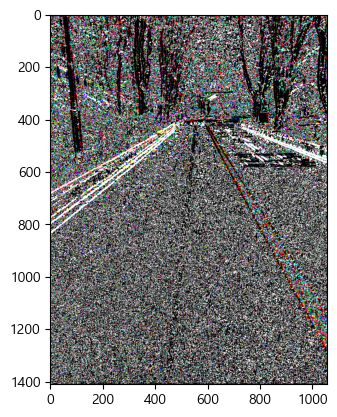

In [10]:
# Calculate the x and y gradients
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=15)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=15)

# Take the absolute value of the gradient direction,
# apply a threshold, and create a binary image result
absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
gradient_direction = np.zeros_like(absgraddir)

th_dir = (0.7, 1.3)
gradient_direction[(absgraddir >= th_dir[0]) & (absgraddir <= th_dir[1])] = 255
gradient_direction = gradient_direction.astype(np.uint8)
plt.imshow(gradient_direction)

이미지 크기: (1411, 1058)


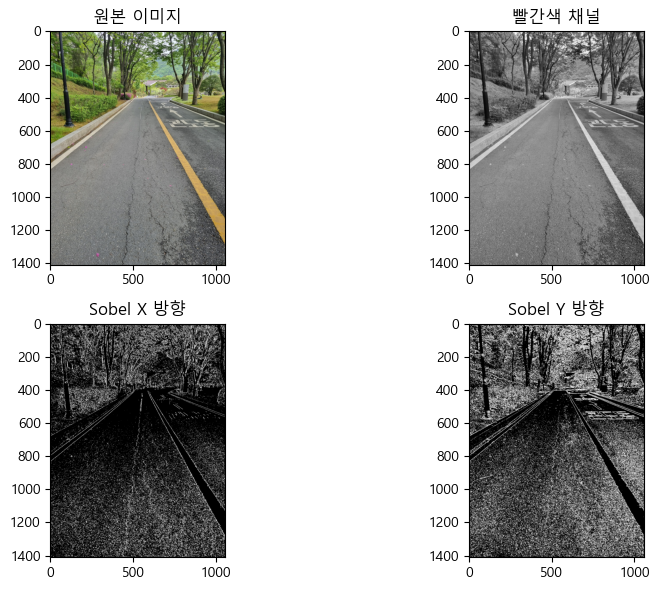

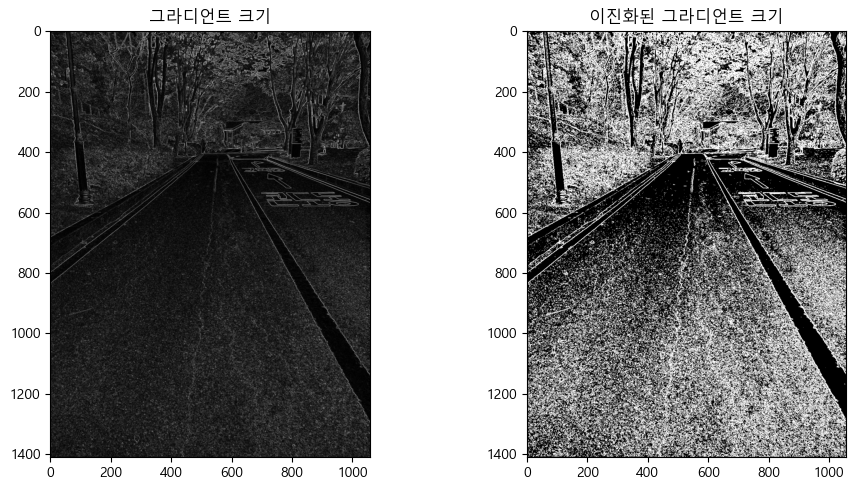

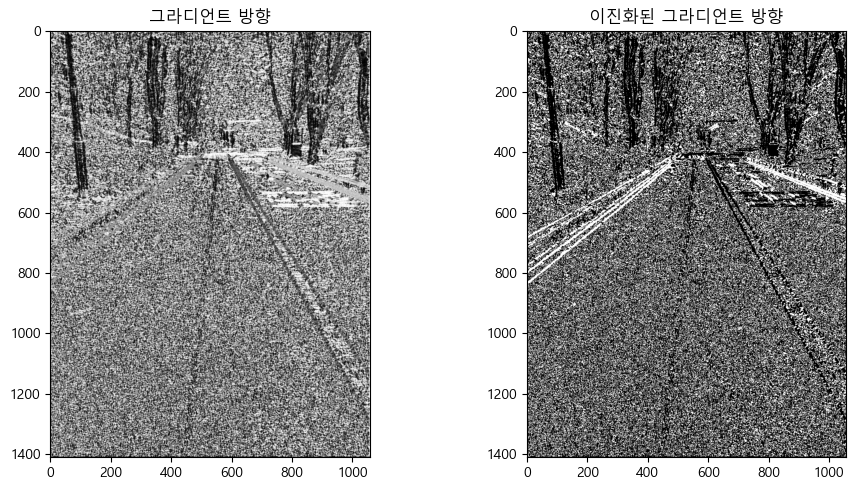

sobel_x 형태: (1411, 1058)
sobel_y 형태: (1411, 1058)
gradient_magnitude 형태: (1411, 1058)
gradient_direction 형태: (1411, 1058)


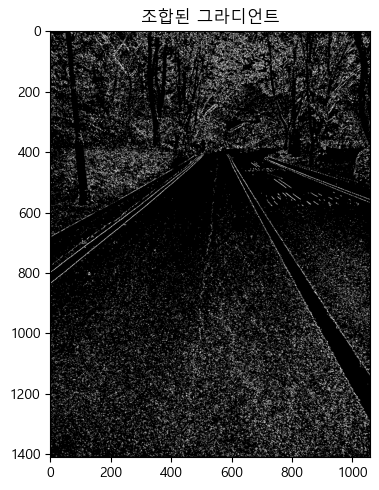

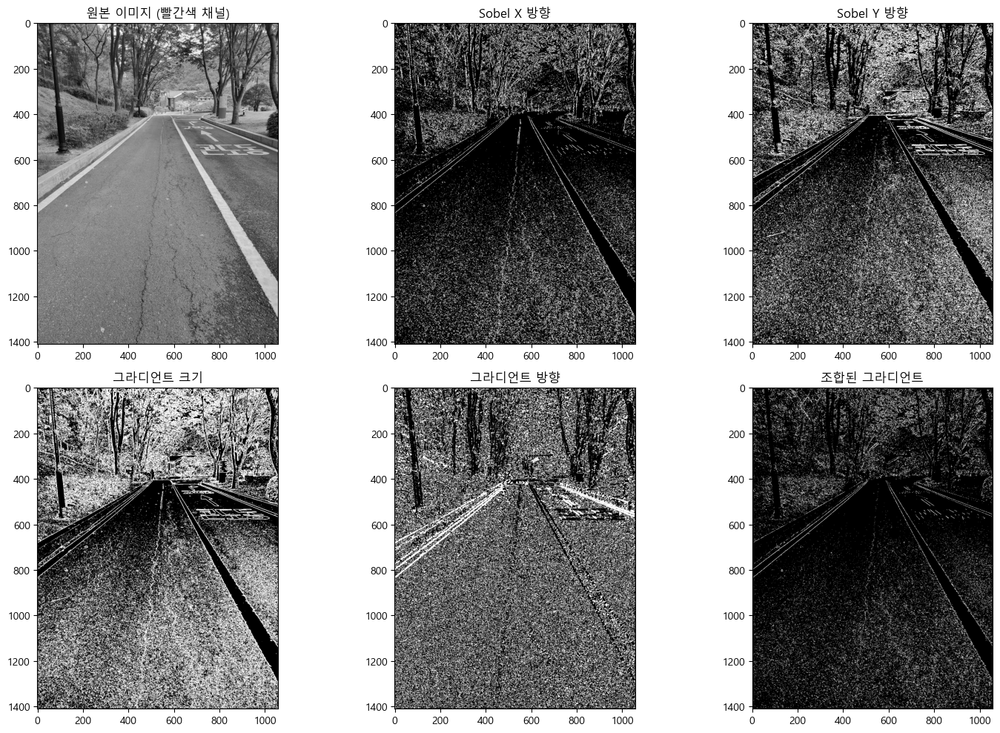

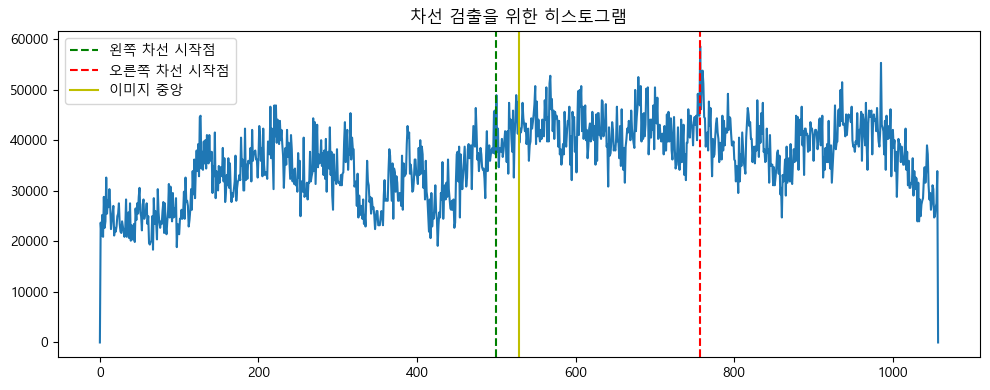

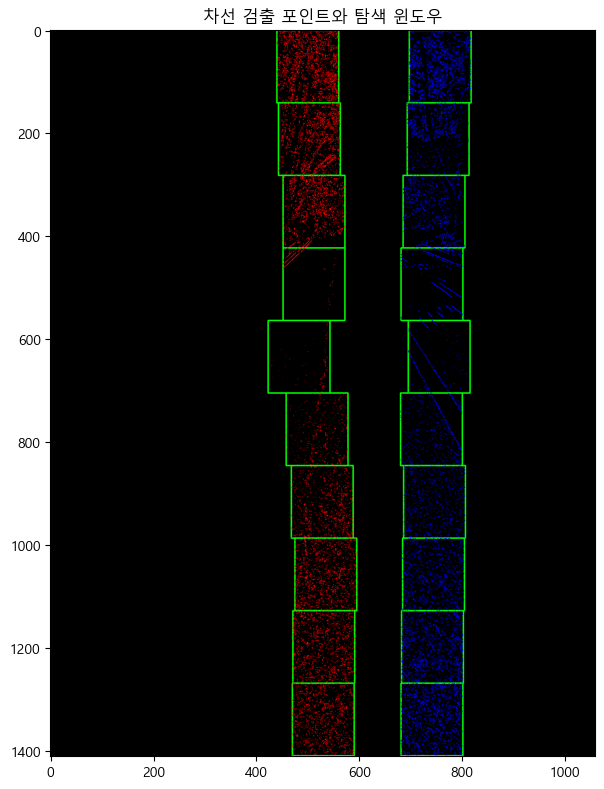

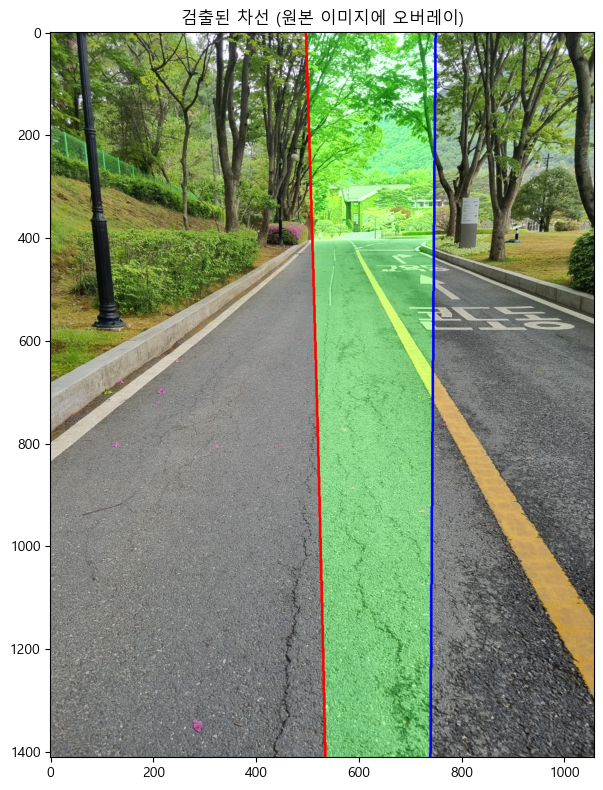

이미지 하단에서 차선 간 거리: 204.37 픽셀
왼쪽 차선 곡률: 113164.95 픽셀
오른쪽 차선 곡률: 486051.63 픽셀
차량 위치 오프셋: -108.78 픽셀 (왼쪽)


In [ ]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage import exposure
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows용)
import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# 이미지 읽기 (리사이징 없이 원본 크기 그대로)
src = cv2.imread('./image/test_image_01.jpg')

# 이미지의 높이와 너비 추출
height, width = src.shape[:2]
print(f"이미지 크기: {src.shape[:2]}")

# 이미지 표시
plt.figure(figsize=(10, 6))
plt.subplot(2, 2, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))

# 관심 영역을 원본 이미지 전체의 빨간색 채널로 설정
img = src[:, :, 2]  # 전체 이미지의 빨간색 채널 사용

plt.subplot(2, 2, 2)
plt.title('빨간색 채널')
plt.imshow(img, cmap='gray')

# Sobel X 방향 그라디언트 계산 및 이진화
abs_sobel_x = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))
scaled_sobel_x = np.uint8(255*abs_sobel_x/np.max(abs_sobel_x))

th_sobelx = (35, 100)
sobel_x = np.zeros_like(scaled_sobel_x)
sobel_x[(scaled_sobel_x >= th_sobelx[0]) & (scaled_sobel_x <= th_sobelx[1])] = 255

plt.subplot(2, 2, 3)
plt.title('Sobel X 방향')
plt.imshow(sobel_x, cmap='gray')

# Sobel Y 방향 그라디언트 계산 및 이진화 (추가)
abs_sobel_y = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))
scaled_sobel_y = np.uint8(255*abs_sobel_y/np.max(abs_sobel_y))

th_sobely = (30, 255)
sobel_y = np.zeros_like(scaled_sobel_y)
sobel_y[(scaled_sobel_y >= th_sobely[0]) & (scaled_sobel_y <= th_sobely[1])] = 255

plt.subplot(2, 2, 4)
plt.title('Sobel Y 방향')
plt.imshow(sobel_y, cmap='gray')

plt.tight_layout()
plt.show()

# 그라디언트 크기 계산
# Calculate the magnitude of the gradient
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1)
gradient_magnitude = np.sqrt(sobelx**2 + sobely**2)
scale_factor = np.max(gradient_magnitude)/255 
gradient_magnitude = (gradient_magnitude/scale_factor).astype(np.uint8)

# 그라디언트 크기 이진화
th_mag = (30, 255)
mag_binary = np.zeros_like(gradient_magnitude)
mag_binary[(gradient_magnitude >= th_mag[0]) & (gradient_magnitude <= th_mag[1])] = 255

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('그라디언트 크기')
plt.imshow(gradient_magnitude, cmap='gray')

plt.subplot(1, 2, 2)
plt.title('이진화된 그라디언트 크기')
plt.imshow(mag_binary, cmap='gray')

plt.tight_layout()
plt.show()

# 그라디언트 방향 계산 (요청한 코드)
# Calculate the x and y gradients with ksize=15
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=15)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=15)

# Take the absolute value of the gradient direction,
# apply a threshold, and create a binary image result
absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
gradient_direction = np.zeros_like(absgraddir)

th_dir = (0.7, 1.3)
gradient_direction[(absgraddir >= th_dir[0]) & (absgraddir <= th_dir[1])] = 255
gradient_direction = gradient_direction.astype(np.uint8)

plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title('그라디언트 방향')
plt.imshow(absgraddir, cmap='gray')

plt.subplot(1, 2, 2)
plt.title('이진화된 그라디언트 방향')
plt.imshow(gradient_direction, cmap='gray')

plt.tight_layout()
plt.show()

# 그라디언트 조합 - 오류 수정
# 기존 코드에서 sobel_x, sobel_y, gradient_magnitude, gradient_direction이 모두 2D 배열인지 확인
print(f'sobel_x 형태: {sobel_x.shape}')
print(f'sobel_y 형태: {sobel_y.shape}')
print(f'gradient_magnitude 형태: {gradient_magnitude.shape}')
print(f'gradient_direction 형태: {gradient_direction.shape}')

# 그라디언트 조합을 위해 모든 값이 2D 배열인지 확인하고, 문제 해결
grad_combine = np.zeros_like(gradient_direction).astype(np.uint8)

# 조건 연산에 2D 배열만 사용 (수정된 코드)
grad_combine[((sobel_x > 1) & (mag_binary > 1) & (gradient_direction > 1)) | 
             ((sobel_x > 1) & (sobel_y > 1))] = 255

plt.figure(figsize=(10, 5))
plt.title('조합된 그라디언트')
plt.imshow(grad_combine, cmap='gray')
plt.tight_layout()
plt.show()

# 최종 결과 비교
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.title('원본 이미지 (빨간색 채널)')
plt.imshow(img, cmap='gray')

plt.subplot(2, 3, 2)
plt.title('Sobel X 방향')
plt.imshow(sobel_x, cmap='gray')

plt.subplot(2, 3, 3)
plt.title('Sobel Y 방향')
plt.imshow(sobel_y, cmap='gray')

plt.subplot(2, 3, 4)
plt.title('그라디언트 크기')
plt.imshow(mag_binary, cmap='gray')

plt.subplot(2, 3, 5)
plt.title('그라디언트 방향')
plt.imshow(gradient_direction, cmap='gray')

plt.subplot(2, 3, 6)
plt.title('조합된 그라디언트')
plt.imshow(grad_combine, cmap='gray')

plt.tight_layout()
plt.show()

# 그라디언트 결과를 기반으로 차선 검출 (전체 이미지 사용)
result = grad_combine.copy()  # 그라디언트 조합 결과 복사

# 1. 히스토그램 기반 차선 시작점 찾기
histogram = np.sum(result, axis=0)

# 이미지를 중앙에서 좌우로 나누어 좌/우 차선의 시작점 찾기
midpoint = np.int_(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# 히스토그램 시각화
plt.figure(figsize=(10, 4))
plt.plot(histogram)
plt.title('차선 검출을 위한 히스토그램')
plt.axvline(x=leftx_base, color='g', linestyle='--', label='왼쪽 차선 시작점')
plt.axvline(x=rightx_base, color='r', linestyle='--', label='오른쪽 차선 시작점')
plt.axvline(x=midpoint, color='y', linestyle='-', label='이미지 중앙')
plt.legend()
plt.tight_layout()
plt.show()

# 2. 전체 이미지에서 수직 라인 구간별 차선 위치 찾기
n_segments = 10  # 세로 분할 수
segment_height = height // n_segments

# 각 구간에서 찾은 차선 위치 저장
left_points = []
right_points = []

# 윈도우 파라미터
margin = 60  # 윈도우 폭의 절반 (좀 더 넓게 설정)
min_pixels = 5  # 최소 픽셀 수 (낮게 설정하여 더 많은 포인트 허용)

# 초기 차선 위치
left_current = leftx_base
right_current = rightx_base

# 시각화를 위한 이미지
out_img = np.dstack((result, result, result)) * 255

# 각 세로 구간에서 차선 위치 찾기
for segment in range(n_segments):
    # 현재 구간의 y 범위
    y_top = segment * segment_height
    y_bottom = (segment + 1) * segment_height
    
    # 구간 범위 조정 (이미지 범위 초과 방지)
    y_bottom = min(y_bottom, height)
    
    # 구간 내의 픽셀 조회
    segment_img = result[y_top:y_bottom, :]
    non_zero = segment_img.nonzero()
    non_zero_y = np.array(non_zero[0])
    non_zero_x = np.array(non_zero[1])
    
    # 좌/우 윈도우 x 범위
    left_x_min = max(0, left_current - margin)
    left_x_max = min(width, left_current + margin)
    right_x_min = max(0, right_current - margin)
    right_x_max = min(width, right_current + margin)
    
    # 윈도우 표시
    cv2.rectangle(out_img, (left_x_min, y_top), (left_x_max, y_bottom), (0, 255, 0), 2)
    cv2.rectangle(out_img, (right_x_min, y_top), (right_x_max, y_bottom), (0, 255, 0), 2)
    
    # 윈도우 내의 픽셀 찾기
    # y 좌표 오프셋 보정
    good_left_inds = ((non_zero_y + y_top >= y_top) & (non_zero_y + y_top < y_bottom) &
                      (non_zero_x >= left_x_min) & (non_zero_x < left_x_max)).nonzero()[0]
    good_right_inds = ((non_zero_y + y_top >= y_top) & (non_zero_y + y_top < y_bottom) &
                       (non_zero_x >= right_x_min) & (non_zero_x < right_x_max)).nonzero()[0]
    
    # 차선 픽셀이 충분하면 위치 업데이트
    if len(good_left_inds) > min_pixels:
        left_x = np.mean(non_zero_x[good_left_inds])
        left_y = np.mean(non_zero_y[good_left_inds]) + y_top  # 절대 y 좌표
        left_current = int(left_x)
        left_points.append((left_current, int(left_y)))
        
        # 차선 픽셀 표시 (빨간색)
        for idx in good_left_inds:
            px, py = non_zero_x[idx], non_zero_y[idx]
            out_img[py + y_top, px] = [255, 0, 0]
    
    if len(good_right_inds) > min_pixels:
        right_x = np.mean(non_zero_x[good_right_inds])
        right_y = np.mean(non_zero_y[good_right_inds]) + y_top  # 절대 y 좌표
        right_current = int(right_x)
        right_points.append((right_current, int(right_y)))
        
        # 차선 픽셀 표시 (파란색)
        for idx in good_right_inds:
            px, py = non_zero_x[idx], non_zero_y[idx]
            out_img[py + y_top, px] = [0, 0, 255]

# 검출된 차선 포인트 시각화
plt.figure(figsize=(12, 8))
plt.title('차선 검출 포인트와 탐색 윈도우')
plt.imshow(out_img)
plt.tight_layout()
plt.show()

# 3. 차선 피팅 및 표시
if len(left_points) > 2 and len(right_points) > 2:  # 최소 3개 포인트 필요
    # 포인트를 x, y 배열로 분리
    left_points = np.array(left_points)
    right_points = np.array(right_points)
    
    left_x = left_points[:, 0]
    left_y = left_points[:, 1]
    right_x = right_points[:, 0]
    right_y = right_points[:, 1]
    
    # 2차 다항식 피팅 (x = f(y)로 피팅)
    left_fit = np.polyfit(left_y, left_x, 2)
    right_fit = np.polyfit(right_y, right_x, 2)
    
    # 전체 이미지 y 좌표에 대한 x 좌표 계산
    plot_y = np.linspace(0, height-1, height)
    left_plot_x = left_fit[0]*(plot_y**2) + left_fit[1]*plot_y + left_fit[2]
    right_plot_x = right_fit[0]*(plot_y**2) + right_fit[1]*plot_y + right_fit[2]
    
    # 피팅된 차선을 원본 이미지에 표시
    result_img = cv2.cvtColor(src, cv2.COLOR_BGR2RGB).copy()
    
    # 차선 사이 영역 채우기 (유효한 x 좌표 범위만 사용)
    # 배열 범위 검사
    valid_indices = np.logical_and(
        np.logical_and(left_plot_x >= 0, left_plot_x < width),
        np.logical_and(right_plot_x >= 0, right_plot_x < width)
    )
    
    if np.any(valid_indices):
        # 유효한 인덱스만 사용
        valid_y = plot_y[valid_indices]
        valid_left_x = left_plot_x[valid_indices]
        valid_right_x = right_plot_x[valid_indices]
        
        # 차선 영역 마스크 생성
        lane_mask = np.zeros_like(result_img)
        
        # 유효한 포인트만 사용해 다각형 생성
        lane_points = np.vstack((
            np.column_stack((valid_left_x.astype(int), valid_y.astype(int))),
            np.column_stack((valid_right_x[::-1].astype(int), valid_y[::-1].astype(int)))
        ))
        
        if len(lane_points) > 2:  # 다각형을 그리기 위해 최소 3개 포인트 필요
            cv2.fillPoly(lane_mask, [lane_points], (0, 255, 0))  # 녹색 영역
            
            # 차선 영역 투명하게 오버레이
            alpha = 0.3
            result_img = cv2.addWeighted(result_img, 1, lane_mask, alpha, 0)
    
    # 차선 표시
    for i in range(len(plot_y)-1):
        # 좌표 범위 검사
        if (0 <= left_plot_x[i] < width and 0 <= left_plot_x[i+1] < width and
            0 <= plot_y[i] < height and 0 <= plot_y[i+1] < height):
            # 왼쪽 차선 (빨간색)
            cv2.line(result_img, 
                     (int(left_plot_x[i]), int(plot_y[i])), 
                     (int(left_plot_x[i+1]), int(plot_y[i+1])), 
                     (255, 0, 0), 4)
        
        if (0 <= right_plot_x[i] < width and 0 <= right_plot_x[i+1] < width and
            0 <= plot_y[i] < height and 0 <= plot_y[i+1] < height):
            # 오른쪽 차선 (파란색)
            cv2.line(result_img, 
                     (int(right_plot_x[i]), int(plot_y[i])), 
                     (int(right_plot_x[i+1]), int(plot_y[i+1])), 
                     (0, 0, 255), 4)
    
    # 최종 결과 시각화
    plt.figure(figsize=(12, 8))
    plt.title('검출된 차선 (원본 이미지에 오버레이)')
    plt.imshow(result_img)
    plt.tight_layout()
    plt.show()
    
    # 차선 간 거리 계산 (이미지 하단 기준)
    bottom_idx = -1  # 이미지 하단
    if (0 <= left_plot_x[bottom_idx] < width and 0 <= right_plot_x[bottom_idx] < width):
        lane_width_px = right_plot_x[bottom_idx] - left_plot_x[bottom_idx]
        print(f"이미지 하단에서 차선 간 거리: {lane_width_px:.2f} 픽셀")
    
    # 차선 곡률 계산
    y_eval = height - 1  # 이미지 하단 y 좌표
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    print(f"왼쪽 차선 곡률: {left_curverad:.2f} 픽셀")
    print(f"오른쪽 차선 곡률: {right_curverad:.2f} 픽셀")
    
    # 차량 위치 계산 (이미지 중앙과 차선 중앙 사이의 오프셋)
    if (0 <= left_plot_x[bottom_idx] < width and 0 <= right_plot_x[bottom_idx] < width):
        lane_center = (right_plot_x[bottom_idx] + left_plot_x[bottom_idx]) / 2
        center_offset_px = width/2 - lane_center
        print(f"차량 위치 오프셋: {center_offset_px:.2f} 픽셀 ({('왼쪽' if center_offset_px < 0 else '오른쪽')})")
else:
    print("차선 포인트가 충분하지 않습니다. 더 좋은 이미지 처리가 필요할 수 있습니다.")

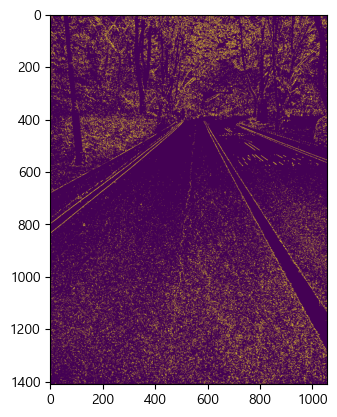

In [13]:
grad_combine = np.zeros_like(gradient_direction).astype(np.uint8)
grad_combine[((sobel_x > 1) & (gradient_magnitude > 1) & (gradient_direction > 1)) | ((sobel_x > 1) & (sobel_y > 1))] = 255
plt.imshow(grad_combine)

1411 1058


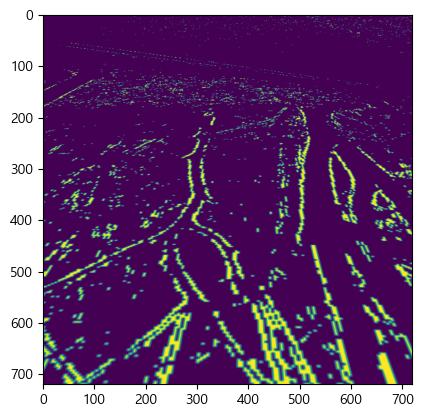

In [ ]:
src = np.float32([[250, 220],
                  [350, 220],
                  [500, 320],
                [100, 320]
                 ])
dst = np.float32([[0, 0],
              a   [width, 0],
                 [width, height],
                 [0, height]])
height, width = result.shape[:2]
print(height, width)

s_LTop2, s_RTop2 = [270, 40], [310, 40]
s_LBot2, s_RBot2 = [100, height], [450, height]

src = np.float32([s_LBot2, s_RBot2, s_RTop2, s_LTop2]) 
dst = np.float32([(250, 0), (510, 0), (510, 720), (250, 720)]) 

# Calculates a perspective transform from four pairs of the corresponding point
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)
warp_img = cv2.warpPerspective(result, M, (720, 720), flags=cv2.INTER_LINEAR)
plt.imshow(warp_img)

이미지 크기: 1411, 1058


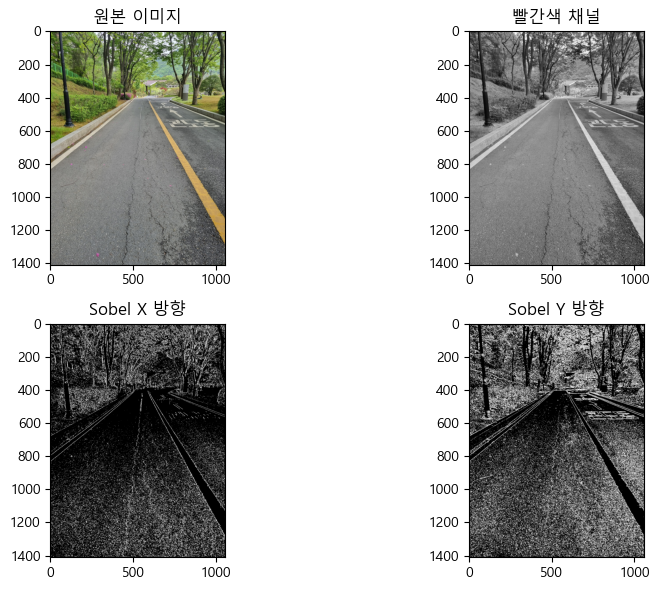

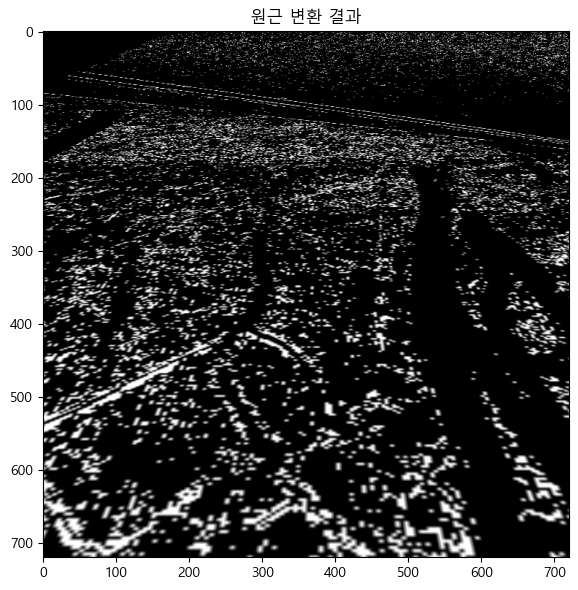


0: 640x480 3 cracks, 493.2ms
Speed: 6.6ms preprocess, 493.2ms inference, 15.4ms postprocess per image at shape (1, 3, 640, 480)


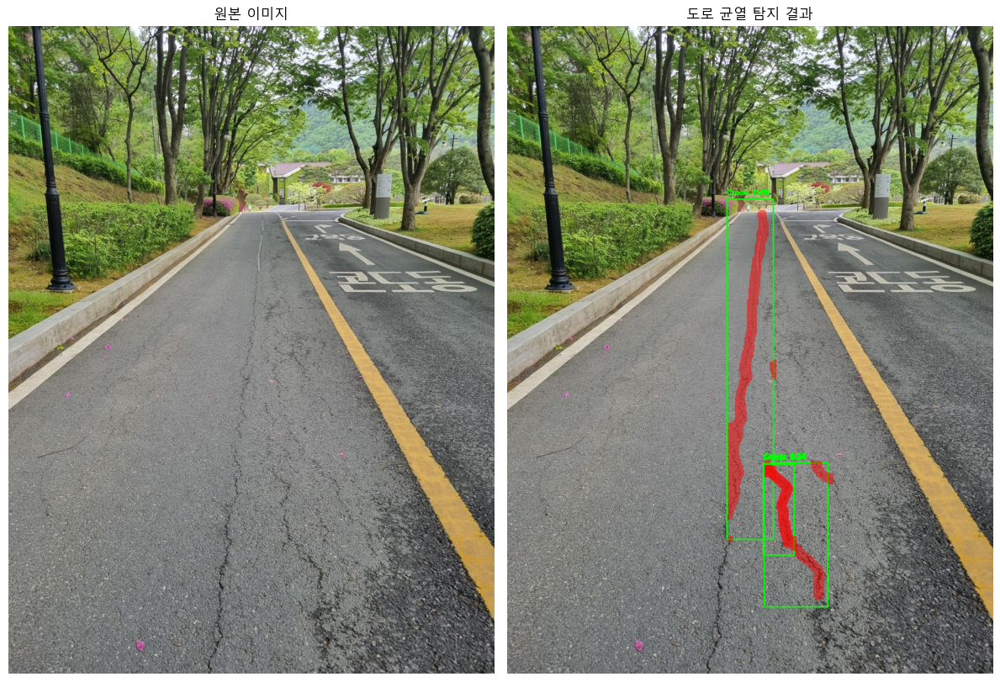

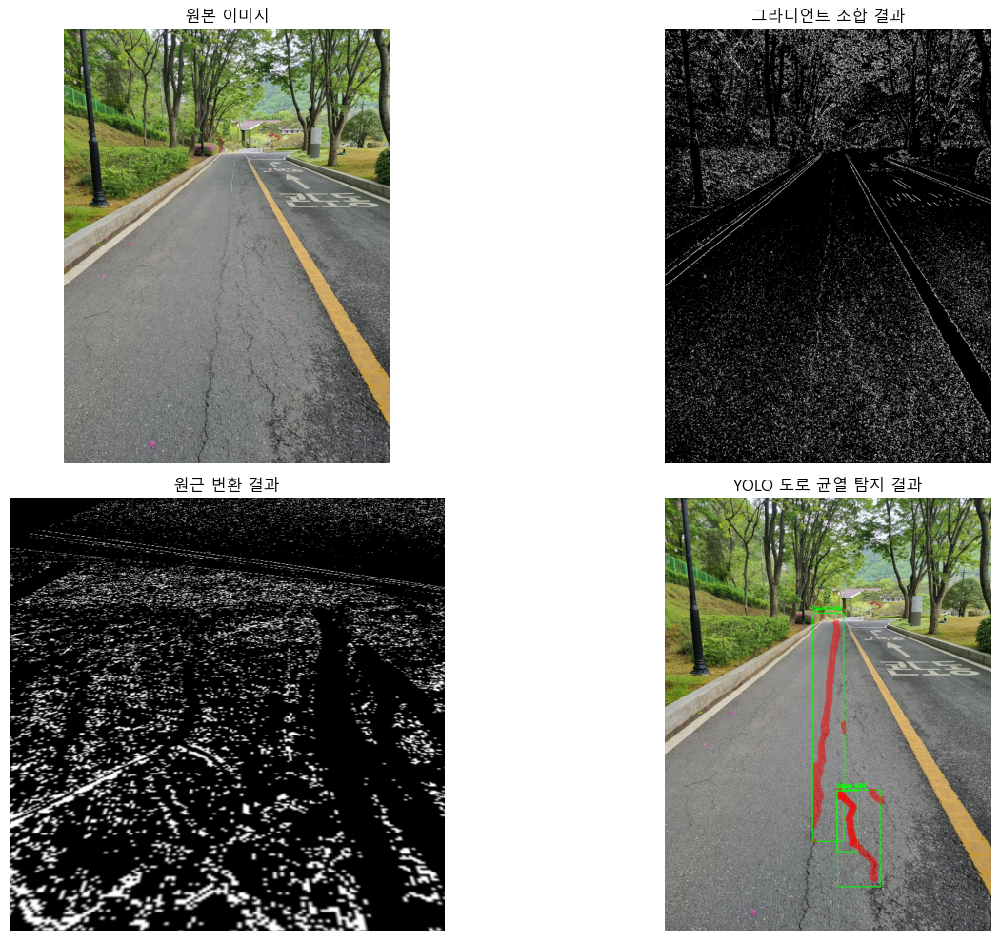

In [17]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage import exposure
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows용)
import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# YOLO 모델을 위한 라이브러리 임포트
from ultralytics import YOLO

# 원본 이미지 읽기
src = cv2.imread('./image/test_image_01.jpg')

# 이미지의 높이와 너비 추출
height, width = src.shape[:2]
print(f"이미지 크기: {height}, {width}")

# 이미지 표시
plt.figure(figsize=(10, 6))
plt.subplot(2, 2, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))

# 관심 영역을 원본 이미지 전체의 빨간색 채널로 설정
img = src[:, :, 2]  # 전체 이미지의 빨간색 채널 사용

plt.subplot(2, 2, 2)
plt.title('빨간색 채널')
plt.imshow(img, cmap='gray')

# Sobel X 방향 그라디언트 계산 및 이진화
abs_sobel_x = np.absolute(cv2.Sobel(img, cv2.CV_64F, 1, 0))
scaled_sobel_x = np.uint8(255*abs_sobel_x/np.max(abs_sobel_x))

th_sobelx = (35, 100)
sobel_x = np.zeros_like(scaled_sobel_x)
sobel_x[(scaled_sobel_x >= th_sobelx[0]) & (scaled_sobel_x <= th_sobelx[1])] = 255

plt.subplot(2, 2, 3)
plt.title('Sobel X 방향')
plt.imshow(sobel_x, cmap='gray')

# Sobel Y 방향 그라디언트 계산 및 이진화
abs_sobel_y = np.absolute(cv2.Sobel(img, cv2.CV_64F, 0, 1))
scaled_sobel_y = np.uint8(255*abs_sobel_y/np.max(abs_sobel_y))

th_sobely = (30, 255)
sobel_y = np.zeros_like(scaled_sobel_y)
sobel_y[(scaled_sobel_y >= th_sobely[0]) & (scaled_sobel_y <= th_sobely[1])] = 255

plt.subplot(2, 2, 4)
plt.title('Sobel Y 방향')
plt.imshow(sobel_y, cmap='gray')

plt.tight_layout()
plt.show()

# 그라디언트 크기 계산
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1)
gradient_magnitude = np.sqrt(sobelx**2 + sobely**2)
scale_factor = np.max(gradient_magnitude)/255 
gradient_magnitude = (gradient_magnitude/scale_factor).astype(np.uint8)

# 그라디언트 크기 이진화
th_mag = (30, 255)
mag_binary = np.zeros_like(gradient_magnitude)
mag_binary[(gradient_magnitude >= th_mag[0]) & (gradient_magnitude <= th_mag[1])] = 255

# 그라디언트 방향 계산
sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=15)
sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=15)

absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
gradient_direction = np.zeros_like(absgraddir)

th_dir = (0.7, 1.3)
gradient_direction[(absgraddir >= th_dir[0]) & (absgraddir <= th_dir[1])] = 255
gradient_direction = gradient_direction.astype(np.uint8)

# 그라디언트 조합
grad_combine = np.zeros_like(gradient_direction).astype(np.uint8)
grad_combine[((sobel_x > 1) & (mag_binary > 1) & (gradient_direction > 1)) | 
             ((sobel_x > 1) & (sobel_y > 1))] = 255

# 그라디언트 결과 저장
result = grad_combine.copy()

# 원근 변환 적용을 위한 코드
s_LTop2, s_RTop2 = [270, 40], [310, 40]
s_LBot2, s_RBot2 = [100, height], [450, height]

src_pts = np.float32([s_LBot2, s_RBot2, s_RTop2, s_LTop2]) 
dst_pts = np.float32([(250, 0), (510, 0), (510, 720), (250, 720)]) 

# 원근 변환 행렬 계산
M = cv2.getPerspectiveTransform(src_pts, dst_pts)
Minv = cv2.getPerspectiveTransform(dst_pts, src_pts)
warp_img = cv2.warpPerspective(result, M, (720, 720), flags=cv2.INTER_LINEAR)

plt.figure(figsize=(10, 6))
plt.title('원근 변환 결과')
plt.imshow(warp_img, cmap='gray')
plt.tight_layout()
plt.show()

# ====== YOLOv11-seg 모델을 사용한 도로 균열 탐지 코드 추가 ======

# YOLO 모델 로드
model_path = '../kdh/best.pt'
yolo_model = YOLO(model_path)

# 원본 이미지에 대해 추론 수행
results = yolo_model(src)

# 결과 시각화를 위한 이미지 복사
crack_detection_img = cv2.cvtColor(src, cv2.COLOR_BGR2RGB).copy()

# 결과 처리 및 시각화
for result in results:
    # 박스 정보
    boxes = result.boxes
    # 세그멘테이션 마스크 정보 (YOLOv11-seg의 경우)
    if hasattr(result, 'masks') and result.masks is not None:
        masks = result.masks
        
        # 결과 시각화
        plt.figure(figsize=(12, 8))
        
        # 원본 이미지 표시
        plt.subplot(1, 2, 1)
        plt.title('원본 이미지')
        plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        
        # 탐지 결과 표시
        plt.subplot(1, 2, 2)
        plt.title('도로 균열 탐지 결과')
        
        # 이미지에 박스 및 마스크 표시
        if len(boxes) > 0:
            # 박스 그리기
            for i, box in enumerate(boxes):
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                conf = float(box.conf[0])
                cls = int(box.cls[0])
                label = f"Crack: {conf:.2f}"
                
                # 박스 그리기
                cv2.rectangle(crack_detection_img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                # 레이블 그리기
                cv2.putText(crack_detection_img, label, (x1, y1 - 10), 
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
                
                # 마스크가 있는 경우 마스크 그리기
                if masks is not None and i < len(masks.data):
                    mask = masks.data[i].cpu().numpy()
                    if mask.shape[:2] != crack_detection_img.shape[:2]:
                        mask = cv2.resize(mask, (crack_detection_img.shape[1], crack_detection_img.shape[0]))
                    
                    # 마스크를 색상으로 오버레이
                    colored_mask = np.zeros_like(crack_detection_img)
                    colored_mask[mask > 0.5] = (255, 0, 0)  # 빨간색으로 마스크 표시
                    
                    # 투명도를 적용하여 이미지에 마스크 추가
                    alpha = 0.5
                    mask_region = (mask > 0.5).reshape(mask.shape[0], mask.shape[1], 1)
                    crack_detection_img = np.where(
                        mask_region, 
                        cv2.addWeighted(crack_detection_img, alpha, colored_mask, 1-alpha, 0), 
                        crack_detection_img
                    )
        
        plt.imshow(crack_detection_img)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()
        
        # 최종 결과 - 그라디언트 기반 처리 결과와 YOLO 탐지 결과 비교
        plt.figure(figsize=(15, 10))
        
        plt.subplot(2, 2, 1)
        plt.title('원본 이미지')
        plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        
        plt.subplot(2, 2, 2)
        plt.title('그라디언트 조합 결과')
        plt.imshow(grad_combine, cmap='gray')
        plt.axis('off')
        
        plt.subplot(2, 2, 3)
        plt.title('원근 변환 결과')
        plt.imshow(warp_img, cmap='gray')
        plt.axis('off')
        
        plt.subplot(2, 2, 4)
        plt.title('YOLO 도로 균열 탐지 결과')
        plt.imshow(crack_detection_img)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()
    else:
        # 마스크가 없는 경우 (YOLOv11 버전에 세그멘테이션이 없는 경우)
        plt.figure(figsize=(12, 8))
        
        # 원본 이미지 표시
        plt.subplot(1, 2, 1)
        plt.title('원본 이미지')
        plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        
        # 탐지 결과 표시
        plt.subplot(1, 2, 2)
        plt.title('도로 균열 탐지 결과 (바운딩 박스만)')
        
        # 이미지에 박스 표시
        if len(boxes) > 0:
            for box in boxes:
                x1, y1, x2, y2 = map(int, box.xyxy[0])
                conf = float(box.conf[0])
                cls = int(box.cls[0])
                label = f"Crack: {conf:.2f}"
                
                # 박스 그리기
                cv2.rectangle(crack_detection_img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                # 레이블 그리기
                cv2.putText(crack_detection_img, label, (x1, y1 - 10), 
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        plt.imshow(crack_detection_img)
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()

이미지 크기: 1411, 1058


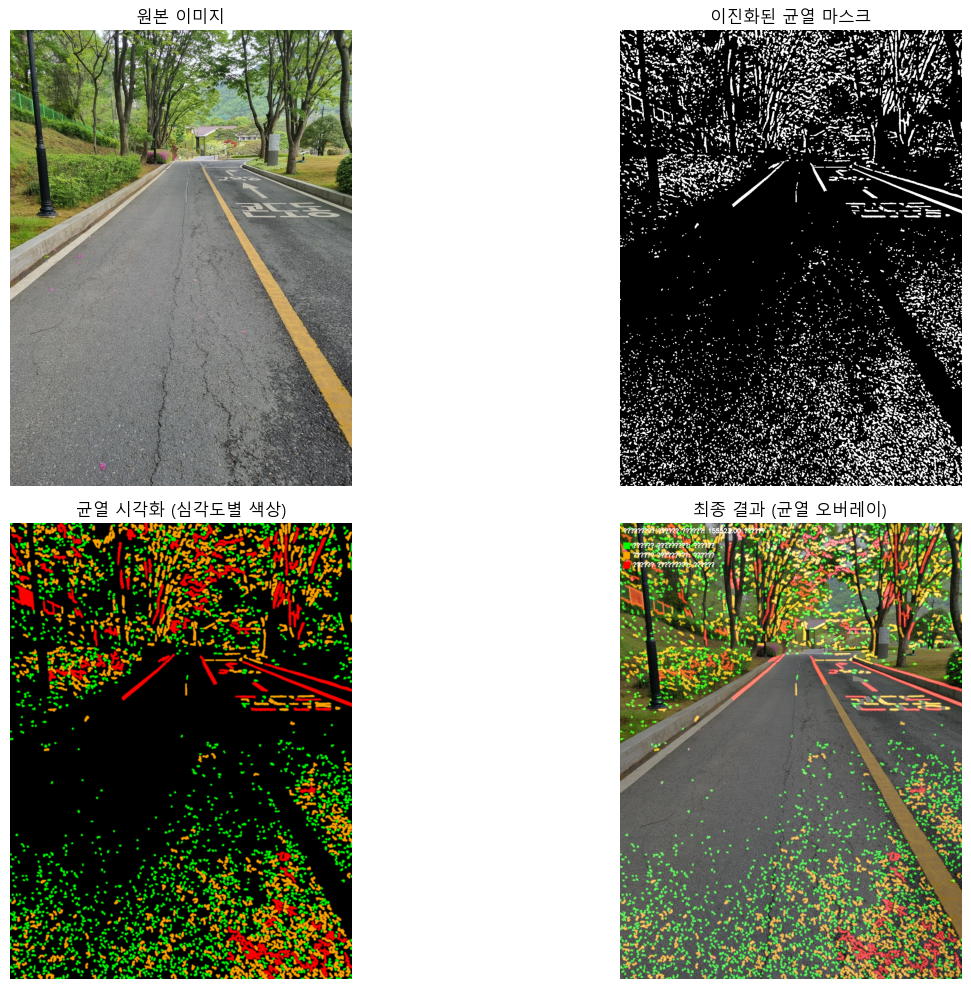


0: 640x480 3 cracks, 364.3ms
Speed: 4.3ms preprocess, 364.3ms inference, 5.0ms postprocess per image at shape (1, 3, 640, 480)


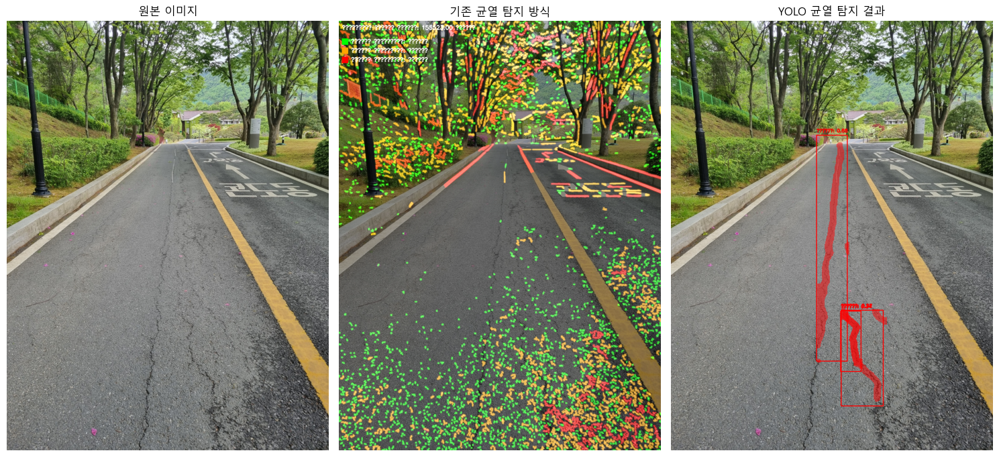

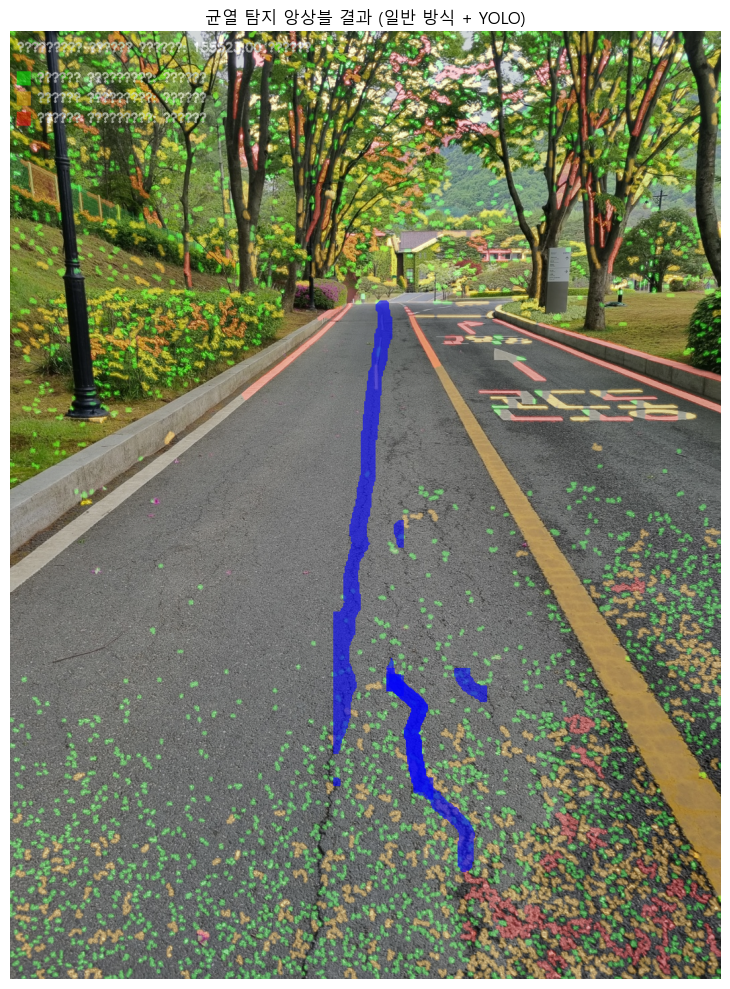

In [18]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows용)
import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# 이미지 읽기
src = cv2.imread('./image/test_image_01.jpg')

# 이미지의 높이와 너비 추출
height, width = src.shape[:2]
print(f"이미지 크기: {height}, {width}")

# 도로 균열 탐지 및 시각화 함수
def detect_and_visualize_cracks(image):
    """
    도로 균열 탐지 및 시각화 함수
    이미지에서 균열을 탐지하고 시각적으로 표현합니다.
    """
    # 원본 이미지 복사
    result_img = image.copy()
    
    # 그레이스케일 변환
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # CLAHE 적용 (대비 향상)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    equalized = clahe.apply(gray)
    
    # 가우시안 블러
    blurred = cv2.GaussianBlur(equalized, (5, 5), 0)
    
    # Top-hat 변환 (밝은 부분 강조)
    kernel = np.ones((9, 9), np.uint8)
    tophat = cv2.morphologyEx(blurred, cv2.MORPH_TOPHAT, kernel)
    
    # 이미지 이진화 (Otsu 알고리즘)
    _, binary = cv2.threshold(tophat, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # 노이즈 제거
    kernel = np.ones((3, 3), np.uint8)
    binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel)
    
    # 균열 마스크 생성 (시각화용)
    crack_mask = np.zeros_like(image)
    
    # 균열 윤곽선 찾기
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 균열 면적 계산 및 필터링
    min_area = 10  # 최소 균열 크기 (너무 작은 노이즈 제거)
    crack_area = 0
    
    # 색상 맵 생성 (균열 심각도에 따른 색상)
    severity_colors = {
        'low': (0, 255, 0),      # 녹색 (작은 균열)
        'medium': (0, 165, 255), # 주황색 (중간 균열)
        'high': (0, 0, 255)      # 빨간색 (큰 균열)
    }
    
    # 균열 윤곽선 그리기 및 색상화
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > min_area:
            crack_area += area
            
            # 균열 심각도 결정 (면적 기반)
            if area < 50:
                severity = 'low'
            elif area < 200:
                severity = 'medium'
            else:
                severity = 'high'
            
            # 균열 윤곽선 그리기 (두께 2 픽셀)
            cv2.drawContours(crack_mask, [contour], -1, severity_colors[severity], 2)
            
            # 균열 내부 채우기 (투명도 적용을 위해)
            cv2.drawContours(crack_mask, [contour], -1, severity_colors[severity], -1)
    
    # 균열 마스크에 블러 효과 적용 (부드러운 경계)
    crack_mask = cv2.GaussianBlur(crack_mask, (5, 5), 0)
    
    # 원본 이미지와 균열 마스크 합성 (알파 블렌딩)
    alpha = 0.7  # 원본 이미지 가중치
    beta = 0.6   # 균열 마스크 가중치
    gamma = 0    # 추가 밝기
    
    # 가중치 적용 합성
    result_img = cv2.addWeighted(result_img, alpha, crack_mask, beta, gamma)
    
    # 균열 정보 텍스트 추가
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result_img, f"탐지된 균열 영역: {crack_area:.2f} 픽셀", (10, 30), font, 0.6, (255, 255, 255), 2)
    
    # 균열 심각도 범례 추가
    legend_y = 60
    for severity, color in severity_colors.items():
        if severity == 'low':
            severity_text = "낮음"
        elif severity == 'medium':
            severity_text = "중간"
        else:
            severity_text = "높음"
            
        cv2.rectangle(result_img, (10, legend_y), (30, legend_y + 20), color, -1)
        cv2.putText(result_img, f"균열 심각도: {severity_text}", (40, legend_y + 15), font, 0.6, (255, 255, 255), 2)
        legend_y += 30
    
    # 이진화된 균열 마스크
    binary_colored = cv2.cvtColor(binary, cv2.COLOR_GRAY2BGR)
    
    return result_img, binary, crack_area, crack_mask

# 도로 균열 탐지 및 시각화
result_img, binary_mask, crack_area, crack_mask = detect_and_visualize_cracks(src)

# 결과 시각화
plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 2)
plt.title('이진화된 균열 마스크')
plt.imshow(binary_mask, cmap='gray')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.title('균열 시각화 (심각도별 색상)')
plt.imshow(cv2.cvtColor(crack_mask, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(2, 2, 4)
plt.title('최종 결과 (균열 오버레이)')
plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()

# YOLO 모델을 이용한 균열 탐지 통합 (기존 코드에서 추가)
try:
    from ultralytics import YOLO
    # YOLO 모델 로드
    model_path = '../kdh/best.pt'
    yolo_model = YOLO(model_path)
    
    # 이미지에 대한 추론 수행
    results = yolo_model(src)
    
    # YOLO 결과와 기존 방식 비교 시각화
    yolo_result_img = cv2.cvtColor(src, cv2.COLOR_BGR2RGB).copy()
    
    # 결과 처리 및 시각화
    for result in results:
        # 박스 정보
        boxes = result.boxes
        # 세그멘테이션 마스크 정보
        if hasattr(result, 'masks') and result.masks is not None:
            masks = result.masks
            
            # 마스크 시각화
            if len(boxes) > 0:
                for i, box in enumerate(boxes):
                    x1, y1, x2, y2 = map(int, box.xyxy[0])
                    conf = float(box.conf[0])
                    cls = int(box.cls[0])
                    label = f"균열: {conf:.2f}"
                    
                    # 박스 그리기
                    cv2.rectangle(yolo_result_img, (x1, y1), (x2, y2), (255, 0, 0), 2)
                    cv2.putText(yolo_result_img, label, (x1, y1 - 10), 
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)
                    
                    # 마스크 그리기
                    if masks is not None and i < len(masks.data):
                        mask = masks.data[i].cpu().numpy()
                        
                        # 마스크 리사이징
                        if mask.shape[:2] != (src.shape[0], src.shape[1]):
                            mask = cv2.resize(mask, (src.shape[1], src.shape[0]))
                        
                        # 마스크 채우기 (빨간색으로 균열 표시)
                        colored_mask = np.zeros_like(yolo_result_img)
                        colored_mask[mask > 0.5] = [255, 0, 0]  # 빨간색
                        
                        # 투명도를 적용하여 이미지에 마스크 추가
                        alpha = 0.5
                        mask_bool = (mask > 0.5)
                        if len(mask_bool.shape) == 2:
                            mask_bool = np.expand_dims(mask_bool, axis=2)
                        mask_bool = np.repeat(mask_bool, 3, axis=2)
                        yolo_result_img = np.where(
                            mask_bool, 
                            cv2.addWeighted(yolo_result_img, alpha, colored_mask, 1-alpha, 0), 
                            yolo_result_img
                        )
    
    # YOLO 결과와 기존 방식 비교
    plt.figure(figsize=(15, 8))
    
    plt.subplot(1, 3, 1)
    plt.title('원본 이미지')
    plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.title('기존 균열 탐지 방식')
    plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.title('YOLO 균열 탐지 결과')
    plt.imshow(yolo_result_img)
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # 두 방식 결합 (앙상블)
    combined_result = cv2.cvtColor(src, cv2.COLOR_BGR2RGB).copy()
    
    # 기존 방식 결과 적용 (50% 투명도)
    alpha1 = 0.5
    combined_result = cv2.addWeighted(combined_result, 1-alpha1, cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB), alpha1, 0)
    
    # YOLO 결과 적용 (마스크 부분만)
    for result in results:
        if hasattr(result, 'masks') and result.masks is not None:
            masks = result.masks
            
            if masks is not None:
                for i, mask_data in enumerate(masks.data):
                    mask = mask_data.cpu().numpy()
                    
                    # 마스크 리사이징
                    if mask.shape[:2] != (src.shape[0], src.shape[1]):
                        mask = cv2.resize(mask, (src.shape[1], src.shape[0]))
                    
                    # 마스크 채우기 (파란색으로 YOLO 균열 표시)
                    yolo_mask = np.zeros_like(combined_result)
                    yolo_mask[mask > 0.5] = [0, 0, 255]  # 파란색
                    
                    # 마스크 부분만 합성
                    alpha2 = 0.6
                    mask_bool = (mask > 0.5)
                    if len(mask_bool.shape) == 2:
                        mask_bool = np.expand_dims(mask_bool, axis=2)
                    mask_bool = np.repeat(mask_bool, 3, axis=2)
                    combined_result = np.where(
                        mask_bool, 
                        cv2.addWeighted(combined_result, 1-alpha2, yolo_mask, alpha2, 0), 
                        combined_result
                    )
    
    # 최종 결합 결과 표시
    plt.figure(figsize=(12, 10))
    plt.title('균열 탐지 앙상블 결과 (일반 방식 + YOLO)')
    plt.imshow(combined_result)
    plt.axis('off')
    plt.tight_layout()
    plt.show()
    
except ImportError:
    print("ultralytics 라이브러리가 설치되어 있지 않아 YOLO 모델을 사용할 수 없습니다.")
    print("필요한 경우 'pip install ultralytics'로 설치할 수 있습니다.")
except Exception as e:
    print(f"YOLO 모델 적용 중 오류 발생: {e}")


이미지 크기: (1411, 1058)


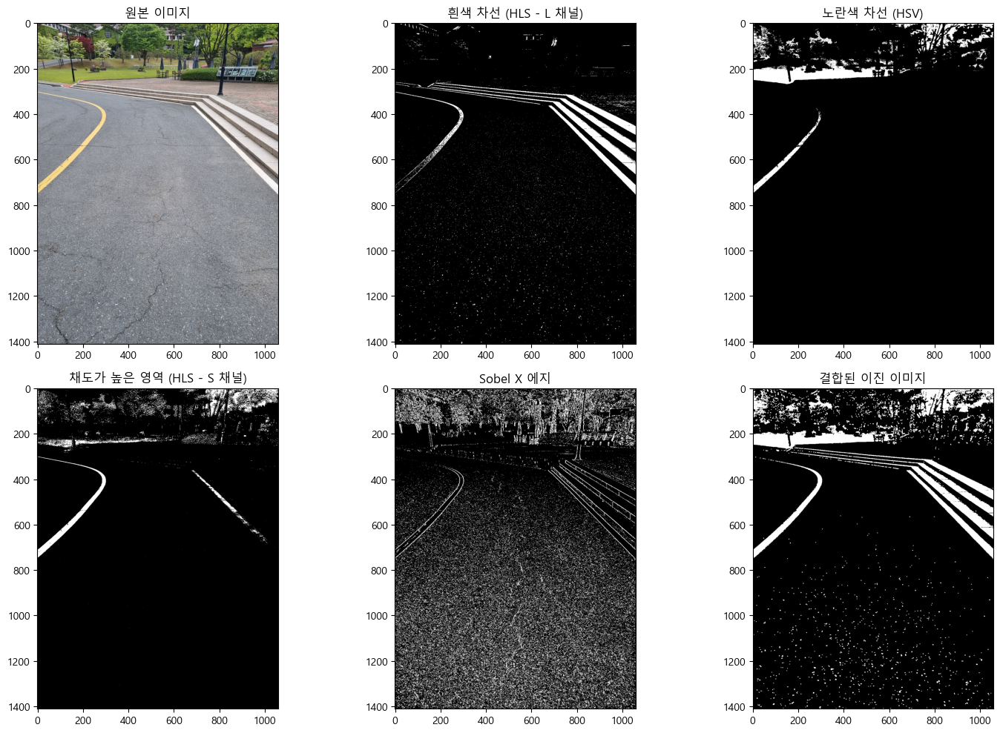

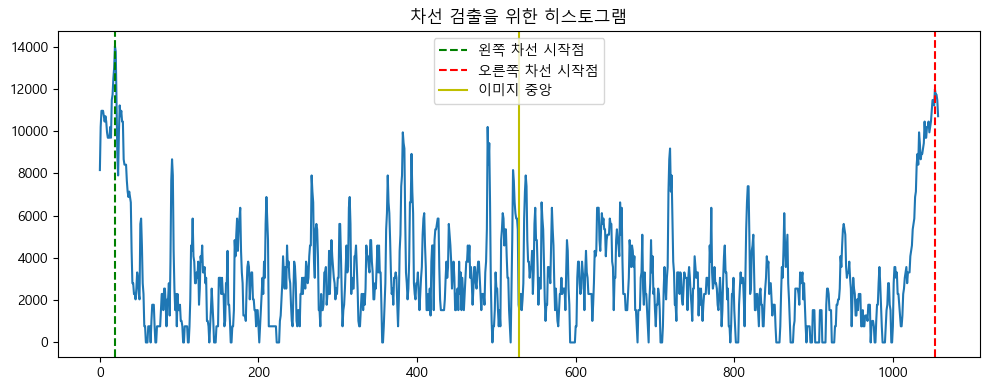

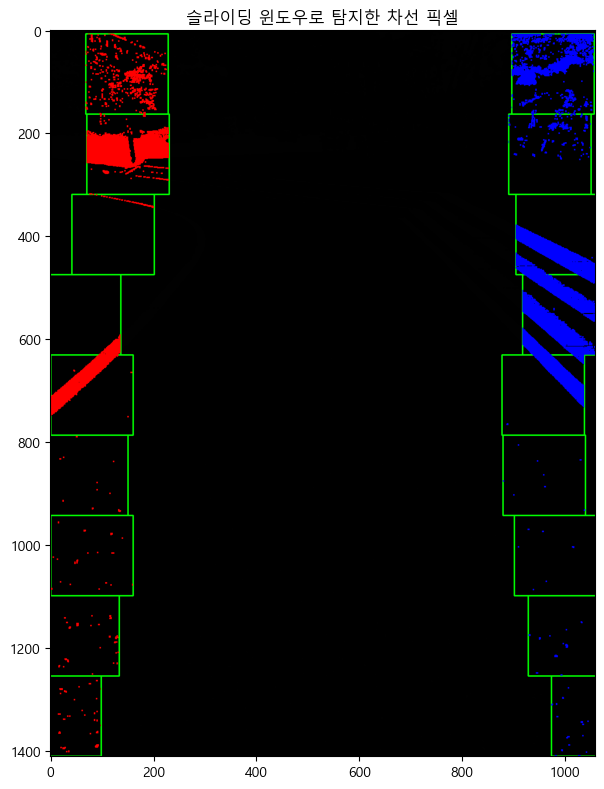

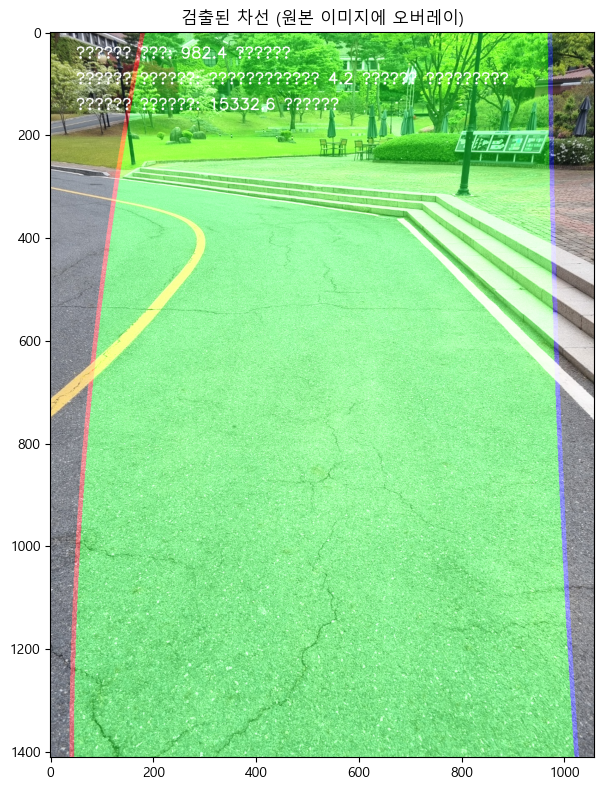

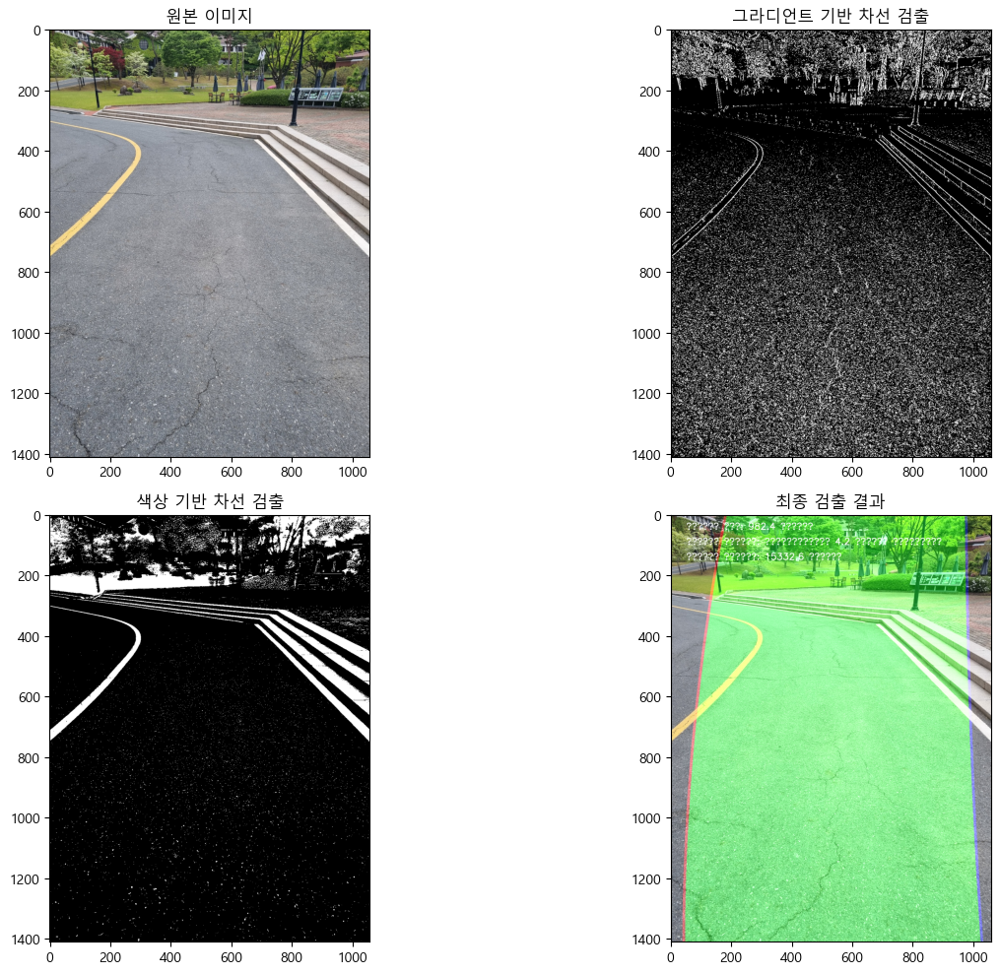

In [23]:
# 색상 기반 차선 검출 개선 코드
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage import exposure
import warnings
warnings.filterwarnings('ignore')

# 한글 폰트 설정 (Windows용)
import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

# 이미지 읽기
src = cv2.imread('./image/test_image_07.jpg')

# 이미지의 높이와 너비 추출
height, width = src.shape[:2]
print(f"이미지 크기: {src.shape[:2]}")

# 차선 색상 필터링 함수
def detect_lane_colors(image):
    """
    이미지에서 흰색과 노란색 차선을 검출하는 함수
    """
    # BGR에서 다양한 색상 공간으로 변환
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hls = cv2.cvtColor(image, cv2.COLOR_BGR2HLS)
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    
    # 1. 흰색 차선 검출 (HLS 색 공간)
    # L 채널에서 밝은 영역 검출
    l_channel = hls[:, :, 1]
    white_thresh = (200, 255)  # 밝기가 높은 부분만 선택
    white_binary = np.zeros_like(l_channel)
    white_binary[(l_channel >= white_thresh[0]) & (l_channel <= white_thresh[1])] = 255
    
    # 2. 노란색 차선 검출 (HSV 색 공간)
    # 노란색 범위 정의
    lower_yellow = np.array([20, 100, 100])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 3. 채도가 높은 영역 검출 (HLS의 S 채널)
    s_channel = hls[:, :, 2]
    s_thresh = (100, 255)
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 255
    
    # 4. 그라디언트 기반 에지 검출 (이전 코드와 동일)
    # 빨간색 채널에서 소벨 필터 적용
    r_channel = image[:, :, 2]
    
    # Sobel X
    sobelx = cv2.Sobel(r_channel, cv2.CV_64F, 1, 0, ksize=3)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    sobel_thresh = (30, 150)
    sobel_binary = np.zeros_like(scaled_sobelx)
    sobel_binary[(scaled_sobelx >= sobel_thresh[0]) & (scaled_sobelx <= sobel_thresh[1])] = 255
    
    # 5. 모든 특징 결합
    combined_binary = np.zeros_like(white_binary)
    combined_binary[(white_binary == 255) | (yellow_mask == 255) | (s_binary == 255) | (sobel_binary == 255)] = 255
    
    # 노이즈 제거
    kernel = np.ones((3, 3), np.uint8)
    combined_binary = cv2.morphologyEx(combined_binary, cv2.MORPH_OPEN, kernel)
    
    return white_binary, yellow_mask, s_binary, sobel_binary, combined_binary

# 색상 기반 차선 검출 적용
white_binary, yellow_mask, s_binary, sobel_binary, combined_binary = detect_lane_colors(src)

# 검출 결과 시각화
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))

plt.subplot(2, 3, 2)
plt.title('흰색 차선 (HLS - L 채널)')
plt.imshow(white_binary, cmap='gray')

plt.subplot(2, 3, 3)
plt.title('노란색 차선 (HSV)')
plt.imshow(yellow_mask, cmap='gray')

plt.subplot(2, 3, 4)
plt.title('채도가 높은 영역 (HLS - S 채널)')
plt.imshow(s_binary, cmap='gray')

plt.subplot(2, 3, 5)
plt.title('Sobel X 에지')
plt.imshow(sobel_binary, cmap='gray')

plt.subplot(2, 3, 6)
plt.title('결합된 이진 이미지')
plt.imshow(combined_binary, cmap='gray')

plt.tight_layout()
plt.show()

# 히스토그램 분석 및 차선 위치 찾기
histogram = np.sum(combined_binary[int(height/2):, :], axis=0)

# 이미지를 중앙에서 좌우로 나누어 좌/우 차선의 시작점 찾기
midpoint = np.int_(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# 히스토그램 시각화
plt.figure(figsize=(10, 4))
plt.plot(histogram)
plt.title('차선 검출을 위한 히스토그램')
plt.axvline(x=leftx_base, color='g', linestyle='--', label='왼쪽 차선 시작점')
plt.axvline(x=rightx_base, color='r', linestyle='--', label='오른쪽 차선 시작점')
plt.axvline(x=midpoint, color='y', linestyle='-', label='이미지 중앙')
plt.legend()
plt.tight_layout()
plt.show()

# 슬라이딩 윈도우로 차선 위치 추적
def find_lane_pixels(binary_img, nwindows=9, margin=80, minpix=40):
    """
    슬라이딩 윈도우 방식으로 차선 픽셀 찾기
    """
    # 이미지의 하단부에서 히스토그램 계산
    histogram = np.sum(binary_img[binary_img.shape[0]//2:, :], axis=0)
    
    # 히스토그램의 중앙값을 기준으로 좌/우 차선 시작점 찾기
    midpoint = np.int_(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # 윈도우 높이 설정
    window_height = np.int_(binary_img.shape[0]//nwindows)
    
    # 이미지에서 0이 아닌 픽셀의 인덱스 찾기
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # 현재 차선 위치
    leftx_current = leftx_base
    rightx_current = rightx_base
    
    # 차선 픽셀 인덱스를 저장할 빈 리스트
    left_lane_inds = []
    right_lane_inds = []
    
    # 결과 시각화를 위한 이미지
    out_img = np.dstack((binary_img, binary_img, binary_img))*255
    
    # 각 윈도우에 대해 처리
    for window in range(nwindows):
        # 윈도우 경계 설정
        win_y_low = binary_img.shape[0] - (window+1)*window_height
        win_y_high = binary_img.shape[0] - window*window_height
        
        # 좌/우 윈도우 x 범위
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # 윈도우 표시
        cv2.rectangle(out_img, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 2) 
        cv2.rectangle(out_img, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 2) 
        
        # 윈도우 내의 픽셀 찾기
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                           (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        
        # 인덱스 추가
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # 다음 윈도우 중심 업데이트
        if len(good_left_inds) > minpix:
            leftx_current = np.int_(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int_(np.mean(nonzerox[good_right_inds]))
    
    # 인덱스 합치기
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # 인덱스가 비어있는 경우
        pass
    
    # 차선 픽셀 추출
    leftx = nonzerox[left_lane_inds] if len(left_lane_inds) > 0 else []
    lefty = nonzeroy[left_lane_inds] if len(left_lane_inds) > 0 else []
    rightx = nonzerox[right_lane_inds] if len(right_lane_inds) > 0 else []
    righty = nonzeroy[right_lane_inds] if len(right_lane_inds) > 0 else []
    
    # 차선 픽셀 시각화
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]  # 오른쪽 차선: 파란색
    
    return leftx, lefty, rightx, righty, out_img

# 차선 위치 추적
leftx, lefty, rightx, righty, out_img = find_lane_pixels(combined_binary)

# 슬라이딩 윈도우 결과 시각화
plt.figure(figsize=(12, 8))
plt.title('슬라이딩 윈도우로 탐지한 차선 픽셀')
plt.imshow(out_img)
plt.tight_layout()
plt.show()

# 차선 피팅 및 시각화
def fit_polynomial(binary_img, leftx, lefty, rightx, righty):
    """
    차선 피팅 및 시각화
    """
    # 2차 다항식으로 차선 피팅
    if len(leftx) > 0 and len(rightx) > 0:
        left_fit = np.polyfit(lefty, leftx, 2)
        right_fit = np.polyfit(righty, rightx, 2)
        
        # y 좌표 생성 (이미지 하단부터 상단까지)
        ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
        
        try:
            # 좌/우 차선 x 좌표 계산
            left_fitx = left_fit[0]*(ploty**2) + left_fit[1]*ploty + left_fit[2]
            right_fitx = right_fit[0]*(ploty**2) + right_fit[1]*ploty + right_fit[2]
        except TypeError:
            # 피팅 실패 시
            left_fitx = 1*ploty**2 + 1*ploty
            right_fitx = 1*ploty**2 + 1*ploty
        
        return left_fitx, right_fitx, ploty, left_fit, right_fit
    else:
        return [], [], [], None, None

# 차선 피팅
left_fitx, right_fitx, ploty, left_fit, right_fit = fit_polynomial(combined_binary, leftx, lefty, rightx, righty)

# 원본 이미지에 차선 표시
def draw_lane_area(original_img, binary_img, left_fitx, right_fitx, ploty):
    """
    원본 이미지에 차선 영역 그리기
    """
    # 원본 이미지 복사
    result_img = cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB).copy()
    
    # 차선 영역 표시를 위한 빈 이미지
    color_warp = np.zeros_like(result_img).astype(np.uint8)
    
    # 좌/우 차선 포인트를 합쳐서 다각형 생성
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # 차선 영역 채우기
    cv2.fillPoly(color_warp, np.int_([pts]), (0, 255, 0))
    
    # 좌/우 차선 그리기
    for i in range(len(ploty)-1):
        if (0 <= left_fitx[i] < result_img.shape[1] and
            0 <= left_fitx[i+1] < result_img.shape[1]):
            # 왼쪽 차선: 빨간색
            cv2.line(color_warp, 
                     (int(left_fitx[i]), int(ploty[i])), 
                     (int(left_fitx[i+1]), int(ploty[i+1])), 
                     (255, 0, 0), 8)
        
        if (0 <= right_fitx[i] < result_img.shape[1] and
            0 <= right_fitx[i+1] < result_img.shape[1]):
            # 오른쪽 차선: 파란색
            cv2.line(color_warp, 
                     (int(right_fitx[i]), int(ploty[i])), 
                     (int(right_fitx[i+1]), int(ploty[i+1])), 
                     (0, 0, 255), 8)
    
    # 원본 이미지에 차선 오버레이
    alpha = 0.4  # 투명도
    result_img = cv2.addWeighted(result_img, 1, color_warp, alpha, 0)
    
    return result_img

# 차선 정보 계산
def calculate_lane_info(left_fit, right_fit, left_fitx, right_fitx, img_shape):
    """
    차선 곡률과 차량 위치 계산
    """
    # 이미지 하단에서의 차선 위치
    bottom_y = img_shape[0] - 1
    
    # 좌/우 차선의 위치
    left_x_bottom = left_fit[0]*(bottom_y**2) + left_fit[1]*bottom_y + left_fit[2]
    right_x_bottom = right_fit[0]*(bottom_y**2) + right_fit[1]*bottom_y + right_fit[2]
    
    # 차선 간 거리
    lane_width = right_x_bottom - left_x_bottom
    
    # 이미지 중앙
    img_center = img_shape[1] / 2
    
    # 차선 중앙
    lane_center = (right_x_bottom + left_x_bottom) / 2
    
    # 차량 위치 (오프셋)
    center_offset = img_center - lane_center
    
    # 곡률 계산 (픽셀 단위)
    y_eval = bottom_y
    left_curverad = ((1 + (2*left_fit[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])
    
    # 평균 곡률
    avg_curverad = (left_curverad + right_curverad) / 2
    
    return lane_width, center_offset, left_curverad, right_curverad, avg_curverad

# 결과 시각화
if len(left_fitx) > 0 and len(right_fitx) > 0:
    # 차선 표시
    result_img = draw_lane_area(src, combined_binary, left_fitx, right_fitx, ploty)
    
    # 차선 정보 계산
    lane_width, center_offset, left_curve, right_curve, avg_curve = calculate_lane_info(
        left_fit, right_fit, left_fitx, right_fitx, combined_binary.shape)
    
    # 정보 텍스트 추가
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(result_img, f'차선 폭: {lane_width:.1f} 픽셀', (50, 50), font, 1, (255, 255, 255), 2)
    direction = "왼쪽" if center_offset > 0 else "오른쪽"
    cv2.putText(result_img, f'차량 위치: 중앙에서 {abs(center_offset):.1f} 픽셀 {direction}', (50, 100), font, 1, (255, 255, 255), 2)
    cv2.putText(result_img, f'곡률 반경: {avg_curve:.1f} 픽셀', (50, 150), font, 1, (255, 255, 255), 2)
    
    # 최종 결과 시각화
    plt.figure(figsize=(12, 8))
    plt.title('검출된 차선 (원본 이미지에 오버레이)')
    plt.imshow(result_img)
    plt.tight_layout()
    plt.show()
    
    # 색상 기반 검출 효과 비교
    plt.figure(figsize=(15, 10))
    
    plt.subplot(2, 2, 1)
    plt.title('원본 이미지')
    plt.imshow(cv2.cvtColor(src, cv2.COLOR_BGR2RGB))
    
    plt.subplot(2, 2, 2)
    plt.title('그라디언트 기반 차선 검출')
    plt.imshow(sobel_binary, cmap='gray')
    
    plt.subplot(2, 2, 3)
    plt.title('색상 기반 차선 검출')
    color_binary = np.zeros_like(combined_binary)
    color_binary[(white_binary == 255) | (yellow_mask == 255) | (s_binary == 255)] = 255
    plt.imshow(color_binary, cmap='gray')
    
    plt.subplot(2, 2, 4)
    plt.title('최종 검출 결과')
    plt.imshow(result_img)
    
    plt.tight_layout()
    plt.show()
else:
    print("차선을 탐지할 수 없습니다. 더 나은 이미지 처리가 필요합니다.")

In [25]:
import json
import numpy as np
import cv2
import matplotlib as mpl
import matplotlib.pyplot as plt
from pathlib import Path
import os
from PIL import Image, ImageDraw, ImageFont
import torch
from ultralytics import YOLO

# 한글 깨짐 방지 (Windows용)
mpl.rcParams['font.family'] = 'Malgun Gothic'
mpl.rcParams['axes.unicode_minus'] = False

def load_yolo_segmentation_model(model_path):
    """
    YOLOv11-seg 모델을 로드합니다.
    
    Args:
        model_path: 학습된 모델 파일 경로
        
    Returns:
        로드된 YOLO 모델
    """
    # YOLO 모델 로드
    try:
        model = YOLO(model_path)
        print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
        return model
    except Exception as e:
        print(f"모델 로드 중 오류 발생: {e}")
        raise

def segment_cracks_with_yolo(model, image):
    """
    YOLOv11-seg 모델을 사용하여 이미지에서 도로 균열을 세그멘테이션합니다.
    
    Args:
        model: 로드된 YOLO 모델
        image: BGR 형식의 입력 이미지
        
    Returns:
        crack_mask: 균열 마스크 (이진 이미지)
        pothole_mask: 포트홀 마스크 (이진 이미지)
    """
    height, width = image.shape[:2]
    
    # 이미지에 모델 추론 실행
    results = model(image, verbose=False)
    
    # 세그멘테이션 마스크를 저장할 빈 이미지 생성
    crack_mask = np.zeros((height, width), dtype=np.uint8)
    pothole_mask = np.zeros((height, width), dtype=np.uint8)
    
    # 첫 번째 결과만 처리 (일반적으로 YOLO는 배치로 결과 반환)
    result = results[0]
    
    # 세그멘테이션 마스크가 있는지 확인
    if hasattr(result, 'masks') and result.masks is not None:
        # 각 마스크 및 클래스 ID 처리
        for i, mask_data in enumerate(result.masks.data):
            # 클래스 ID 가져오기 (0: 도로균열, 1: 포트홀)
            # 주의: 모델의 클래스 인덱스는 다를 수 있으므로 필요에 따라 조정
            class_id = int(result.boxes.cls[i].item())
            
            # 마스크 데이터를 이미지 형식으로 변환
            mask = mask_data.cpu().numpy()
            
            # 원본 이미지 크기와 마스크 크기가 다른 경우 리사이즈
            if mask.shape != (height, width):
                mask_img = cv2.resize(mask, (width, height), interpolation=cv2.INTER_NEAREST)
            else:
                mask_img = mask
            
            # 0과 1로 된 마스크를 0과 255로 변환
            mask_img = (mask_img > 0.5).astype(np.uint8) * 255
            
            # 클래스 ID에 따라 해당 마스크에 추가
            if class_id == 0:  # 도로 균열
                crack_mask = cv2.bitwise_or(crack_mask, mask_img)
            elif class_id == 1:  # 포트홀
                pothole_mask = cv2.bitwise_or(pothole_mask, mask_img)
    
    return crack_mask, pothole_mask

def detect_lane_lines_adaptive(image, yellow_sensitivity=0.7, white_percentile=98):
    """
    이미지에서 노란색과 흰색 차선을 감지합니다.
    흰색 차선은 이미지에서 가장 밝은 픽셀의 백분위수를 기반으로 감지합니다.
    
    Args:
        image: BGR 형식의 입력 이미지
        yellow_sensitivity: 노란색 차선 감지 민감도 (1.0이 기본값)
        white_percentile: 상위 몇 퍼센트의 밝기를 흰색 차선으로 인식할지 결정 (95 = 상위 5%)
        
    Returns:
        lane_mask: 차선 마스크 (이진 이미지)
    """
    # BGR에서 HSV로 변환
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # 노란색 차선 감지 (기존 코드와 동일)
    base_yellow_range = np.array([20, 100, 100])  # 기본 하한값
    yellow_range = int(20 * yellow_sensitivity)  # 민감도에 따른 색상 범위
    lower_yellow = np.array([max(0, base_yellow_range[0] - yellow_range), 
                             max(0, base_yellow_range[1] - int(50 * yellow_sensitivity)), 
                             max(0, base_yellow_range[2] - int(50 * yellow_sensitivity))])
    upper_yellow = np.array([min(180, 40 + yellow_range), 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 흰색 차선 감지 - 적응형 임계값 사용
    # 1. 명도(V) 채널 추출
    v_channel = hsv[:,:,2]
    
    # 2. 유효 영역의 상위 밝기 임계값 계산 (도로 부분만 고려하기 위해 하단 영역 사용)
    height, width = image.shape[:2]
    lower_half = v_channel[height//2:, :]  # 이미지 하단 절반만 사용
    
    # 3. 상위 백분위수에 해당하는 명도값을 계산
    v_threshold = int(np.percentile(lower_half, white_percentile))  # int로 변환하여 정수로 만듦
    
    # 4. 채도가 낮고 명도가 임계값 이상인 픽셀을 흰색 차선으로 감지
    # 채도 임계값은 고정하거나 명도에 비례하게 설정 가능
    s_threshold = 40  # 채도가 낮은 흰색만 감지 (조정 가능)
    
    # 모든 값을 정수로 확실히 처리 (동일한 데이터 타입 보장)
    lower_white = np.array([0, 0, v_threshold], dtype=np.uint8)  # dtype 명시
    upper_white = np.array([180, s_threshold, 255], dtype=np.uint8)  # dtype 명시
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    # 노란색과 흰색 마스크 결합
    lane_mask = cv2.bitwise_or(yellow_mask, white_mask)
    
    # 노이즈 제거 및 간격 채우기
    kernel = np.ones((5, 5), np.uint8)
    lane_mask = cv2.morphologyEx(lane_mask, cv2.MORPH_CLOSE, kernel)
    lane_mask = cv2.morphologyEx(lane_mask, cv2.MORPH_DILATE, kernel)
    
    return lane_mask, v_threshold

def calculate_distance_transform_width(crack_mask, road_mask, valid_roi_mask):
    """
    거리 변환(Distance Transform)을 이용하여 균열의 너비를 추정합니다.
    각 균열 픽셀에서 배경까지의 거리를 계산하여 균열의 두께를 근사화합니다.
    유효 영역 내에서만 처리합니다.
    """
    # 유효 영역 내에서 균열과 도로가 겹치는 부분만 처리
    valid_mask = (crack_mask > 0) & (road_mask > 0) & (valid_roi_mask > 0)
    
    if np.sum(valid_mask) == 0:
        return crack_mask  # 균열이 없으면 그대로 반환
    
    # 균열 마스크의 반전 (배경이 1, 균열이 0)
    inverted_mask = 1 - (crack_mask > 0).astype(np.uint8)
    
    # 거리 변환 수행
    dist_transform = cv2.distanceTransform(inverted_mask, cv2.DIST_L2, 3)
    
    # 거리 임계값 (균열 두께의 절반으로 설정)
    threshold = 3  # 균열 두께를 약 6픽셀로 가정 (조정 가능)
    
    # 임계값 이하의 픽셀을 균열로 간주
    thick_cracks = (dist_transform < threshold).astype(np.uint8) * 255
    
    # 도로 영역 내의 균열과 유효 영역 내의 균열만 유지
    thick_cracks = thick_cracks & road_mask & valid_roi_mask
    
    return thick_cracks

def detect_road_boundary_points(image, road_mask, valid_roi_mask):
    """
    이미지와 도로 마스크에서 원근 변환을 위한 경계 포인트를 자동으로 감지합니다.
    
    Args:
        image: 원본 이미지
        road_mask: 도로 영역 마스크 (이진 이미지)
        valid_roi_mask: 유효 분석 영역 마스크 (이진 이미지)
        
    Returns:
        src_points: 원본 이미지 상의 도로 경계 포인트
        dst_points: 원근 변환 후의 목표 포인트
    """
    height, width = image.shape[:2]
    
    # 유효 분석 영역 내에서만 처리
    masked_road = cv2.bitwise_and(road_mask, valid_roi_mask)
    
    # 도로 윤곽선 찾기
    contours, _ = cv2.findContours(masked_road, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 윤곽선이 없는 경우 기본값 반환
    if not contours:
        # 기본 경계 포인트 (수동 설정)
        valid_max_y = np.max(np.where(valid_roi_mask > 0)[0])
        src_points = np.float32([
            [width * 0, valid_max_y * 0.9],  # 왼쪽 아래
            [width * 1, valid_max_y * 0.9],  # 오른쪽 아래
            [width * 0.25, valid_max_y * 0],  # 왼쪽 위
            [width * 0.5, valid_max_y * 0]   # 오른쪽 위
        ])
    else:
        # 가장 큰 윤곽선 선택
        largest_contour = max(contours, key=cv2.contourArea)
        
        # 윤곽선 근사화 (더 단순한 형태로)
        epsilon = 0.02 * cv2.arcLength(largest_contour, True)
        approx = cv2.approxPolyDP(largest_contour, epsilon, True)
        
        # 바운딩 박스 검출
        x, y, w, h = cv2.boundingRect(largest_contour)
        
        # 이미지 하단에서의 도로 왼쪽/오른쪽 경계점 찾기
        bottom_points = []
        top_points = []
        
        # 높이를 3등분하여 상단과 하단 영역 정의
        bottom_y_threshold = y + h * 0.7
        top_y_threshold = y + h * 0.3
        
        # 모든 윤곽점 순회
        for point in largest_contour:
            px, py = point[0]
            
            # 하단 영역의 점
            if py >= bottom_y_threshold:
                bottom_points.append((px, py))
            # 상단 영역의 점
            elif py <= top_y_threshold:
                top_points.append((px, py))
        
        # 점이 충분하지 않은 경우 기본값 사용
        if len(bottom_points) < 2 or len(top_points) < 2:
            valid_max_y = np.max(np.where(valid_roi_mask > 0)[0])
            src_points = np.float32([
                [width * 0, valid_max_y * 0.9],  # 왼쪽 아래
                [width * 1, valid_max_y * 0.9],  # 오른쪽 아래
                [width * 0.25, valid_max_y * 0],  # 왼쪽 위
                [width * 0.5, valid_max_y * 0]   # 오른쪽 위
            ])
        else:
            # 하단 좌/우 경계점 (x좌표 기준으로 정렬)
            bottom_points.sort(key=lambda p: p[0])
            bottom_left = bottom_points[0]
            bottom_right = bottom_points[-1]
            
            # 상단 좌/우 경계점 (x좌표 기준으로 정렬)
            top_points.sort(key=lambda p: p[0])
            top_left = top_points[0]
            top_right = top_points[-1]
            
            # 최종 소스 포인트
            src_points = np.float32([
                bottom_left,
                bottom_right,
                top_left,
                top_right
            ])
    
    # 변환 후 목표 포인트
    dst_points = np.float32([
        [0, height],           # 왼쪽 아래
        [width, height],       # 오른쪽 아래
        [0, 0],                # 왼쪽 위
        [width, 0]             # 오른쪽 위
    ])
    
    # 포인트 확인 및 시각화 (디버깅용)
    debug_img = image.copy()
    for i, (x, y) in enumerate(src_points):
        cv2.circle(debug_img, (int(x), int(y)), 5, (0, 0, 255), -1)
        debug_img = add_korean_text(debug_img, f"P{i}", (int(x)+10, int(y)), font_size=16, font_color=(0, 0, 255))
    
    cv2.imwrite("debug_boundary_points.jpg", debug_img)
    
    return src_points, dst_points

def apply_perspective_correction(image, road_mask, crack_mask, valid_roi_mask, respect_lane_lines=True):
    """
    원근 보정을 적용합니다.
    카메라 각도나 위치에 따른 왜곡을 보정하여 실제 비율을 더 정확하게 계산합니다.
    """
    height, width = image.shape[:2]
    
    # 도로 경계 포인트 자동 감지
    src_points, dst_points = detect_road_boundary_points(
        image, road_mask, valid_roi_mask
    )
    
    # 호모그래피 행렬 계산
    H = cv2.getPerspectiveTransform(src_points, dst_points)
    
    # 원근 보정 적용
    corrected_image = cv2.warpPerspective(image, H, (width, height))
    corrected_road_mask = cv2.warpPerspective(road_mask, H, (width, height))
    corrected_crack_mask = cv2.warpPerspective(crack_mask, H, (width, height))
    corrected_valid_roi_mask = cv2.warpPerspective(valid_roi_mask, H, (width, height))
    
    return corrected_image, corrected_road_mask, corrected_crack_mask, corrected_valid_roi_mask, H

def save_visualization_with_matplotlib(viz_results, output_path, respect_lane_lines=True):
    """
    시각화 결과를 Matplotlib을 사용하여 저장합니다.
    한글 텍스트 표시 문제를 방지합니다.
    """
    # 이미지 개수 계산
    n_images = len(viz_results['step_results'])
    n_cols = 2
    n_rows = (n_images + 1) // 2
    
    # 그림 크기 설정
    plt.figure(figsize=(20, 5*n_rows + 1))
    
    # 제목 추가
    plt.suptitle("도로 영역 감지 과정", fontsize=20)
    plt.title(f"차선 경계 적용: {'예' if respect_lane_lines else '아니오'}", fontsize=14)
    
    # 그리드 설정
    gs = plt.GridSpec(n_rows, n_cols, figure=plt.gcf())
    
    # 각 단계별 이미지 추가
    for i, step in enumerate(viz_results['step_results']):
        row, col = i // n_cols, i % n_cols
        ax = plt.subplot(gs[row, col])
        
        # RGB로 변환 (OpenCV는 BGR)
        if len(step['image'].shape) == 3:
            img = cv2.cvtColor(step['image'], cv2.COLOR_BGR2RGB)
        else:
            img = step['image']
            
        ax.imshow(img)
        ax.set_title(f"{step['name']}\n{step['description']}")
        ax.axis('off')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # 제목 공간 확보
    plt.savefig(output_path, dpi=150)
    plt.close()

def add_korean_text(img, text, position, font_size=20, font_color=(0, 0, 0)):
    """
    PIL을 사용하여 이미지에 한글 텍스트를 추가합니다.
    
    Args:
        img: OpenCV 이미지 (BGR)
        text: 추가할 한글 텍스트
        position: (x, y) 좌표
        font_size: 폰트 크기
        font_color: 폰트 색상 (RGB)
        
    Returns:
        한글 텍스트가 추가된 이미지
    """
    # OpenCV 이미지(BGR)를 PIL 이미지(RGB)로 변환
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    pil_img = Image.fromarray(img_rgb)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 로드 (Windows 기준 - 맑은 고딕)
    try:
        font = ImageFont.truetype("malgun.ttf", font_size)
    except:
        try:
            # Windows 시스템 폰트 경로 시도
            font = ImageFont.truetype("C:/Windows/Fonts/malgun.ttf", font_size)
        except:
            # 시스템에 해당 폰트가 없을 경우 기본 폰트 사용
            font = ImageFont.load_default()
    
    # 텍스트 추가
    draw.text(position, text, font=font, fill=font_color)
    
    # PIL 이미지를 다시 OpenCV 이미지로 변환
    result_img = cv2.cvtColor(np.array(pil_img), cv2.COLOR_RGB2BGR)
    
    return result_img

# 기존 함수에서 하단부 제외 코드 수정
def create_valid_roi_mask(image):
    """
    유효한 분석 영역 마스크를 생성합니다 (전체 이미지 사용).
    """
    height, width = image.shape[:2]
    
    # 전체 이미지를 유효 영역으로 설정
    valid_roi_mask = np.ones((height, width), dtype=np.uint8) * 255
    
    return valid_roi_mask

def detect_largest_region_with_visualization(image, respect_lane_lines=True, show_steps=True):
    """
    이미지에서 가장 큰 연결 영역을 찾아 도로 영역으로 간주합니다.
    노란색/흰색 차선을 경계로 사용할 수 있습니다.
    각 단계별 결과를 시각화합니다.
    
    Args:
        image: 입력 이미지
        respect_lane_lines: 차선을 도로 경계로 사용할지 여부
        show_steps: 중간 단계 결과를 시각화할지 여부
        
    Returns:
        도로 마스크 (이진 이미지)
        시각화 결과 (각 단계별 이미지 딕셔너리)
    """
    height, width = image.shape[:2]
    
    # 시각화를 위한 결과 이미지 저장 딕셔너리
    viz_results = {
        'original': image.copy(),
        'step_results': []
    }
    
    # 전체 이미지를 분석 대상으로 설정
    roi = image.copy()
    
    # 단계 1: ROI 영역 표시
    roi_visualization = image.copy()
    viz_results['step_results'].append({
        'name': '1. 유효 분석 영역(ROI)',
        'image': roi_visualization,
        'description': '전체 이미지가 분석 대상'
    })
    
    # 노란색/흰색 차선 감지 (옵션)
    lane_mask = None
    inverted_lane_mask = None  # 변수 초기화 추가
    v_threshold = None
    
    if respect_lane_lines:
        lane_mask, v_threshold = detect_lane_lines_adaptive(roi)  # 적응형 함수 사용
        
        # 차선 감지 결과 시각화
        lane_viz = roi.copy()
        lane_viz[lane_mask > 0] = [0, 255, 0]  # 차선은 초록색으로 표시
        viz_results['step_results'].append({
            'name': '2. 차선 감지 결과',
            'image': lane_viz,
            'description': f'노란색 및 흰색 차선이 감지됨 (명도 임계값: {v_threshold})'
        })
        
        # 차선을 도로 분할의 경계로 사용하기 위해 반전된 마스크 생성
        inverted_lane_mask = cv2.bitwise_not(lane_mask)
        
        # 반전된 차선 마스크 시각화
        inverted_lane_viz = np.zeros_like(roi)
        inverted_lane_viz[inverted_lane_mask > 0] = [255, 255, 255]  # 흰색
        viz_results['step_results'].append({
            'name': '3. 반전된 차선 마스크',
            'image': inverted_lane_viz,
            'description': '차선이 검은색, 나머지 영역이 흰색'
        })
        
        # 명도 임계값 시각화 추가
        if v_threshold is not None:
            v_threshold_viz = roi.copy()
            # 명도 임계값을 시각화하는 마스크 생성
            hsv_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)
            v_channel = hsv_roi[:,:,2]
            threshold_mask = (v_channel >= v_threshold).astype(np.uint8) * 255
            
            # 임계값 이상인 픽셀을 노란색으로 표시 (더 잘 보이게)
            v_threshold_viz[threshold_mask > 0] = [0, 255, 255]  # 노란색
            
            viz_results['step_results'].append({
                'name': '2-1. 흰색 차선 감지 임계값',
                'image': v_threshold_viz,
                'description': f'명도 {v_threshold} 이상의 픽셀 (상위 백분위수 기반)'
            })
    
    # 그레이스케일 변환
    gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    # 그레이스케일 변환 결과 시각화
    viz_results['step_results'].append({
        'name': '4. 그레이스케일 변환',
        'image': cv2.cvtColor(gray, cv2.COLOR_GRAY2BGR),  # 시각화를 위해 BGR로 다시 변환
        'description': '컬러 이미지를 그레이스케일로 변환'
    })
    
    # 가우시안 블러 적용
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # 블러 결과 시각화
    viz_results['step_results'].append({
        'name': '5. 가우시안 블러 적용',
        'image': cv2.cvtColor(blurred, cv2.COLOR_GRAY2BGR),
        'description': '노이즈 제거를 위한 블러 처리'
    })
    
    # 오츠 알고리즘을 이용한 이진화
    _, binary = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    # 이진화 결과 시각화
    binary_viz = np.zeros_like(roi)
    binary_viz[binary > 0] = [255, 255, 255]  # 흰색
    viz_results['step_results'].append({
        'name': '6. 이진화 (오츠 알고리즘)',
        'image': binary_viz,
        'description': '흰색: 객체, 검은색: 배경'
    })
    
    # 모폴로지 연산으로 노이즈 제거
    kernel = np.ones((5, 5), np.uint8)
    binary = cv2.morphologyEx(binary, cv2.MORPH_CLOSE, kernel)
    binary = cv2.morphologyEx(binary, cv2.MORPH_OPEN, kernel)
    
    # 모폴로지 연산 결과 시각화
    morph_viz = np.zeros_like(roi)
    morph_viz[binary > 0] = [255, 255, 255]  # 흰색
    viz_results['step_results'].append({
        'name': '7. 모폴로지 연산 적용',
        'image': morph_viz,
        'description': '노이즈 제거 및 영역 연결'
    })
    
    # 차선을 경계로 사용하는 경우, 이진 이미지에 차선 마스크 적용
    if respect_lane_lines and inverted_lane_mask is not None:  # None 체크 추가
        binary_before = binary.copy()
        # 차선이 있는 부분을 0으로 설정하여 다른 영역과 분리
        binary = cv2.bitwise_and(binary, inverted_lane_mask)
        
        # 차선 마스크 적용 결과 시각화
        lane_boundary_viz = np.zeros_like(roi)
        lane_boundary_viz[binary > 0] = [255, 255, 255]  # 흰색
        # 차선 경계를 빨간색으로 표시
        diff = binary_before.astype(np.int16) - binary.astype(np.int16)
        lane_boundary_viz[diff > 0] = [0, 0, 255]  # 빨간색
        viz_results['step_results'].append({
            'name': '8. 차선 경계 적용',
            'image': lane_boundary_viz,
            'description': '흰색: 도로 영역, 빨간색: 차선 경계'
        })
    
    # 연결 컴포넌트 분석
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(binary)
    
    # 배경을 제외한 가장 큰 영역 선택
    if num_labels > 1:
        # 가장 큰 영역 찾기 (배경 제외)
        largest_label = 1 + np.argmax(stats[1:, cv2.CC_STAT_AREA])
        road_mask_roi = (labels == largest_label).astype(np.uint8) * 255
        
        # 연결 컴포넌트 결과 시각화 (각 레이블을 다른 색상으로 표시)
        components_viz = np.zeros_like(roi)
        # 색상 맵 생성 (배경은 검은색)
        colors = np.random.randint(0, 255, size=(num_labels, 3), dtype=np.uint8)
        colors[0] = [0, 0, 0]  # 배경은 검은색
        
        # 각 픽셀을 해당 레이블의 색상으로 채움
        components_viz = colors[labels.flatten()].reshape(roi.shape)
        
        # 가장 큰 영역은 녹색으로 강조
        largest_component = np.zeros_like(roi)
        largest_component[labels == largest_label] = [0, 255, 0]  # 녹색
        
        viz_results['step_results'].append({
            'name': '9. 연결 컴포넌트 분석',
            'image': components_viz,
            'description': f'총 {num_labels-1}개 영역 감지됨 (배경 제외)'
        })
        
        viz_results['step_results'].append({
            'name': '10. 가장 큰 영역 선택',
            'image': largest_component,
            'description': f'가장 큰 영역 면적: {stats[largest_label, cv2.CC_STAT_AREA]} 픽셀'
        })
    else:
        # 연결 영역이 없으면 전체를 도로로 간주
        road_mask_roi = np.ones_like(binary, dtype=np.uint8) * 255
        
        viz_results['step_results'].append({
            'name': '9-10. 연결 컴포넌트 없음',
            'image': np.zeros_like(roi),
            'description': '연결된 영역이 없어 전체를 도로로 간주'
        })
    
    # 전체 이미지 크기의 도로 마스크
    road_mask = road_mask_roi
    
    # 최종 도로 마스크 시각화
    final_mask_viz = image.copy()
    # 도로 부분을 반투명한 녹색으로 표시
    overlay = image.copy()
    overlay_roi = np.zeros_like(roi)
    overlay_roi[road_mask_roi > 0] = [0, 255, 0]  # 녹색
    overlay = cv2.addWeighted(overlay_roi, 0.5, roi, 0.5, 0)
    
    viz_results['step_results'].append({
        'name': '11. 최종 도로 마스크',
        'image': overlay,
        'description': '녹색 영역: 감지된 도로'
    })
    
    if show_steps:
        # 모든 단계 결과를 하나의 큰 이미지로 결합
        vis_rows = []
        for i in range(0, len(viz_results['step_results']), 2):
            # 2열로 배치
            row_images = []
            for j in range(2):
                if i+j < len(viz_results['step_results']):
                    step = viz_results['step_results'][i+j]
                    # 제목과 설명 추가
                    h, w = step['image'].shape[:2]
                    title_img = np.ones((60, w, 3), dtype=np.uint8) * 255  # 흰색 배경
                    
                    # PIL로 한글 텍스트 추가
                    title_img = add_korean_text(title_img, step['name'], (10, 30), font_size=20, font_color=(0, 0, 0))
                    title_img = add_korean_text(title_img, step['description'], (10, 55), font_size=16, font_color=(100, 100, 100))
                    
                    # 이미지와 제목 결합
                    combined = np.vstack([title_img, step['image']])
                    row_images.append(combined)
                else:
                    # 빈 이미지 (플레이스홀더)
                    h, w = roi.shape[:2]
                    empty = np.ones((h + 60, w, 3), dtype=np.uint8) * 240  # 밝은 회색
                    row_images.append(empty)
            
            # 행 이미지 결합
            if row_images:
                # 두 이미지의 높이를 맞춤
                max_h = max(img.shape[0] for img in row_images)
                for i in range(len(row_images)):
                    h, w = row_images[i].shape[:2]
                    if h < max_h:
                        pad = np.ones((max_h - h, w, 3), dtype=np.uint8) * 240
                        row_images[i] = np.vstack([row_images[i], pad])
                
                row = np.hstack(row_images)
                vis_rows.append(row)
        
        # 모든 행 결합
        if vis_rows:
            visualization = np.vstack(vis_rows)
            
            # 전체 제목 추가
            title = np.ones((80, visualization.shape[1], 3), dtype=np.uint8) * 255
            title = add_korean_text(title, "도로 영역 감지 과정", 
                    (visualization.shape[1]//2 - 150, 40),
                    font_size=28, font_color=(0, 0, 0))
            title = add_korean_text(title, f"차선 경계 적용: {'예' if respect_lane_lines else '아니오'}", 
                    (visualization.shape[1]//2 - 120, 70),
                    font_size=20, font_color=(100, 100, 100))
            
            visualization = np.vstack([title, visualization])
            
            # 결과 저장
            viz_results['visualization'] = visualization
    
    return road_mask, viz_results

def calculate_crack_ratio(road_mask, crack_mask, valid_roi_mask):
    """
    도로 면적 대비 균열 면적의 비율을 계산합니다.
    유효 분석 영역 내에서만 계산합니다.
    """
    # 전체 이미지 영역에서 도로 영역과 균열 영역의 픽셀 수 계산
    road_area = np.sum((road_mask > 0) & (valid_roi_mask > 0))
    crack_area = np.sum((crack_mask > 0) & (road_mask > 0) & (valid_roi_mask > 0))
    
    if road_area == 0:
        return 0.0, 0, 0
    
    ratio = crack_area / road_area
    return ratio, int(crack_area), int(road_area)

def analyze_road_cracks_with_yolo(image_path, model_path, respect_lane_lines=True, output_dir="result", visualize_steps=True):
    """
    YOLOv11-seg 모델을 사용하여 도로 균열 분석을 수행합니다.
    
    Args:
        image_path: 분석할 이미지 경로
        model_path: 학습된 모델 파일 경로
        respect_lane_lines: 차선을 도로 경계로 사용할지 여부
        output_dir: 결과 저장 디렉토리
        visualize_steps: 단계별 처리 과정을 시각화할지 여부
        
    Returns:
        분석 결과 딕셔너리
    """
    # 이미지 로드
    image = cv2.imread(image_path)
    if image is None:
        raise ValueError(f"이미지를 로드할 수 없습니다: {image_path}")
    
    # YOLO 모델 로드
    model = load_yolo_segmentation_model(model_path)
    
    # 유효 분석 영역 마스크 생성 (전체 이미지 사용)
    valid_roi_mask = create_valid_roi_mask(image)
    
    # 도로 마스크 생성 (차선 경계 존중)
    road_mask, viz_results = detect_largest_region_with_visualization(
        image, 
        respect_lane_lines,
        show_steps=visualize_steps
    )
    
    # YOLO 모델을 사용하여 균열 및 포트홀 마스크 생성
    crack_mask, pothole_mask = segment_cracks_with_yolo(model, image)
    
    # 유효 영역 내에서만 마스크 적용
    crack_mask = crack_mask & valid_roi_mask
    pothole_mask = pothole_mask & valid_roi_mask
    
    # 원근 보정 적용
    corrected_image, corrected_road_mask, corrected_crack_mask, corrected_valid_roi_mask, H = apply_perspective_correction(
        image, road_mask, crack_mask, valid_roi_mask, respect_lane_lines
    )
    
    # 포트홀 마스크도 원근 보정
    corrected_pothole_mask = cv2.warpPerspective(pothole_mask, H, (image.shape[1], image.shape[0]))
    
    # 균열 두께 보정
    thickness_corrected_crack_mask = calculate_distance_transform_width(
        corrected_crack_mask, corrected_road_mask, corrected_valid_roi_mask
    )
    
    # 균열 비율 계산
    crack_ratio, crack_area, road_area = calculate_crack_ratio(
        corrected_road_mask, thickness_corrected_crack_mask, corrected_valid_roi_mask
    )
    
    # 포트홀을 포함한 전체 손상 마스크
    combined_damage_mask = cv2.bitwise_or(thickness_corrected_crack_mask, corrected_pothole_mask)
    combined_damage_ratio, combined_damage_area, _ = calculate_crack_ratio(
        corrected_road_mask, combined_damage_mask, corrected_valid_roi_mask
    )
    
    # 결과 디렉토리가 없으면 생성
    os.makedirs(output_dir, exist_ok=True)
    
    # 이미지 파일명에서 확장자를 제외한 부분 추출
    image_name = os.path.splitext(os.path.basename(image_path))[0]
    
    # 결과 시각화
    plt.figure(figsize=(15, 12))
    
    plt.subplot(2, 3, 1)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('원본 이미지')
    
    # 유효 영역 시각화
    roi_image = image.copy()
    plt.subplot(2, 3, 2)
    plt.imshow(cv2.cvtColor(roi_image, cv2.COLOR_BGR2RGB))
    plt.title('전체 이미지 분석')
    
    # 도로 마스크 시각화
    plt.subplot(2, 3, 3)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    
    # 균열 마스크 시각화
    plt.subplot(2, 3, 4)
    plt.imshow(crack_mask, cmap='gray')
    plt.title('균열 마스크 (YOLO 추론 결과)')
    
    # 원근 보정된 이미지 시각화
    plt.subplot(2, 3, 5)
    corrected_overlay = corrected_image.copy()
    plt.imshow(cv2.cvtColor(corrected_overlay, cv2.COLOR_BGR2RGB))
    plt.title('원근 보정 이미지')
    
    # 최종 분석 결과 시각화
    plt.subplot(2, 3, 6)
    final_overlay = corrected_image.copy()
    # 균열 부분을 빨간색으로 오버레이
    final_overlay[thickness_corrected_crack_mask > 0] = [0, 0, 255]
    # 포트홀 부분을 파란색으로 오버레이
    final_overlay[corrected_pothole_mask > 0] = [255, 0, 0]
    plt.imshow(cv2.cvtColor(final_overlay, cv2.COLOR_BGR2RGB))
    plt.title(f'도로 손상 오버레이 (균열 비율: {crack_ratio:.6f})')
    
    plt.tight_layout()
    
    # 결과 저장 경로
    result_path = os.path.join(output_dir, f"{image_name}_analysis_result.png")
    plt.savefig(result_path)
    
    # 단계별 시각화 결과 저장
    steps_viz_path = None
    if visualize_steps:
        if 'visualization' in viz_results:
            # OpenCV 방식 (한글이 깨질 수 있음)
            steps_viz_path = os.path.join(output_dir, f"{image_name}_steps_visualization.png")
            cv2.imwrite(steps_viz_path, viz_results['visualization'])
            
            # Matplotlib 방식 (한글 정상 표시)
            steps_viz_path_mpl = os.path.join(output_dir, f"{image_name}_steps_visualization_mpl.png")
            save_visualization_with_matplotlib(viz_results, steps_viz_path_mpl, respect_lane_lines)
    
    # 분석 결과 레포트 저장
    report_path = os.path.join(output_dir, f"{image_name}_analysis_report.txt")
    with open(report_path, 'w', encoding='utf-8') as f:
        f.write("===== 도로 균열 분석 결과 =====\n")
        f.write(f"분석 이미지: {image_path}\n")
        f.write(f"사용 모델: {model_path} (YOLOv11-seg)\n")
        f.write(f"차선 경계 적용: {'예' if respect_lane_lines else '아니오'}\n")
        f.write(f"도로 면적: {road_area:,} 픽셀\n")
        f.write(f"균열 면적: {crack_area:,} 픽셀\n")
        f.write(f"균열 비율: {crack_ratio:.6f} ({crack_ratio*100:.4f}%)\n")
        f.write(f"전체 손상 면적(균열+포트홀): {combined_damage_area:,} 픽셀\n")
        f.write(f"전체 손상 비율: {combined_damage_ratio:.6f} ({combined_damage_ratio*100:.4f}%)\n")
        f.write(f"시각화 결과: {result_path}\n")
        if steps_viz_path:
            f.write(f"단계별 시각화: {steps_viz_path}\n")
    
    return {
        'road_area_pixels': road_area,
        'crack_area_pixels': crack_area,
        'crack_ratio': float(crack_ratio),
        'crack_percentage': float(crack_ratio * 100),
        'combined_damage_area_pixels': combined_damage_area,
        'combined_damage_ratio': float(combined_damage_ratio),
        'combined_damage_percentage': float(combined_damage_ratio * 100),
        'respect_lane_lines': respect_lane_lines,
        'visualization_path': result_path,
        'report_path': report_path,
        'steps_visualization_path': steps_viz_path
    }

def main():
    """
    메인 함수: 프로그램 실행 진입점
    """
    # 프로젝트 기본 경로
    base_path = "."
    
    # 입력 이미지 및 출력 디렉토리 경로
    image_dir = f"{base_path}/image"
    output_dir = f"{base_path}/image/result"
    model_path = "../kdh/best.pt"  # 모델 경로 (사용자 제공 경로)
    
    # 결과 디렉토리가 없으면 생성
    if not os.path.exists(output_dir):
        os.makedirs(output_dir, exist_ok=True)
        print(f"결과 디렉토리 생성됨: {output_dir}")
    
    # 이미지 디렉토리 확인
    if not os.path.exists(image_dir):
        print(f"오류: 이미지 디렉토리가 존재하지 않습니다: {image_dir}")
        return
    
    # 모델 파일 확인
    if not os.path.exists(model_path):
        print(f"오류: 모델 파일이 존재하지 않습니다: {model_path}")
        return
    
    # 차선을 도로 경계로 사용할지 여부
    respect_lane_lines = True
    
    # 단계별 시각화 여부
    visualize_steps = True
    
    print("==== 도로 균열 분석 시작 ====")
    print(f"이미지 디렉토리: {image_dir}")
    print(f"결과 저장 디렉토리: {output_dir}")
    print(f"모델 파일: {model_path} (YOLOv11-seg)")
    print(f"전체 이미지 분석 사용")
    print(f"차선 경계 적용: {'예' if respect_lane_lines else '아니오'}")
    print(f"단계별 시각화: {'예' if visualize_steps else '아니오'}")
    
    # 이미지 파일 확인 (마킹 파일 제외)
    image_files = [f for f in os.listdir(image_dir) 
                if f.lower().endswith(('.jpg', '.jpeg', '.png')) and not f.endswith('_marking.jpg')]
    
    if not image_files:
        print(f"오류: 이미지 디렉토리({image_dir})에 적절한 이미지 파일이 없습니다.")
        print(f"디렉토리 내 파일 목록: {os.listdir(image_dir)}")
        return
    
    # 단일 이미지 분석 모드
    single_mode = False
    
    if single_mode:
        # 파일 목록에서 첫 번째 이미지 사용 또는 특정 파일 지정
        image_file = image_files[0]  # 목록에서 첫 번째 이미지 사용
        
        image_path = f"{image_dir}/{image_file}"
        
        try:
            print(f"이미지 {image_file} 분석 중...")
            
            result = analyze_road_cracks_with_yolo(
                image_path=image_path,
                model_path=model_path,
                respect_lane_lines=respect_lane_lines,
                output_dir=output_dir,
                visualize_steps=visualize_steps
            )
            
            print("\n=== 도로 균열 분석 결과 ===")
            print(f"도로 면적: {result['road_area_pixels']:,} 픽셀")
            print(f"균열 면적: {result['crack_area_pixels']:,} 픽셀")
            print(f"균열 비율: {result['crack_ratio']:.6f} ({result['crack_percentage']:.4f}%)")
            print(f"전체 손상 면적(균열+포트홀): {result['combined_damage_area_pixels']:,} 픽셀")
            print(f"전체 손상 비율: {result['combined_damage_ratio']:.6f} ({result['combined_damage_percentage']:.4f}%)")
            print(f"차선 경계 적용: {'예' if result['respect_lane_lines'] else '아니오'}")
            print(f"시각화 결과: {result['visualization_path']}")
            print(f"분석 보고서: {result['report_path']}")
            
            if visualize_steps and 'steps_visualization_path' in result:
                print(f"단계별 시각화: {result['steps_visualization_path']}")
            
        except Exception as e:
            print(f"오류 발생: {e}")
            import traceback
            traceback.print_exc()
    else:
        # 디렉토리 내 모든 이미지 분석 - 배치 처리 함수 수정
        # batch_analyze_images_with_yolo 함수 호출 수정 (bottom_exclude_ratio 파라미터 제거)
        results = batch_analyze_images_with_yolo(
            image_dir=image_dir,
            model_path=model_path,
            output_dir=output_dir,
            respect_lane_lines=respect_lane_lines,
            visualize_steps=visualize_steps
        )
        
        print(f"\n총 {len(results)}개 이미지 분석 완료")
        
        if results:
            avg_crack_percentage = sum(r['crack_percentage'] for r in results) / len(results)
            avg_damage_percentage = sum(r['combined_damage_percentage'] for r in results) / len(results)
            print(f"평균 균열 비율: {avg_crack_percentage:.4f}%")
            print(f"평균 전체 손상 비율: {avg_damage_percentage:.4f}%")

# batch_analyze_images_with_yolo 함수도 수정
def batch_analyze_images_with_yolo(image_dir, model_path, output_dir="result", respect_lane_lines=True, visualize_steps=True):
    """
    YOLOv11-seg 모델을 사용하여 디렉토리 내의 모든 이미지에 대해 도로 균열 분석을 수행합니다.
    
    Args:
        image_dir: 이미지가 있는 디렉토리 경로
        model_path: 학습된 모델 파일 경로
        output_dir: 결과를 저장할 디렉토리 경로
        respect_lane_lines: 차선을 도로 경계로 사용할지 여부
        visualize_steps: 단계별 처리 과정을 시각화할지 여부
    
    Returns:
        분석 결과 목록
    """
    # 결과 디렉토리가 없으면 생성
    os.makedirs(output_dir, exist_ok=True)
    
    # 이미지 파일 목록 (jpg, jpeg, png 파일만, 마킹 파일 제외)
    image_files = [f for f in os.listdir(image_dir) 
                if f.lower().endswith(('.jpg', '.jpeg', '.png')) and not f.endswith('_marking.jpg')]
    
    # 결과 저장 리스트
    results = []
    
    # YOLO 모델 로드 (한 번만 로드하여 재사용)
    model = load_yolo_segmentation_model(model_path)
    
    for image_file in image_files:
        image_path = os.path.join(image_dir, image_file)
        
        print(f"이미지 {image_file} 분석 중...")
        
        try:
            # 이미지 로드
            image = cv2.imread(image_path)
            if image is None:
                print(f"경고: 이미지 {image_file}를 로드할 수 없습니다. 건너뜁니다.")
                continue
                
            # 유효 분석 영역 마스크 생성 (전체 이미지 사용)
            valid_roi_mask = create_valid_roi_mask(image)
            
            # 도로 마스크 생성
            road_mask, viz_results = detect_largest_region_with_visualization(
                image, respect_lane_lines, show_steps=visualize_steps
            )
            
            # YOLO 모델로 균열 및 포트홀 마스크 생성
            crack_mask, pothole_mask = segment_cracks_with_yolo(model, image)
            
            # 유효 영역 내에서만 마스크 적용
            crack_mask = crack_mask & valid_roi_mask
            pothole_mask = pothole_mask & valid_roi_mask
            
            # 원근 보정 적용
            corrected_image, corrected_road_mask, corrected_crack_mask, corrected_valid_roi_mask, H = apply_perspective_correction(
                image, road_mask, crack_mask, valid_roi_mask, respect_lane_lines
            )
            
            # 포트홀 마스크도 원근 보정
            corrected_pothole_mask = cv2.warpPerspective(pothole_mask, H, (image.shape[1], image.shape[0]))
            
            # 균열 두께 보정
            thickness_corrected_crack_mask = calculate_distance_transform_width(
                corrected_crack_mask, corrected_road_mask, corrected_valid_roi_mask
            )
            
            # 균열 비율 계산
            crack_ratio, crack_area, road_area = calculate_crack_ratio(
                corrected_road_mask, thickness_corrected_crack_mask, corrected_valid_roi_mask
            )
            
            # 포트홀을 포함한 전체 손상 마스크
            combined_damage_mask = cv2.bitwise_or(thickness_corrected_crack_mask, corrected_pothole_mask)
            combined_damage_ratio, combined_damage_area, _ = calculate_crack_ratio(
                corrected_road_mask, combined_damage_mask, corrected_valid_roi_mask
            )
            
            # 결과 시각화 및 저장 (이미지 파일명 추출)
            image_name = os.path.splitext(os.path.basename(image_path))[0]
            result_path = os.path.join(output_dir, f"{image_name}_analysis_result.png")
            
            # 결과 시각화
            plt.figure(figsize=(15, 12))
            
            plt.subplot(2, 3, 1)
            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
            plt.title('원본 이미지')
            
            # 유효 영역 시각화
            roi_image = image.copy()
            plt.subplot(2, 3, 2)
            plt.imshow(cv2.cvtColor(roi_image, cv2.COLOR_BGR2RGB))
            plt.title('전체 이미지 분석')
            
            # 도로 마스크 시각화
            plt.subplot(2, 3, 3)
            plt.imshow(road_mask, cmap='gray')
            plt.title('도로 마스크')
            
            # 균열 마스크 시각화
            plt.subplot(2, 3, 4)
            plt.imshow(crack_mask, cmap='gray')
            plt.title('균열 마스크')
            
            # 원근 보정된 이미지 시각화
            plt.subplot(2, 3, 5)
            corrected_overlay = corrected_image.copy()
            plt.imshow(cv2.cvtColor(corrected_overlay, cv2.COLOR_BGR2RGB))
            plt.title('원근 보정 이미지')
            
            # 최종 분석 결과 시각화
            plt.subplot(2, 3, 6)
            final_overlay = corrected_image.copy()
            # 균열 부분을 빨간색으로 오버레이
            final_overlay[thickness_corrected_crack_mask > 0] = [0, 0, 255]
            # 포트홀 부분을 파란색으로 오버레이
            final_overlay[corrected_pothole_mask > 0] = [255, 0, 0]
            plt.imshow(cv2.cvtColor(final_overlay, cv2.COLOR_BGR2RGB))
            plt.title(f'도로 손상 오버레이 (균열 비율: {crack_ratio:.6f})')
            
            plt.tight_layout()
            plt.savefig(result_path)
            plt.close()
            
            # 단계별 시각화 저장
            steps_viz_path = None
            if visualize_steps and 'visualization' in viz_results:
                steps_viz_path = os.path.join(output_dir, f"{image_name}_steps_visualization.png")
                cv2.imwrite(steps_viz_path, viz_results['visualization'])
            
            # 분석 결과 레포트 저장
            report_path = os.path.join(output_dir, f"{image_name}_analysis_report.txt")
            with open(report_path, 'w', encoding='utf-8') as f:
                f.write("===== 도로 균열 분석 결과 =====\n")
                f.write(f"분석 이미지: {image_path}\n")
                f.write(f"사용 모델: {model_path} (YOLOv11-seg)\n")
                f.write(f"차선 경계 적용: {'예' if respect_lane_lines else '아니오'}\n")
                f.write(f"도로 면적: {road_area:,} 픽셀\n")
                f.write(f"균열 면적: {crack_area:,} 픽셀\n")
                f.write(f"균열 비율: {crack_ratio:.6f} ({crack_ratio*100:.4f}%)\n")
                f.write(f"전체 손상 면적(균열+포트홀): {combined_damage_area:,} 픽셀\n")
                f.write(f"전체 손상 비율: {combined_damage_ratio:.6f} ({combined_damage_ratio*100:.4f}%)\n")
                f.write(f"시각화 결과: {result_path}\n")
                if steps_viz_path:
                    f.write(f"단계별 시각화: {steps_viz_path}\n")
            
            # 결과 딕셔너리 생성 및 추가
            result = {
                'image_file': image_file,
                'road_area_pixels': road_area,
                'crack_area_pixels': crack_area,
                'crack_ratio': float(crack_ratio),
                'crack_percentage': float(crack_ratio * 100),
                'combined_damage_area_pixels': combined_damage_area,
                'combined_damage_ratio': float(combined_damage_ratio),
                'combined_damage_percentage': float(combined_damage_ratio * 100),
                'respect_lane_lines': respect_lane_lines,
                'visualization_path': result_path,
                'report_path': report_path
            }
            
            # 결과 리스트에 추가
            results.append(result)
            
            print(f"이미지 {image_file} 분석 완료: 균열 비율 = {result['crack_percentage']:.4f}%")
            
        except Exception as e:
            print(f"오류: 이미지 {image_file} 분석 중 오류 발생: {e}")
            import traceback
            traceback.print_exc()
    
    # 전체 분석 결과 요약 저장
    summary_path = os.path.join(output_dir, "analysis_summary.txt")
    with open(summary_path, 'w', encoding='utf-8') as f:
        f.write("===== 도로 균열 분석 요약 =====\n\n")
        f.write(f"사용 모델: {model_path} (YOLOv11-seg)\n\n")
        
        for result in results:
            f.write(f"이미지: {result['image_file']}\n")
            f.write(f"도로 면적: {result['road_area_pixels']:,} 픽셀\n")
            f.write(f"균열 면적: {result['crack_area_pixels']:,} 픽셀\n")
            f.write(f"균열 비율: {result['crack_ratio']:.6f} ({result['crack_percentage']:.4f}%)\n")
            f.write(f"전체 손상 비율: {result['combined_damage_ratio']:.6f} ({result['combined_damage_percentage']:.4f}%)\n")
            f.write("\n")
        
        # 평균 균열 비율 계산
        if results:
            avg_crack_percentage = sum(r['crack_percentage'] for r in results) / len(results)
            avg_damage_percentage = sum(r['combined_damage_percentage'] for r in results) / len(results)
            f.write(f"평균 균열 비율: {avg_crack_percentage:.4f}%\n")
            f.write(f"평균 전체 손상 비율: {avg_damage_percentage:.4f}%\n")
    
    print(f"분석 요약이 {summary_path}에 저장되었습니다.")
    return results

if __name__ == "__main__":
    main()

==== 도로 균열 분석 시작 ====
이미지 디렉토리: ./image
결과 저장 디렉토리: ./image/result
모델 파일: ../kdh/best.pt (YOLOv11-seg)
전체 이미지 분석 사용
차선 경계 적용: 예
단계별 시각화: 예
YOLOv11-seg 모델 '../kdh/best.pt'을(를) 로드했습니다.
이미지 test_image_01.jpg 분석 중...
이미지 test_image_01.jpg 분석 완료: 균열 비율 = 6.5916%
이미지 test_image_02.jpg 분석 중...
이미지 test_image_02.jpg 분석 완료: 균열 비율 = 7.5038%
이미지 test_image_03.jpg 분석 중...
이미지 test_image_03.jpg 분석 완료: 균열 비율 = 6.4387%
이미지 test_image_04.jpg 분석 중...
이미지 test_image_04.jpg 분석 완료: 균열 비율 = 2.2021%
이미지 test_image_05.jpg 분석 중...
이미지 test_image_05.jpg 분석 완료: 균열 비율 = 4.6518%
이미지 test_image_06.jpg 분석 중...
이미지 test_image_06.jpg 분석 완료: 균열 비율 = 0.3207%
이미지 test_image_07.jpg 분석 중...
이미지 test_image_07.jpg 분석 완료: 균열 비율 = 2.7621%
이미지 test_image_08.jpg 분석 중...
이미지 test_image_08.jpg 분석 완료: 균열 비율 = 0.0000%
이미지 test_image_09.jpg 분석 중...
이미지 test_image_09.jpg 분석 완료: 균열 비율 = 4.4894%
이미지 test_image_10.jpg 분석 중...
이미지 test_image_10.jpg 분석 완료: 균열 비율 = 11.7651%
이미지 test_image_11.jpg 분석 중...
이미지 test_image_11.jpg 분석 완료: 균열 비율 =

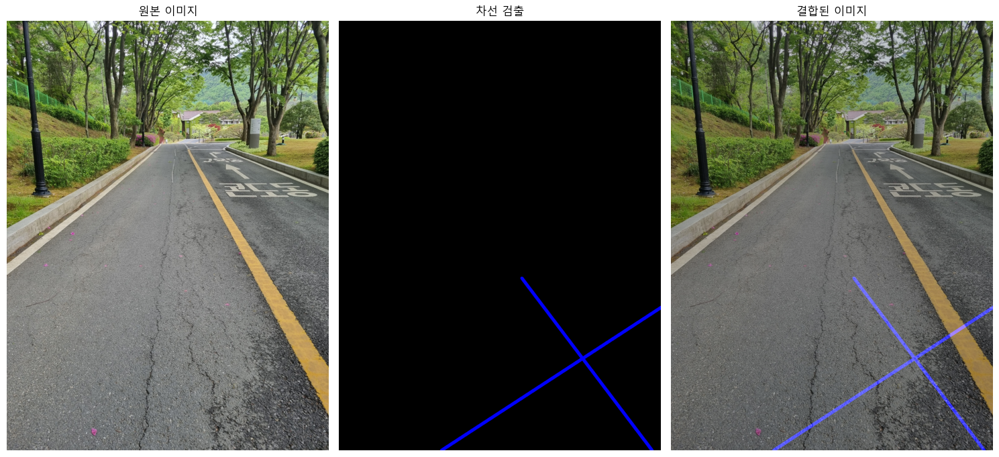

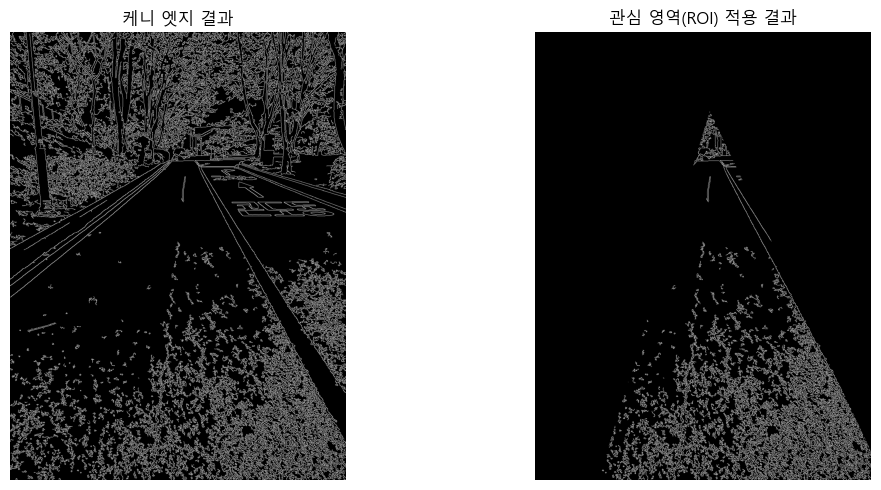

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

def reg_of_interest(image):
    image_height = image.shape[0]
    polygons = np.array([[(200, image_height), (1100, image_height), (550, 250)]])
    image_mask = np.zeros_like(image)
    cv2.fillPoly(image_mask, polygons, 255)
    masking_image = cv2.bitwise_and(image, image_mask)
    return masking_image

# 6. 케니에지 처리하는 함수
def canny_edge(image):
    gray_conversion = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blur_conversion = cv2.GaussianBlur(gray_conversion, (5, 5), 0)
    canny_conversion = cv2.Canny(blur_conversion, 50, 150)
    return canny_conversion

def show_lines(image, lines):
    lines_image = np.zeros_like(image)
    if lines is not None:
        for i in range(len(lines)):
            for x1, y1, x2, y2 in lines[i]:
                cv2.line(lines_image, (x1, y1), (x2, y2), (255, 0, 0), 10)
    return lines_image

# 여러 선을, 하나의 선으로 만들어 주는 함수.
# 방법은? 기울기와 y절편을 평균으로 해서 하나의 기울기와 y절편을 갖도록 만드는 방법.
def make_coordinates(image, line_parameters):
    slope, intercept = line_parameters
    y1 = image.shape[0]
    y2 = int(y1 * (3 / 5))
    x1 = int((y1 - intercept) / slope)
    x2 = int((y2 - intercept) / slope)
    return np.array([x1, y1, x2, y2])

def average_slope_intercept(image, lines):
    left_fit = []
    right_fit = []
    for line in lines:
        x1, y1, x2, y2 = line.reshape(4)
        parameter = np.polyfit((x1, x2), (y1, y2), 1)
        slope = parameter[0]
        intercept = parameter[1]
        if slope < 0:
            left_fit.append((slope, intercept))
        else:
            right_fit.append((slope, intercept))
    left_fit_average = np.average(left_fit, axis=0)
    right_fit_average = np.average(right_fit, axis=0)
    left_line = make_coordinates(image, left_fit_average)
    right_line = make_coordinates(image, right_fit_average)

    return np.array([[left_line, right_line]])

# 이미지 가져오기
image = cv2.imread('./image/test_image_01.jpg')
lanelines_image = image.copy()

# 흰 검으로 변환해서 라인 검출함.
canny_conversion = canny_edge(lanelines_image)
roi_conversion = reg_of_interest(canny_conversion)

# 라인 이어주기
lines = cv2.HoughLinesP(roi_conversion, 1, np.pi/180, 100, minLineLength=40, maxLineGap=5)

averaged_lines = average_slope_intercept(lanelines_image, lines)

# 선을 기울기 평균값으로 적용
lines_image = show_lines(lanelines_image, averaged_lines)

# 원본 이미지에 라인 그리기
combine_image = cv2.addWeighted(lanelines_image, 0.8, lines_image, 1, 1)

# Matplotlib으로 이미지 표시
plt.figure(figsize=(15, 10))

# OpenCV는 BGR, matplotlib은 RGB 사용하므로 변환 필요
plt.subplot(1, 3, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(lanelines_image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 2)
plt.title('차선 검출')
plt.imshow(cv2.cvtColor(lines_image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.subplot(1, 3, 3)
plt.title('결합된 이미지')
plt.imshow(cv2.cvtColor(combine_image, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()

# 추가로 케니 엣지와 ROI 결과도 보여주기
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.title('케니 엣지 결과')
plt.imshow(canny_conversion, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('관심 영역(ROI) 적용 결과')
plt.imshow(roi_conversion, cmap='gray')
plt.axis('off')

plt.tight_layout()
plt.show()

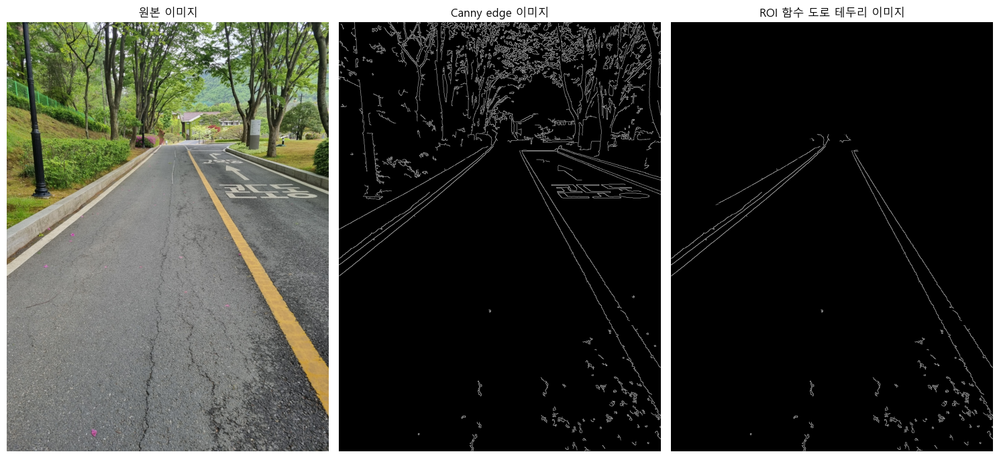

In [38]:
import cv2
import numpy as np

import matplotlib.font_manager as fm
# Windows 기본 폰트 중 한글 지원 폰트 사용
plt.rcParams['font.family'] = 'Malgun Gothic'  # 윈도우 기본 폰트인 맑은 고딕 사용
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

image = cv2.imread('./image/test_image_01.jpg')
lanelines_image = image.copy()

plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.title('원본 이미지')
plt.imshow(cv2.cvtColor(lanelines_image, cv2.COLOR_BGR2RGB))
plt.axis('off')

def canny_edge(image) :
    gray_conversion = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    blur_conversion = cv2.GaussianBlur(gray_conversion, (5,5), 0)
    canny_conversion = cv2.Canny(blur_conversion, 100, 300)
    return canny_conversion

canny_conversion = canny_edge(lanelines_image)
plt.subplot(1, 3, 2)
plt.title('Canny edge 이미지')
plt.imshow(cv2.cvtColor(canny_conversion, cv2.COLOR_BGR2RGB))
plt.axis('off')

def reg_of_interest(image) :
    image_height, image_width = image.shape[:2]
    polygons = np.array([[
        (0, image_height / 2),
        (0, image_height),
        (image_width, image_height),
        (image_width, image_height - 300), 
        (image_width / 2 + 50, image_height / 3 - 100),
        (image_width / 2 - 50, image_height / 3 - 100)
    ]], dtype=np.int32)
    image_mask = np.zeros_like(image)
    cv2.fillPoly(image_mask, polygons, 255)
    masking_image = cv2.bitwise_and(image, image_mask)
    return masking_image

roi_conversion = reg_of_interest(canny_conversion)
plt.subplot(1, 3, 3)
plt.title('ROI 함수 도로 테두리 이미지')
plt.imshow(cv2.cvtColor(roi_conversion, cv2.COLOR_BGR2RGB))
plt.axis('off')

plt.tight_layout()
plt.show()

In [41]:
import torch
import torchvision.transforms as T
from torchvision.models.segmentation import deeplabv3_resnet101, DeepLabV3_ResNet101_Weights
from PIL import Image
import numpy as np
import cv2
import os
from glob import glob
from pathlib import Path
from ultralytics import YOLO

# ⚙️ 경로 설정
IMAGE_DIR = './image'
RESULT_DIR = './image/result'
MODEL_PATH = '../kdh/best.pt'
os.makedirs(RESULT_DIR, exist_ok=True)

# ⚙️ GPU 설정
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print("Using device:", device)

# ✅ DeepLabv3+ 로드
weights = DeepLabV3_ResNet101_Weights.DEFAULT
deeplab = deeplabv3_resnet101(weights=weights).to(device)
deeplab.eval()
transform = weights.transforms()

# ✅ YOLOv11-seg 로드
yolo_model = YOLO(MODEL_PATH)

# ✅ 도로 마스크 추출 함수 (DeepLab)
def get_road_mask(img_path):
    img = Image.open(img_path).convert('RGB')
    input_tensor = transform(img).unsqueeze(0).to(device)

    with torch.no_grad():
        output = deeplab(input_tensor)['out'][0]
        pred = output.argmax(0).byte().cpu().numpy()

    road_mask = (pred == 7).astype(np.uint8)  # class 7 = road (DeepLab 기준)
    road_mask = cv2.resize(road_mask, img.size)
    return road_mask

# ✅ YOLOv11-seg 예측으로 균열 마스크 생성
def get_crack_mask(img_path, img_size):
    device_str = 'cuda' if torch.cuda.is_available() else 'cpu'
    results = yolo_model.predict(source=img_path, conf=0.25, save=False, imgsz=img_size, device=device_str)
    mask = np.zeros(img_size[::-1], dtype=np.uint8)

    for r in results:
        if r.masks is not None:
            for m in r.masks.data:
                binary_mask = m.cpu().numpy().astype(np.uint8)
                binary_mask = cv2.resize(binary_mask, img_size)
                mask = np.logical_or(mask, binary_mask)
    return mask.astype(np.uint8)

# ✅ 비율 계산 + 시각화 저장
def process_image(img_path):
    filename = Path(img_path).stem
    orig = cv2.imread(img_path)
    H, W, _ = orig.shape

    # 도로 마스크
    road_mask = get_road_mask(img_path)

    # 균열 마스크 (YOLOv11-seg)
    crack_mask = get_crack_mask(img_path, (W, H))

    # 교차 영역
    intersection = np.logical_and(road_mask, crack_mask).astype(np.uint8)

    crack_area = intersection.sum()
    road_area = road_mask.sum()
    ratio = (crack_area / road_area * 100) if road_area > 0 else 0

    # 시각화 저장
    vis_img = orig.copy()
    vis_img[road_mask == 1] = [0, 255, 0]         # Green: road
    vis_img[crack_mask == 1] = [255, 0, 0]        # Blue: crack
    vis_img[intersection == 1] = [0, 0, 255]      # Red: crack in road

    vis_save_path = f"{RESULT_DIR}/{filename}_vis.png"
    cv2.imwrite(vis_save_path, vis_img)

    return f"{filename}\t{road_area}\t{crack_area}\t{round(ratio, 2)}"

# ✅ 전체 실행
if __name__ == '__main__':
    image_list = sorted(glob(f"{IMAGE_DIR}/*.jpg"))
    txt_output_path = os.path.join(RESULT_DIR, "damage_ratios.txt")

    with open(txt_output_path, 'w', encoding='utf-8') as f:
        f.write("filename\troad_area\tcrack_area\tcrack_ratio(%)\n")
        for img_path in image_list:
            print(f"▶ Processing: {img_path}")
            line = process_image(img_path)
            f.write(line + "\n")

    print(f"\n✅ 전체 완료! 결과는 {RESULT_DIR} 폴더에 저장되었습니다.")


Using device: cpu
▶ Processing: ./image\test_image_01.jpg

WARNING imgsz=[1058, 1411] must be multiple of max stride 32, updating to [1088, 1440]
image 1/1 c:\Users\SSAFY\Desktop\Final_Project\S12P31B201\ai\opencv\image\test_image_01.jpg: 1088x832 3 cracks, 1081.0ms
Speed: 9.4ms preprocess, 1081.0ms inference, 8.6ms postprocess per image at shape (1, 3, 1088, 832)
▶ Processing: ./image\test_image_02.jpg

WARNING imgsz=[1058, 1411] must be multiple of max stride 32, updating to [1088, 1440]
image 1/1 c:\Users\SSAFY\Desktop\Final_Project\S12P31B201\ai\opencv\image\test_image_02.jpg: 1088x832 8 cracks, 1058.9ms
Speed: 9.9ms preprocess, 1058.9ms inference, 20.9ms postprocess per image at shape (1, 3, 1088, 832)
▶ Processing: ./image\test_image_03.jpg

WARNING imgsz=[1058, 1411] must be multiple of max stride 32, updating to [1088, 1440]
image 1/1 c:\Users\SSAFY\Desktop\Final_Project\S12P31B201\ai\opencv\image\test_image_03.jpg: 1088x832 9 cracks, 1048.7ms
Speed: 8.8ms preprocess, 1048.7ms 

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.

0: 1024x768 13 cracks, 1160.9ms
Speed: 9.1ms preprocess, 1160.9ms inference, 26.0ms postprocess per image at shape (1, 3, 1024, 768)


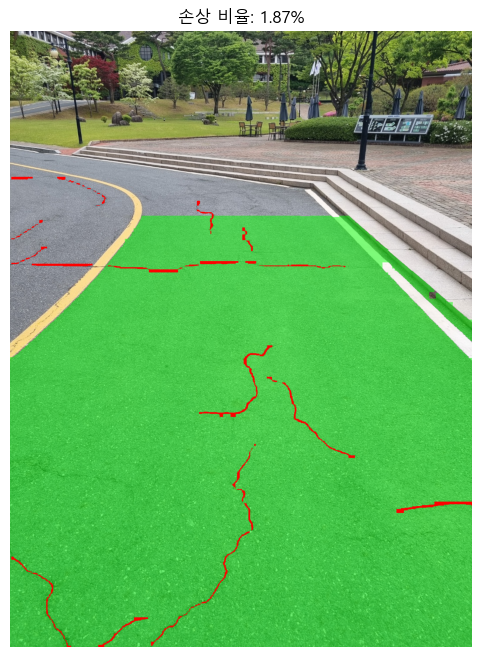

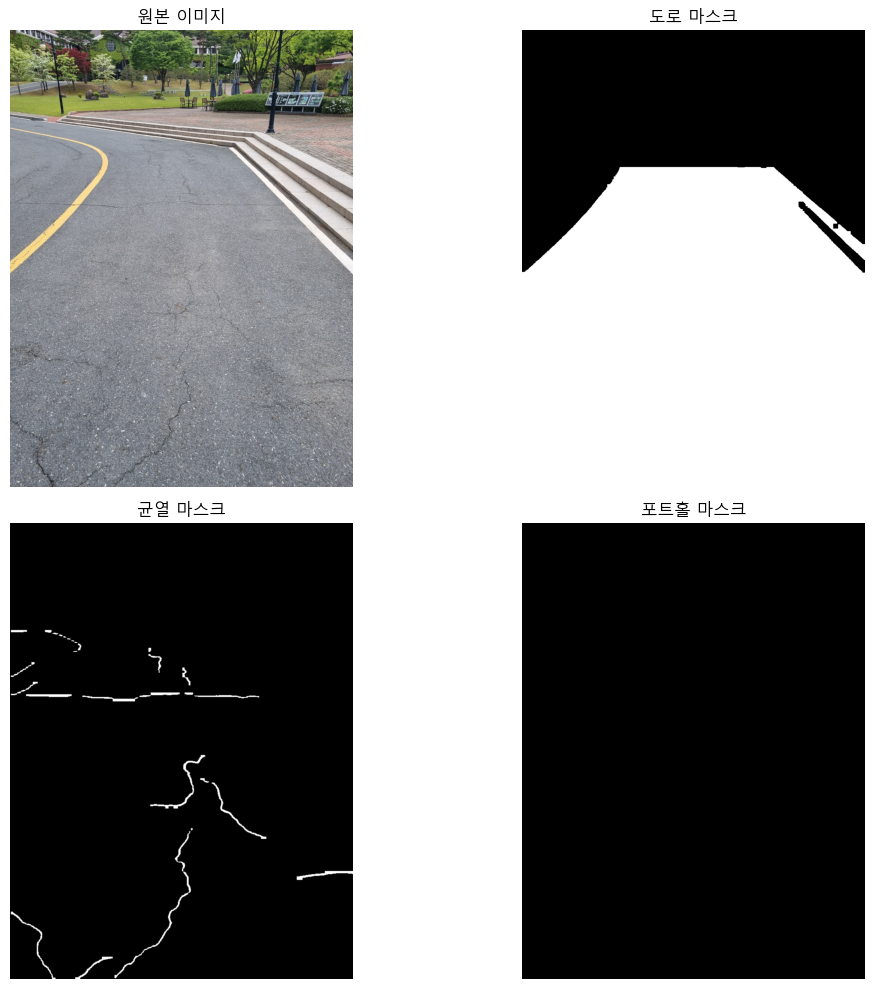

In [52]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# 1. 모델 로드
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

# 2. 이미지 로드
img_path = './image/test_image_07.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 3. 추론
results = model(img_rgb)
res = results[0]

# 4. 클래스별 마스크 생성
mask_crack = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
mask_pothole = np.zeros(img_rgb.shape[:2], dtype=np.uint8)

for i, box in enumerate(res.boxes):
    cls = int(box.cls[0])
    single_mask = res.masks.data[i].cpu().numpy()
    binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
    binary_mask_resized = cv2.resize(binary_mask, (img_rgb.shape[1], img_rgb.shape[0]))

    if cls == 0:  # crack
        mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
    elif cls == 1:  # pothole
        mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)

# ✅ 5. 도로 마스크 함수 정의
# def extract_road_mask(img):
#     hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
#     lower_road = np.array([0, 0, 40])
#     upper_road = np.array([180, 60, 180])
#     road_mask = cv2.inRange(hsv, lower_road, upper_road)
#     road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, np.ones((15, 15), np.uint8))
#     return road_mask
def extract_road_mask(img):
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열) - 더 좁은 범위로 조정
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 70%만 고려 (하늘 제외)
    height = img.shape[0]
    road_mask[:int(height * 0.3), :] = 0  # 상단 30% 마스킹 제거
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지 (도로 외 작은 영역 제거)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        # 가장 큰 영역 찾기
        max_contour = max(contours, key=cv2.contourArea)
        # 너무 작은 영역은 무시
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):  # 이미지 크기의 10% 이상
            # 새 마스크 생성
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

# 도로 마스크 추출
road_mask = extract_road_mask(img_bgr)

# 6. 손상 비율 계산
combined_damage_mask = cv2.bitwise_or(mask_crack, mask_pothole)
intersection = cv2.bitwise_and(combined_damage_mask, road_mask)
road_area = np.count_nonzero(road_mask)
damage_area = np.count_nonzero(intersection)
damage_ratio = damage_area / road_area if road_area else 0

# 7. 시각화
# overlay = img_rgb.copy()
# overlay[road_mask == 255] = [0, 255, 0]               # 도로: 초록색
# overlay[mask_crack == 255] = [255, 0, 0]              # crack: 빨간색
# overlay[mask_pothole == 255] = [0, 0, 255]            # pothole: 파란색
overlay = img_rgb.copy()
# 반투명 효과를 위한 알파 블렌딩
alpha = 0.5
beta = 1 - alpha

# 도로 마스크 시각화 (초록색 반투명)
road_overlay = overlay.copy()
road_overlay[road_mask == 255] = [0, 255, 0]
overlay = cv2.addWeighted(road_overlay, alpha, overlay, beta, 0)

# 손상 시각화 (빨간색/파란색 불투명)
overlay[mask_crack == 255] = [255, 0, 0]      # crack: 빨간색
overlay[mask_pothole == 255] = [0, 0, 255]    # pothole: 파란색

plt.figure(figsize=(10, 8))
plt.imshow(overlay)
plt.title(f'손상 비율: {damage_ratio*100:.2f}%')
plt.axis('off')
plt.show()

# 추가 분석: 서로 다른 마스크 시각화
plt.figure(figsize=(12, 10))

plt.subplot(2, 2, 1)
plt.imshow(img_rgb)
plt.title('원본 이미지')
plt.axis('off')

plt.subplot(2, 2, 2)
plt.imshow(road_mask, cmap='gray')
plt.title('도로 마스크')
plt.axis('off')

plt.subplot(2, 2, 3)
plt.imshow(mask_crack, cmap='gray')
plt.title('균열 마스크')
plt.axis('off')

plt.subplot(2, 2, 4)
plt.imshow(mask_pothole, cmap='gray')
plt.title('포트홀 마스크')
plt.axis('off')

plt.tight_layout()
plt.show()

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.

0: 1024x768 5 cracks, 1260.0ms
Speed: 9.5ms preprocess, 1260.0ms inference, 34.7ms postprocess per image at shape (1, 3, 1024, 768)


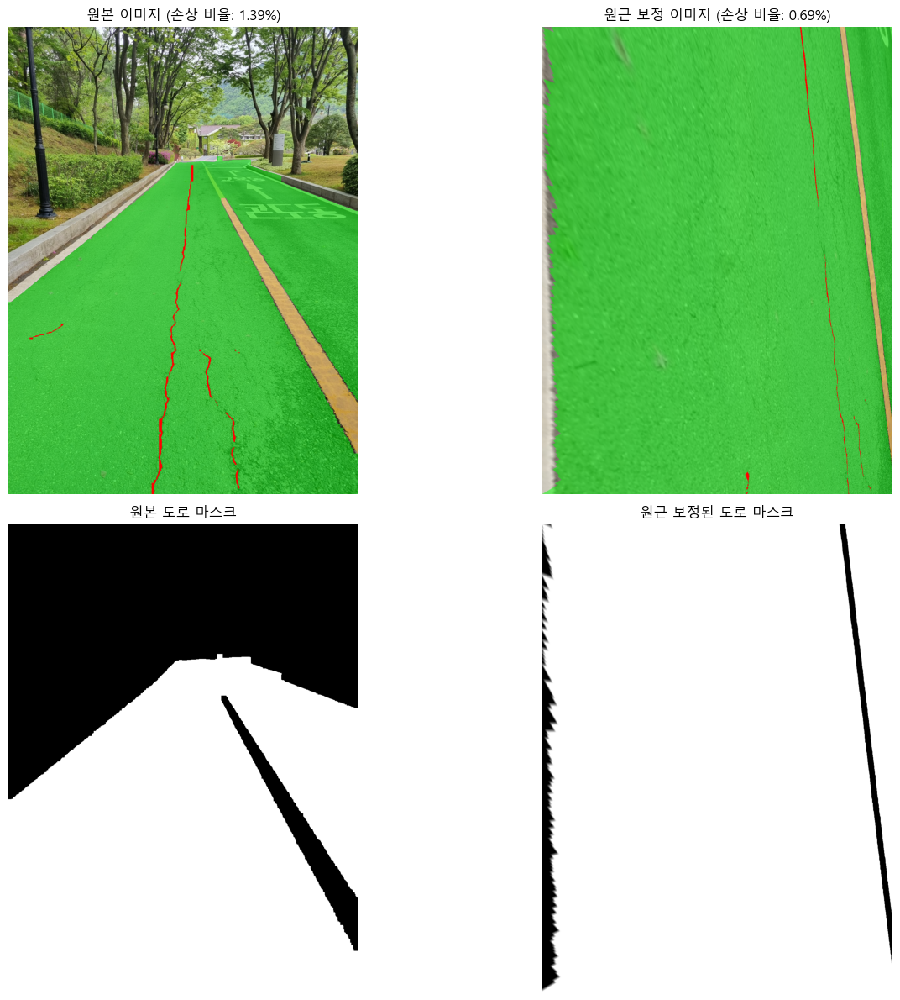

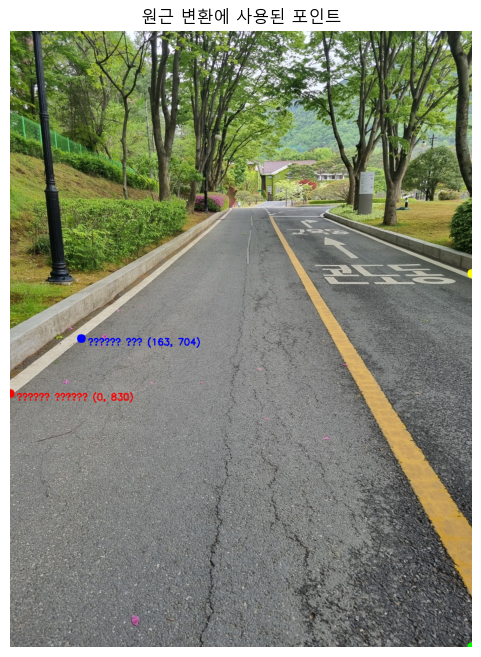

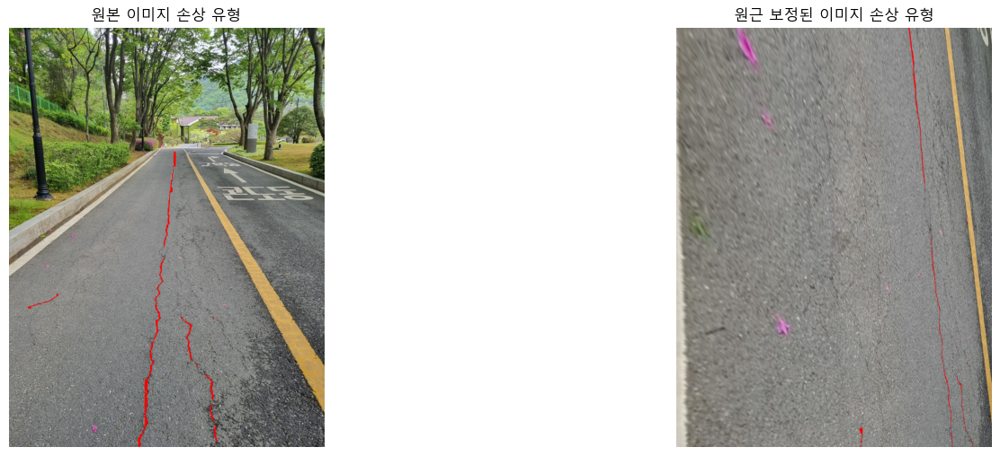


===== 도로 손상 분석 결과 =====
원본 이미지 도로 면적: 879292 픽셀
원본 이미지 균열 면적: 12238 픽셀 (1.39%)
원본 이미지 포트홀 면적: 0 픽셀 (0.00%)
원본 이미지 총 손상 비율: 1.39%


원근 보정 이미지 도로 면적: 1443646 픽셀
원근 보정 이미지 균열 면적: 10019 픽셀 (0.69%)
원근 보정 이미지 포트홀 면적: 0 픽셀 (0.00%)
원근 보정 이미지 총 손상 비율: 0.69%


In [60]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

# 운영체제별 기본 폰트 설정
system = platform.system()
if system == 'Windows':
    font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
elif system == 'Darwin':  # macOS
    font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
else:  # Linux
    font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

# 폰트 패스가 유효한지 확인
try:
    font_prop = fm.FontProperties(fname=font_path)
    plt.rcParams['font.family'] = font_prop.get_name()
except:
    print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
    plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

# 그래프에서 마이너스 폰트 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

# 1. 모델 로드
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

# 2. 이미지 로드
img_path = './image/test_image_01.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 3. 추론
results = model(img_rgb)
res = results[0]

# 4. 클래스별 마스크 생성
mask_crack = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
mask_pothole = np.zeros(img_rgb.shape[:2], dtype=np.uint8)

for i, box in enumerate(res.boxes):
    cls = int(box.cls[0])
    single_mask = res.masks.data[i].cpu().numpy()
    binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
    binary_mask_resized = cv2.resize(binary_mask, (img_rgb.shape[1], img_rgb.shape[0]))

    if cls == 0:  # crack
        mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
    elif cls == 1:  # pothole
        mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)

# 5. 개선된 도로 마스크 함수 정의
def extract_road_mask_improved(img):
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열) - 더 좁은 범위로 조정
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외) - 수정된 부분
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0  # 상단 25% 마스킹 제거
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지 (도로 외 작은 영역 제거)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        # 가장 큰 영역 찾기
        max_contour = max(contours, key=cv2.contourArea)
        # 너무 작은 영역은 무시
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):  # 이미지 크기의 10% 이상
            # 새 마스크 생성
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

# 6. 도로 영역의 원근 보정 함수 수정 - 컨투어 기반 모서리 선택
def perspective_transform(img, road_mask):
    # 도로 마스크 이진화 (이미 이진화되어 있지만 확실히 하기 위해)
    _, binary = cv2.threshold(road_mask, 127, 255, cv2.THRESH_BINARY)
    
    # 윤곽선 추출
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 마스크가 비어있는 경우 기본값 사용
    if not contours:
        height, width = road_mask.shape
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
    else:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        
        # 컨투어를 2차원 좌표 배열로 변환
        points = main_contour[:, 0, :]  # shape: (N, 2)
        
        # 상/하 분할
        median_y = np.median(points[:, 1])
        lower = points[points[:, 1] > median_y]
        upper = points[points[:, 1] <= median_y]
        
        # 각 꼭짓점 선택
        if len(lower) > 0:
            left_bottom = lower[np.argmin(lower[:, 0])]
            right_bottom = lower[np.argmax(lower[:, 0])]
        else:
            height, width = road_mask.shape
            left_bottom = np.array([0, height-1])
            right_bottom = np.array([width-1, height-1])
            
        if len(upper) > 0:
            left_top = upper[np.argmin(upper[:, 0])]
            right_top = upper[np.argmax(upper[:, 0])]
        else:
            height, width = road_mask.shape
            left_top = np.array([width//4, height//3])
            right_top = np.array([width*3//4, height//3])
        
        # 각 모서리 포인트 정의
        bottom_left = left_bottom
        bottom_right = right_bottom
        top_left = left_top
        top_right = right_top
    
    # 소스 포인트 (원본 이미지에서 선택한 4개 점)
    src_points = np.array([bottom_left, bottom_right, top_left, top_right], dtype=np.float32)
    
    # 도로 마스크 이미지 크기
    height, width = road_mask.shape
    
    # 타겟 포인트 (변환 후 이미지에서의 위치)
    # 사각형 형태로 만들기
    dst_points = np.array([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ], dtype=np.float32)
    
    # 원근 변환 행렬 계산
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    
    # 원근 변환 적용
    warped_img = cv2.warpPerspective(img, M, (width, height))
    
    # 각 마스크에도 동일한 변환 적용
    warped_road_mask = cv2.warpPerspective(road_mask, M, (width, height))
    
    return warped_img, warped_road_mask, M, src_points  # 소스 포인트도 반환

# 7. 원본 이미지와 마스크에 원근 보정 적용
def apply_perspective_correction(img_rgb, road_mask, mask_crack, mask_pothole):
    # 원근 변환 적용
    warped_img, warped_road_mask, perspective_matrix, corner_points = perspective_transform(img_rgb, road_mask)
    
    # 균열과 포트홀 마스크에도 동일한 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    
    # 원근 보정 후 손상 비율 재계산
    combined_damage_mask = cv2.bitwise_or(warped_crack, warped_pothole)
    intersection = cv2.bitwise_and(combined_damage_mask, warped_road_mask)
    road_area = np.count_nonzero(warped_road_mask)
    damage_area = np.count_nonzero(intersection)
    damage_ratio = damage_area / road_area if road_area else 0
    
    return warped_img, warped_road_mask, warped_crack, warped_pothole, damage_ratio, perspective_matrix, corner_points

# 8. 코드 실행

# 개선된 도로 마스크 추출
road_mask = extract_road_mask_improved(img_bgr)

# 손상 비율 계산 (원본)
combined_damage_mask = cv2.bitwise_or(mask_crack, mask_pothole)
intersection = cv2.bitwise_and(combined_damage_mask, road_mask)
road_area = np.count_nonzero(road_mask)
damage_area = np.count_nonzero(intersection)
damage_ratio = damage_area / road_area if road_area else 0

# 원근 보정 적용 - 반환값 변경 반영
warped_img, warped_road_mask, warped_crack, warped_pothole, warped_damage_ratio, perspective_matrix, corner_points = apply_perspective_correction(
    img_rgb, road_mask, mask_crack, mask_pothole
)

# 9. 결과 시각화

# 원본 이미지와 마스크 시각화
plt.figure(figsize=(15, 12))

# 원본 이미지와 마스크
plt.subplot(2, 2, 1)
overlay_original = img_rgb.copy()
alpha = 0.5
road_overlay = overlay_original.copy()
road_overlay[road_mask == 255] = [0, 255, 0]
overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
overlay_original[mask_crack == 255] = [255, 0, 0]
overlay_original[mask_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_original)
plt.title(f'원본 이미지 (손상 비율: {damage_ratio*100:.2f}%)')
plt.axis('off')

# 원근 보정된 이미지와 마스크
plt.subplot(2, 2, 2)
overlay_warped = warped_img.copy()
road_overlay_warped = overlay_warped.copy()
road_overlay_warped[warped_road_mask == 255] = [0, 255, 0]
overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
overlay_warped[warped_crack == 255] = [255, 0, 0]
overlay_warped[warped_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_warped)
plt.title(f'원근 보정 이미지 (손상 비율: {warped_damage_ratio*100:.2f}%)')
plt.axis('off')

# 원본 도로 마스크
plt.subplot(2, 2, 3)
plt.imshow(road_mask, cmap='gray')
plt.title('원본 도로 마스크')
plt.axis('off')

# 원근 보정된 도로 마스크
plt.subplot(2, 2, 4)
plt.imshow(warped_road_mask, cmap='gray')
plt.title('원근 보정된 도로 마스크')
plt.axis('off')

plt.tight_layout()
plt.show()

# 10. 원근 변환에 사용된 포인트 표시
plt.figure(figsize=(10, 8))
img_with_points = img_rgb.copy()

# 원근 보정 적용 시 반환된 모서리 포인트 사용
warped_img, warped_road_mask, warped_crack, warped_pothole, warped_damage_ratio, perspective_matrix, corner_points = apply_perspective_correction(
    img_rgb, road_mask, mask_crack, mask_pothole
)

# 모서리 포인트 순서 정리
bottom_left, bottom_right, top_left, top_right = corner_points

# 포인트 표시
points = [bottom_left, bottom_right, top_left, top_right]
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 빨강, 초록, 파랑, 노랑
point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']

for i, (x, y) in enumerate(points):
    cv2.circle(img_with_points, (int(x), int(y)), 10, colors[i], -1)  # 원 그리기
    # 포인트 좌표와 이름 표시
    cv2.putText(img_with_points, f'{point_names[i]} ({int(x)}, {int(y)})', 
                (int(x) + 15, int(y) + 15), cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)

plt.imshow(img_with_points)
plt.title('원근 변환에 사용된 포인트')
plt.axis('off')
plt.show()

# 11. 손상 유형별 분석 시각화
plt.figure(figsize=(15, 10))

# 원본 이미지의 손상 유형
plt.subplot(2, 2, 1)
damage_overlay = img_rgb.copy()
damage_overlay[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
damage_overlay[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(damage_overlay)
plt.title('원본 이미지 손상 유형')
plt.axis('off')

# 원근 보정된 이미지의 손상 유형
plt.subplot(2, 2, 2)
warped_damage_overlay = warped_img.copy()
warped_damage_overlay[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
warped_damage_overlay[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(warped_damage_overlay)
plt.title('원근 보정된 이미지 손상 유형')
plt.axis('off')

# 손상 유형별 면적 계산
crack_area_original = np.count_nonzero(cv2.bitwise_and(mask_crack, road_mask))
pothole_area_original = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_mask))

crack_area_warped = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_road_mask))
pothole_area_warped = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_road_mask))

plt.tight_layout()
plt.show()

# 12. 결과 요약 출력
print("\n===== 도로 손상 분석 결과 =====")
print(f"원본 이미지 도로 면적: {road_area} 픽셀")
print(f"원본 이미지 균열 면적: {crack_area_original} 픽셀 ({crack_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 포트홀 면적: {pothole_area_original} 픽셀 ({pothole_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 총 손상 비율: {damage_ratio*100:.2f}%")
print("\n")
print(f"원근 보정 이미지 도로 면적: {warped_road_area} 픽셀")
print(f"원근 보정 이미지 균열 면적: {crack_area_warped} 픽셀 ({crack_area_warped/warped_road_area*100:.2f}%)")
print(f"원근 보정 이미지 포트홀 면적: {pothole_area_warped} 픽셀 ({pothole_area_warped/warped_road_area*100:.2f}%)")
print(f"원근 보정 이미지 총 손상 비율: {warped_damage_ratio*100:.2f}%")

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.

0: 1024x768 13 cracks, 1150.7ms
Speed: 5.6ms preprocess, 1150.7ms inference, 28.2ms postprocess per image at shape (1, 3, 1024, 768)


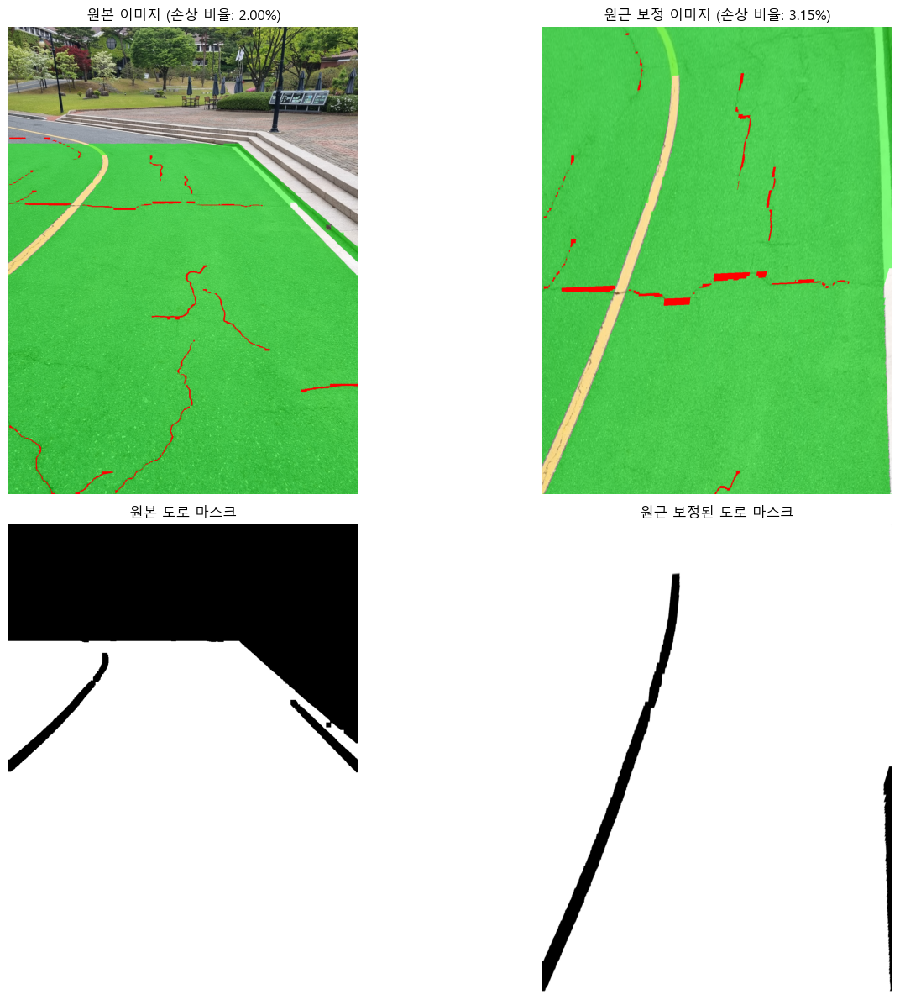

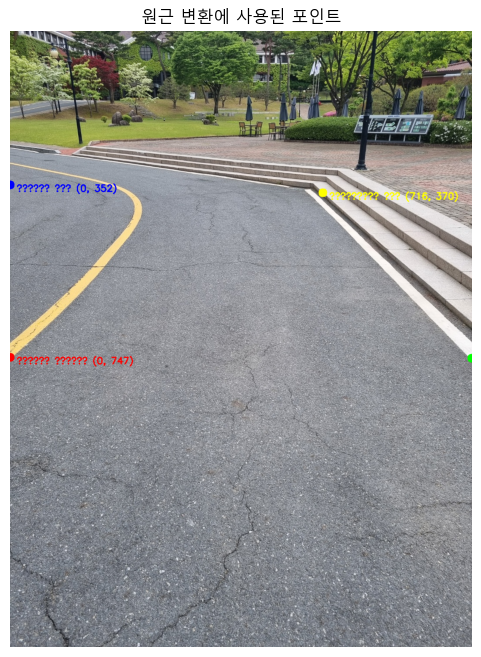

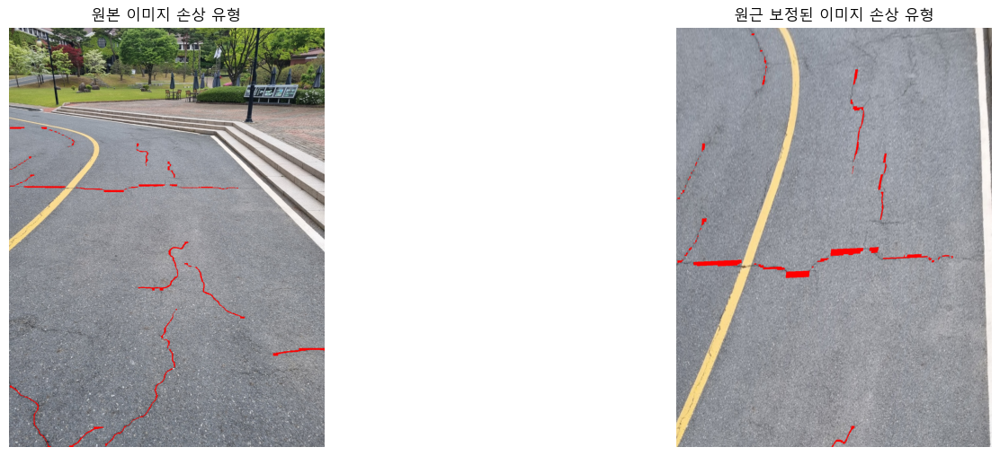


===== 도로 손상 분석 결과 =====
원본 이미지 도로 면적: 1044065 픽셀
원본 이미지 균열 면적: 20834 픽셀 (2.00%)
원본 이미지 포트홀 면적: 0 픽셀 (0.00%)
원본 이미지 총 손상 비율: 2.00%
원근 보정 이미지 총 손상 비율: 3.15%


In [2]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

# 운영체제별 기본 폰트 설정
system = platform.system()
if system == 'Windows':
    font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
elif system == 'Darwin':  # macOS
    font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
else:  # Linux
    font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

# 폰트 패스가 유효한지 확인
try:
    font_prop = fm.FontProperties(fname=font_path)
    plt.rcParams['font.family'] = font_prop.get_name()
except:
    print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
    plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

# 그래프에서 마이너스 폰트 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

# 1. 모델 로드
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

# 2. 이미지 로드
img_path = './image/test_image_07.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 3. 추론
results = model(img_rgb)
res = results[0]

# 4. 클래스별 마스크 생성
mask_crack = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
mask_pothole = np.zeros(img_rgb.shape[:2], dtype=np.uint8)

for i, box in enumerate(res.boxes):
    cls = int(box.cls[0])
    single_mask = res.masks.data[i].cpu().numpy()
    binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
    binary_mask_resized = cv2.resize(binary_mask, (img_rgb.shape[1], img_rgb.shape[0]))

    if cls == 0:  # crack
        mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
    elif cls == 1:  # pothole
        mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)

# 5. 개선된 도로 마스크 함수 정의
def extract_road_mask_improved(img):
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열) - 더 좁은 범위로 조정
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외) - 수정된 부분
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0  # 상단 25% 마스킹 제거
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지 (도로 외 작은 영역 제거)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        # 가장 큰 영역 찾기
        max_contour = max(contours, key=cv2.contourArea)
        # 너무 작은 영역은 무시
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):  # 이미지 크기의 10% 이상
            # 새 마스크 생성
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

# 6. 도로 영역의 원근 보정 함수 수정 - y값 최대/최소 기반 모서리 선택
def perspective_transform(img, road_mask):
    # 도로 마스크 이진화 (이미 이진화되어 있지만 확실히 하기 위해)
    _, binary = cv2.threshold(road_mask, 127, 255, cv2.THRESH_BINARY)
    
    # 윤곽선 추출
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 마스크가 비어있는 경우 기본값 사용
    if not contours:
        height, width = road_mask.shape
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
    else:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        
        # 컨투어를 2차원 좌표 배열로 변환
        points = main_contour[:, 0, :]  # shape: (N, 2)
        
        # y값 기준으로 정렬
        y_sorted = points[np.argsort(points[:, 1])]
        
        # 상단 포인트 (y값이 가장 작은 5% 포인트들)
        top_percent = 0.05
        top_points_count = max(2, int(len(y_sorted) * top_percent))
        top_points = y_sorted[:top_points_count]
        
        # 하단 포인트 (y값이 가장 큰 5% 포인트들)
        bottom_points = y_sorted[-top_points_count:]
        
        # 상단 좌/우 포인트 선택 (y값이 가장 작은 포인트들 중 x값이 가장 작은/큰 것)
        top_left = top_points[np.argmin(top_points[:, 0])]
        top_right = top_points[np.argmax(top_points[:, 0])]
        
        # 하단 좌/우 포인트 선택 (y값이 가장 큰 포인트들 중 x값이 가장 작은/큰 것)
        bottom_left = bottom_points[np.argmin(bottom_points[:, 0])]
        bottom_right = bottom_points[np.argmax(bottom_points[:, 0])]
    
    # 소스 포인트 (원본 이미지에서 선택한 4개 점)
    src_points = np.array([bottom_left, bottom_right, top_left, top_right], dtype=np.float32)
    
    # 도로 마스크 이미지 크기
    height, width = road_mask.shape
    
    # 타겟 포인트 (변환 후 이미지에서의 위치)
    # 사각형 형태로 만들기
    dst_points = np.array([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ], dtype=np.float32)
    
    # 원근 변환 행렬 계산
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    
    # 원근 변환 적용
    warped_img = cv2.warpPerspective(img, M, (width, height))
    
    # 각 마스크에도 동일한 변환 적용
    warped_road_mask = cv2.warpPerspective(road_mask, M, (width, height))
    
    return warped_img, warped_road_mask, M, src_points  # 소스 포인트도 반환

# 7. 원본 이미지와 마스크에 원근 보정 적용
def apply_perspective_correction(img_rgb, road_mask, mask_crack, mask_pothole):
    # 원근 변환 적용
    warped_img, warped_road_mask, perspective_matrix, corner_points = perspective_transform(img_rgb, road_mask)
    
    # 균열과 포트홀 마스크에도 동일한 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    
    # 원근 보정 후 손상 비율 재계산
    combined_damage_mask = cv2.bitwise_or(warped_crack, warped_pothole)
    intersection = cv2.bitwise_and(combined_damage_mask, warped_road_mask)
    road_area = np.count_nonzero(warped_road_mask)
    damage_area = np.count_nonzero(intersection)
    damage_ratio = damage_area / road_area if road_area else 0
    
    return warped_img, warped_road_mask, warped_crack, warped_pothole, damage_ratio, perspective_matrix, corner_points

# 8. 코드 실행

# 개선된 도로 마스크 추출
road_mask = extract_road_mask_improved(img_bgr)

# 손상 비율 계산 (원본)
combined_damage_mask = cv2.bitwise_or(mask_crack, mask_pothole)
intersection = cv2.bitwise_and(combined_damage_mask, road_mask)
road_area = np.count_nonzero(road_mask)
damage_area = np.count_nonzero(intersection)
damage_ratio = damage_area / road_area if road_area else 0

# 원근 보정 적용 - 반환값 변경 반영
warped_img, warped_road_mask, warped_crack, warped_pothole, warped_damage_ratio, perspective_matrix, corner_points = apply_perspective_correction(
    img_rgb, road_mask, mask_crack, mask_pothole
)

# 9. 결과 시각화

# 원본 이미지와 마스크 시각화
plt.figure(figsize=(15, 12))

# 원본 이미지와 마스크
plt.subplot(2, 2, 1)
overlay_original = img_rgb.copy()
alpha = 0.5
road_overlay = overlay_original.copy()
road_overlay[road_mask == 255] = [0, 255, 0]
overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
overlay_original[mask_crack == 255] = [255, 0, 0]
overlay_original[mask_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_original)
plt.title(f'원본 이미지 (손상 비율: {damage_ratio*100:.2f}%)')
plt.axis('off')

# 원근 보정된 이미지와 마스크
plt.subplot(2, 2, 2)
overlay_warped = warped_img.copy()
road_overlay_warped = overlay_warped.copy()
road_overlay_warped[warped_road_mask == 255] = [0, 255, 0]
overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
overlay_warped[warped_crack == 255] = [255, 0, 0]
overlay_warped[warped_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_warped)
plt.title(f'원근 보정 이미지 (손상 비율: {warped_damage_ratio*100:.2f}%)')
plt.axis('off')

# 원본 도로 마스크
plt.subplot(2, 2, 3)
plt.imshow(road_mask, cmap='gray')
plt.title('원본 도로 마스크')
plt.axis('off')

# 원근 보정된 도로 마스크
plt.subplot(2, 2, 4)
plt.imshow(warped_road_mask, cmap='gray')
plt.title('원근 보정된 도로 마스크')
plt.axis('off')

plt.tight_layout()
plt.show()

# 10. 원근 변환에 사용된 포인트 표시
plt.figure(figsize=(10, 8))
img_with_points = img_rgb.copy()

# 원근 보정 적용 시 반환된 모서리 포인트 사용
warped_img, warped_road_mask, warped_crack, warped_pothole, warped_damage_ratio, perspective_matrix, corner_points = apply_perspective_correction(
    img_rgb, road_mask, mask_crack, mask_pothole
)

# 모서리 포인트 순서 정리
bottom_left, bottom_right, top_left, top_right = corner_points

# 포인트 표시
points = [bottom_left, bottom_right, top_left, top_right]
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 빨강, 초록, 파랑, 노랑
point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']

for i, (x, y) in enumerate(points):
    cv2.circle(img_with_points, (int(x), int(y)), 10, colors[i], -1)  # 원 그리기
    # 포인트 좌표와 이름 표시
    cv2.putText(img_with_points, f'{point_names[i]} ({int(x)}, {int(y)})', 
                (int(x) + 15, int(y) + 15), cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)

plt.imshow(img_with_points)
plt.title('원근 변환에 사용된 포인트')
plt.axis('off')
plt.show()

# 11. 손상 유형별 분석 시각화
plt.figure(figsize=(15, 10))

# 원본 이미지의 손상 유형
plt.subplot(2, 2, 1)
damage_overlay = img_rgb.copy()
damage_overlay[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
damage_overlay[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(damage_overlay)
plt.title('원본 이미지 손상 유형')
plt.axis('off')

# 원근 보정된 이미지의 손상 유형
plt.subplot(2, 2, 2)
warped_damage_overlay = warped_img.copy()
warped_damage_overlay[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
warped_damage_overlay[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(warped_damage_overlay)
plt.title('원근 보정된 이미지 손상 유형')
plt.axis('off')

# 손상 유형별 면적 계산
crack_area_original = np.count_nonzero(cv2.bitwise_and(mask_crack, road_mask))
pothole_area_original = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_mask))

crack_area_warped = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_road_mask))
pothole_area_warped = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_road_mask))

plt.tight_layout()
plt.show()

# 12. 결과 요약 출력
print("\n===== 도로 손상 분석 결과 =====")
print(f"원본 이미지 도로 면적: {road_area} 픽셀")
print(f"원본 이미지 균열 면적: {crack_area_original} 픽셀 ({crack_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 포트홀 면적: {pothole_area_original} 픽셀 ({pothole_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 총 손상 비율: {damage_ratio*100:.2f}%")
print(f"원근 보정 이미지 총 손상 비율: {warped_damage_ratio*100:.2f}%")

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.

0: 768x1024 5 cracks, 2910.1ms
Speed: 9.4ms preprocess, 2910.1ms inference, 61.0ms postprocess per image at shape (1, 3, 768, 1024)


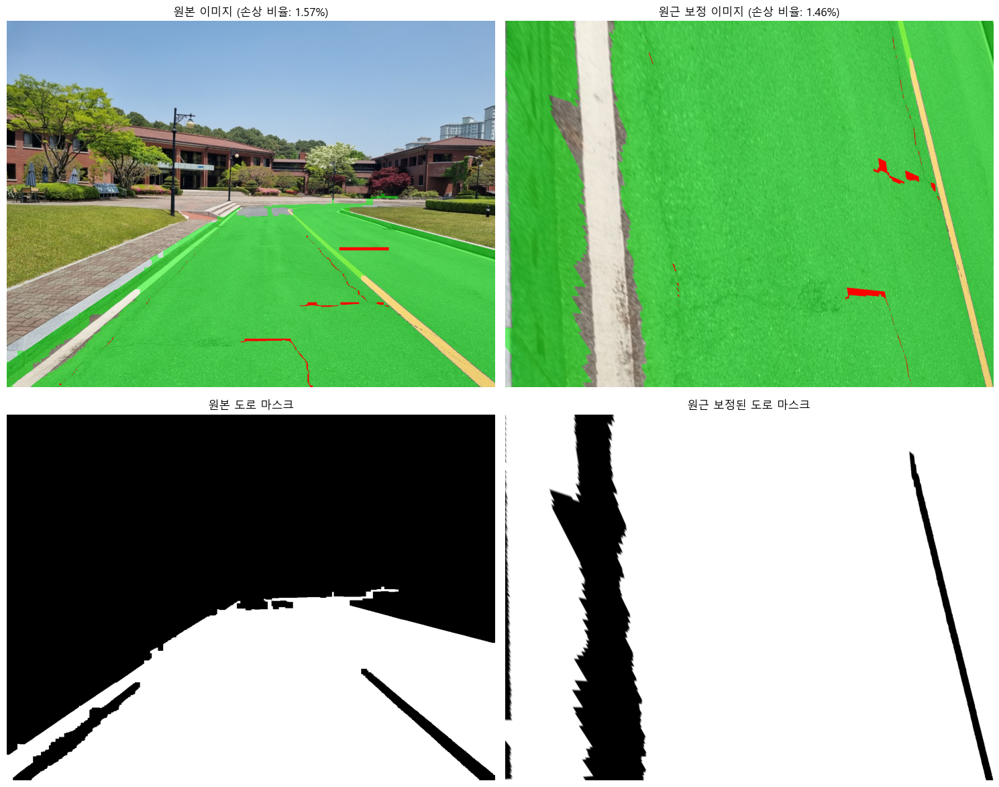

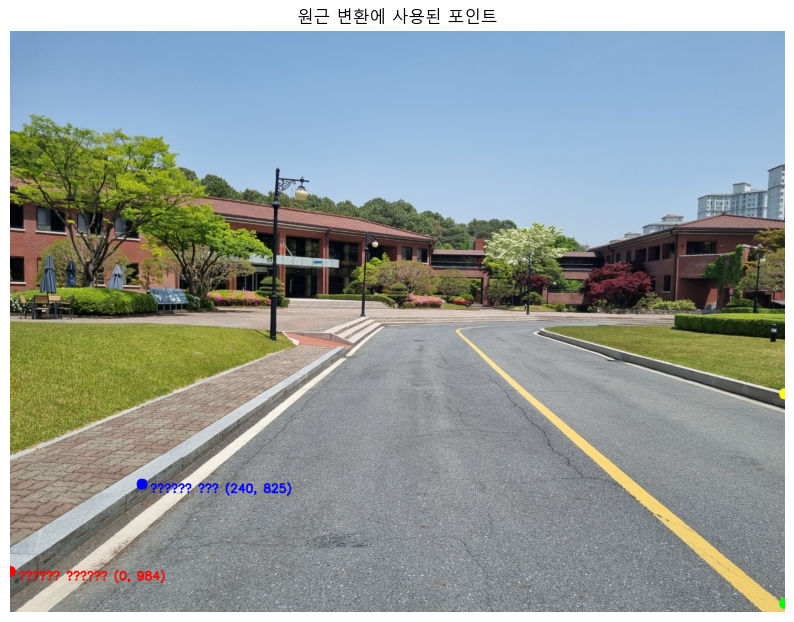

NameError: name 'ᄆ' is not defined

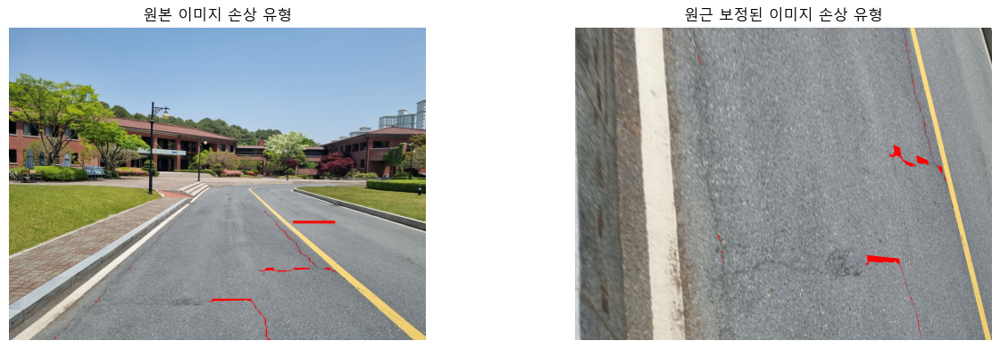

In [31]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

# 운영체제별 기본 폰트 설정
system = platform.system()
if system == 'Windows':
    font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
elif system == 'Darwin':  # macOS
    font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
else:  # Linux
    font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

# 폰트 패스가 유효한지 확인
try:
    font_prop = fm.FontProperties(fname=font_path)
    plt.rcParams['font.family'] = font_prop.get_name()
except:
    print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
    plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

# 그래프에서 마이너스 폰트 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

# 1. 모델 로드
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

# 2. 이미지 로드
img_path = './image/test_image_14.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)

# 3. 추론
results = model(img_rgb)
res = results[0]

# 4. 클래스별 마스크 생성
mask_crack = np.zeros(img_rgb.shape[:2], dtype=np.uint8)
mask_pothole = np.zeros(img_rgb.shape[:2], dtype=np.uint8)

for i, box in enumerate(res.boxes):
    cls = int(box.cls[0])
    single_mask = res.masks.data[i].cpu().numpy()
    binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
    binary_mask_resized = cv2.resize(binary_mask, (img_rgb.shape[1], img_rgb.shape[0]))

    if cls == 0:  # crack
        mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
    elif cls == 1:  # pothole
        mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)

# 5. 개선된 도로 마스크 함수 정의
def extract_road_mask_improved(img):
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열) - 더 좁은 범위로 조정
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외) - 수정된 부분
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0  # 상단 25% 마스킹 제거
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지 (도로 외 작은 영역 제거)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        # 가장 큰 영역 찾기
        max_contour = max(contours, key=cv2.contourArea)
        # 너무 작은 영역은 무시
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):  # 이미지 크기의 10% 이상
            # 새 마스크 생성
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

# 6. 도로 영역의 원근 보정 함수 수정 - 중앙값 기준 상/하 분할 방식
def perspective_transform(img, road_mask):
    # 도로 마스크 이진화 (이미 이진화되어 있지만 확실히 하기 위해)
    _, binary = cv2.threshold(road_mask, 127, 255, cv2.THRESH_BINARY)
    
    # 윤곽선 추출
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 마스크가 비어있는 경우 기본값 사용
    if not contours:
        height, width = road_mask.shape
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
    else:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        
        # 컨투어를 2차원 좌표 배열로 변환
        points = main_contour[:, 0, :]  # shape: (N, 2)
        
        # 상/하 분할
        median_y = np.median(points[:, 1])
        lower = points[points[:, 1] > median_y]
        upper = points[points[:, 1] <= median_y]
        
        # 각 꼭짓점 선택
        if len(lower) > 0:
            left_bottom = lower[np.argmin(lower[:, 0])]
            right_bottom = lower[np.argmax(lower[:, 0])]
        else:
            height, width = road_mask.shape
            left_bottom = np.array([0, height-1])
            right_bottom = np.array([width-1, height-1])
            
        if len(upper) > 0:
            left_top = upper[np.argmin(upper[:, 0])]
            right_top = upper[np.argmax(upper[:, 0])]
        else:
            height, width = road_mask.shape
            left_top = np.array([width//4, height//3])
            right_top = np.array([width*3//4, height//3])
        
        # 각 모서리 포인트 정의
        bottom_left = left_bottom
        bottom_right = right_bottom
        top_left = left_top
        top_right = right_top
    
    # 소스 포인트 (원본 이미지에서 선택한 4개 점)
    src_points = np.array([bottom_left, bottom_right, top_left, top_right], dtype=np.float32)
    
    # 도로 마스크 이미지 크기
    height, width = road_mask.shape
    
    # 타겟 포인트 (변환 후 이미지에서의 위치)
    # 사각형 형태로 만들기
    dst_points = np.array([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ], dtype=np.float32)
    
    # 원근 변환 행렬 계산
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    
    # 원근 변환 적용
    warped_img = cv2.warpPerspective(img, M, (width, height))
    
    # 각 마스크에도 동일한 변환 적용
    warped_road_mask = cv2.warpPerspective(road_mask, M, (width, height))
    
    return warped_img, warped_road_mask, M, src_points  # 소스 포인트도 반환

# 7. 원본 이미지와 마스크에 원근 보정 적용
def apply_perspective_correction(img_rgb, road_mask, mask_crack, mask_pothole):
    # 원근 변환 적용
    warped_img, warped_road_mask, perspective_matrix, corner_points = perspective_transform(img_rgb, road_mask)
    
    # 균열과 포트홀 마스크에도 동일한 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_rgb.shape[1], img_rgb.shape[0]))
    
    # 원근 보정 후 손상 비율 재계산
    combined_damage_mask = cv2.bitwise_or(warped_crack, warped_pothole)
    intersection = cv2.bitwise_and(combined_damage_mask, warped_road_mask)
    road_area = np.count_nonzero(warped_road_mask)
    damage_area = np.count_nonzero(intersection)
    damage_ratio = damage_area / road_area if road_area else 0
    
    return warped_img, warped_road_mask, warped_crack, warped_pothole, damage_ratio, perspective_matrix, corner_points

# 8. 코드 실행

# 개선된 도로 마스크 추출
road_mask = extract_road_mask_improved(img_bgr)

# 손상 비율 계산 (원본)
combined_damage_mask = cv2.bitwise_or(mask_crack, mask_pothole)
intersection = cv2.bitwise_and(combined_damage_mask, road_mask)
road_area = np.count_nonzero(road_mask)
damage_area = np.count_nonzero(intersection)
damage_ratio = damage_area / road_area if road_area else 0

# 원근 보정 적용 - 반환값 변경 반영
warped_img, warped_road_mask, warped_crack, warped_pothole, warped_damage_ratio, perspective_matrix, corner_points = apply_perspective_correction(
    img_rgb, road_mask, mask_crack, mask_pothole
)

# 9. 결과 시각화

# 원본 이미지와 마스크 시각화
plt.figure(figsize=(15, 12))

# 원본 이미지와 마스크
plt.subplot(2, 2, 1)
overlay_original = img_rgb.copy()
alpha = 0.5
road_overlay = overlay_original.copy()
road_overlay[road_mask == 255] = [0, 255, 0]
overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
overlay_original[mask_crack == 255] = [255, 0, 0]
overlay_original[mask_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_original)
plt.title(f'원본 이미지 (손상 비율: {damage_ratio*100:.2f}%)')
plt.axis('off')

# 원근 보정된 이미지와 마스크
plt.subplot(2, 2, 2)
overlay_warped = warped_img.copy()
road_overlay_warped = overlay_warped.copy()
road_overlay_warped[warped_road_mask == 255] = [0, 255, 0]
overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
overlay_warped[warped_crack == 255] = [255, 0, 0]
overlay_warped[warped_pothole == 255] = [0, 0, 255]
plt.imshow(overlay_warped)
plt.title(f'원근 보정 이미지 (손상 비율: {warped_damage_ratio*100:.2f}%)')
plt.axis('off')

# 원본 도로 마스크
plt.subplot(2, 2, 3)
plt.imshow(road_mask, cmap='gray')
plt.title('원본 도로 마스크')
plt.axis('off')

# 원근 보정된 도로 마스크
plt.subplot(2, 2, 4)
plt.imshow(warped_road_mask, cmap='gray')
plt.title('원근 보정된 도로 마스크')
plt.axis('off')

plt.tight_layout()
plt.show()

# 10. 원근 변환에 사용된 포인트 표시
plt.figure(figsize=(10, 8))
img_with_points = img_rgb.copy()

# 마스크에서 모서리 포인트 직접 추출 (코드 중복 방지)
_, binary = cv2.threshold(road_mask, 127, 255, cv2.THRESH_BINARY)
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

if contours:
    main_contour = max(contours, key=cv2.contourArea)
    points = main_contour[:, 0, :]
    
    # 상/하 분할
    median_y = np.median(points[:, 1])
    lower = points[points[:, 1] > median_y]
    upper = points[points[:, 1] <= median_y]
    
    # 각 꼭짓점 선택
    if len(lower) > 0:
        left_bottom = lower[np.argmin(lower[:, 0])]
        right_bottom = lower[np.argmax(lower[:, 0])]
    else:
        height, width = road_mask.shape
        left_bottom = np.array([0, height-1])
        right_bottom = np.array([width-1, height-1])
        
    if len(upper) > 0:
        left_top = upper[np.argmin(upper[:, 0])]
        right_top = upper[np.argmax(upper[:, 0])]
    else:
        height, width = road_mask.shape
        left_top = np.array([width//4, height//3])
        right_top = np.array([width*3//4, height//3])
    
    corner_points = [left_bottom, right_bottom, left_top, right_top]
else:
    height, width = road_mask.shape
    corner_points = [
        np.array([0, height-1]),          # 왼쪽 하단
        np.array([width-1, height-1]),    # 오른쪽 하단
        np.array([width//4, height//3]),  # 왼쪽 상단
        np.array([width*3//4, height//3]) # 오른쪽 상단
    ]

# 포인트 표시
colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 빨강, 초록, 파랑, 노랑
point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']

for i, point in enumerate(corner_points):
    cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)  # 원 그리기
    # 포인트 좌표와 이름 표시
    cv2.putText(img_with_points, f'{point_names[i]} ({int(point[0])}, {int(point[1])})', 
                (int(point[0]) + 15, int(point[1]) + 15), cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)

plt.imshow(img_with_points)
plt.title('원근 변환에 사용된 포인트')
plt.axis('off')
plt.show()

# 11. 손상 유형별 분석 시각화
plt.figure(figsize=(15, 10))

# 원본 이미지의 손상 유형
plt.subplot(2, 2, 1)
damage_overlay = img_rgb.copy()
damage_overlay[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
damage_overlay[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(damage_overlay)
plt.title('원본 이미지 손상 유형')
plt.axis('off')

# 원근 보정된 이미지의 손상 유형
plt.subplot(2, 2, 2)
warped_damage_overlay = warped_img.copy()
warped_damage_overlay[warped_crack == 255] = [255, 0, 0]  # 균열: 빨간색
warped_damage_overlay[warped_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
plt.imshow(warped_damage_overlay)
plt.title('원근 보정된 이미지 손상 유형')
plt.axis('off')

# 손상 유형별 면적 계산
crack_area_original = np.count_nonzero(cv2.bitwise_and(mask_crack, road_mask))
pothole_area_original = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_mask))
ㅁ
crack_area_warped = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_road_mask))
pothole_area_warped = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_road_mask))

plt.tight_layout()
plt.show()

# 12. 결과 요약 출력
print("\n===== 도로 손상 분석 결과 =====")
print(f"원본 이미지 도로 면적: {road_area} 픽셀")
print(f"원본 이미지 균열 면적: {crack_area_original} 픽셀 ({crack_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 포트홀 면적: {pothole_area_original} 픽셀 ({pothole_area_original/road_area*100:.2f}%)")
print(f"원본 이미지 총 손상 비율: {damage_ratio*100:.2f}%")
print("\n")
print(f"원근 보정 이미지 균열 면적: {crack_area_warped} 픽셀 ({crack_area_warped/np.count_nonzero(warped_road_mask)*100:.2f}%)")
print(f"원근 보정 이미지 포트홀 면적: {pothole_area_warped} 픽셀 ({pothole_area_warped/np.count_nonzero(warped_road_mask)*100:.2f}%)")
print(f"원근 보정 이미지 총 손상 비율: {warped_damage_ratio*100:.2f}%")

In [6]:

# 6. 도로 영역의 원근 보정 함수 수정 - 중앙값 기준 상/하 분할 방식
_, binary = cv2.threshold(road_mask, 127, 255, cv2.THRESH_BINARY)

# 윤곽선 추출
contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# 마스크가 비어있는 경우 기본값 사용
if not contours:
    height, width = road_mask.shape
    bottom_left = np.array([0, height-1])
    bottom_right = np.array([width-1, height-1])
    top_left = np.array([width//4, height//3])
    top_right = np.array([width*3//4, height//3])
else:
    # 가장 큰 윤곽선 선택
    main_contour = max(contours, key=cv2.contourArea)
    
    # 컨투어를 2차원 좌표 배열로 변환
    points = main_contour[:, 0, :]  # shape: (N, 2)
    
    # 상/하 분할
    median_y = np.median(points[:, 1])
    lower = points[points[:, 1] > median_y]
    upper = points[points[:, 1] <= median_y]
    
    # 각 꼭짓점 선택
    if len(lower) > 0:
        left_bottom = lower[np.argmin(lower[:, 0])]
        right_bottom = lower[np.argmax(lower[:, 0])]
    else:
        height, width = road_mask.shape
        left_bottom = np.array([0, height-1])
        right_bottom = np.array([width-1, height-1])
        
    if len(upper) > 0:
        left_top = upper[np.argmin(upper[:, 0])]
        right_top = upper[np.argmax(upper[:, 0])]
    else:
        height, width = road_mask.shape
        left_top = np.array([width//4, height//3])
        right_top = np.array([width*3//4, height//3])
    
    # 각 모서리 포인트 정의
    bottom_left = left_bottom
    bottom_right = right_bottom
    top_left = left_top
    top_right = right_top

# 소스 포인트 (원본 이미지에서 선택한 4개 점)
src_points = np.array([bottom_left, bottom_right, top_left, top_right], dtype=np.float32)

# 도로 마스크 이미지 크기
height, width = road_mask.shape

# 타겟 포인트 (변환 후 이미지에서의 위치)
# 사각형 형태로 만들기
dst_points = np.array([
    [0, height-1],               # 왼쪽 하단
    [width-1, height-1],         # 오른쪽 하단
    [0, 0],                      # 왼쪽 상단
    [width-1, 0]                 # 오른쪽 상단
], dtype=np.float32)

# 원근 변환 행렬 계산
M = cv2.getPerspectiveTransform(src_points, dst_points)

# 원근 변환 적용
warped_img = cv2.warpPerspective(img_rgb, M, (width, height))

# 각 마스크에도 동일한 변환 적용
warped_road_mask = cv2.warpPerspective(road_mask, M, (width, height))

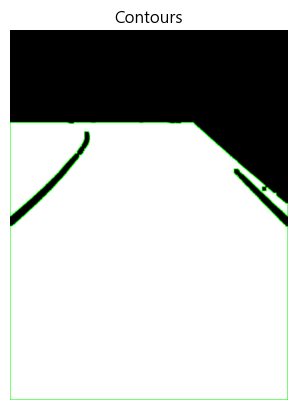

In [10]:
import cv2
import matplotlib.pyplot as plt

# 이진 마스크 이미지에서 contours를 추출했다고 가정
# contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# 원본 이미지를 복사하고 윤곽선 그리기
img_with_contours = cv2.cvtColor(binary, cv2.COLOR_GRAY2BGR)
cv2.drawContours(img_with_contours, contours, -1, (0, 255, 0), 2)

# RGB로 변환 후 시각화
plt.imshow(cv2.cvtColor(img_with_contours, cv2.COLOR_BGR2RGB))
plt.title('Contours')
plt.axis('off')
plt.show()

YOLOv11-seg 모델 './yolo11l-seg.pt'을(를) 로드했습니다.

0: 1024x768 10 cracks, 1279.5ms
Speed: 6.7ms preprocess, 1279.5ms inference, 58.0ms postprocess per image at shape (1, 3, 1024, 768)


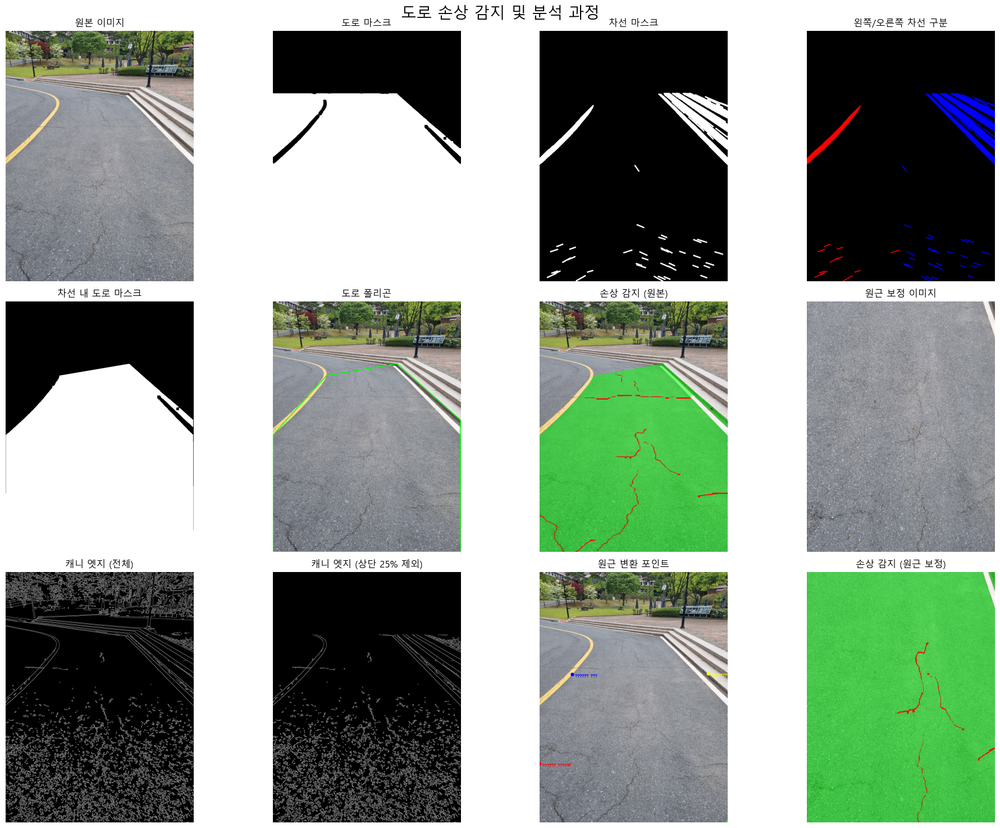

In [30]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

# 운영체제별 기본 폰트 설정
system = platform.system()
if system == 'Windows':
    font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
elif system == 'Darwin':  # macOS
    font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
else:  # Linux
    font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

# 폰트 패스가 유효한지 확인
try:
    font_prop = fm.FontProperties(fname=font_path)
    plt.rcParams['font.family'] = font_prop.get_name()
except:
    print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
    plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

# 그래프에서 마이너스 폰트 깨짐 방지
plt.rcParams['axes.unicode_minus'] = False

# 1. 모델 로드
model_path = './yolo11l-seg.pt'
model = YOLO(model_path)
print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")

# 2. 이미지 로드
img_path = './image/test_image_' + input() + '.jpg'
img_bgr = cv2.imread(img_path)
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_height, img_width = img_rgb.shape[:2]

# 3. 기본 도로 마스크 추출 함수
def extract_road_mask(img):
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열)
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외)
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

# 4. 차선 감지 및 마스크 생성 함수 - ROI 영역을 상단 25%로 제한
def detect_lane_lines_improved(img):
    # 그레이스케일 변환
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # 가우시안 블러
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    
    # 캐니 엣지 감지
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정 - 상단 25%를 제외한 나머지 영역만 고려
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    roi_mask[:int(height * 0.25), :] = 0  # 상단 25% 제외
    
    # ROI 적용된 엣지
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 범위 - 더 엄격한 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    # 노란색 범위 - 더 엄격한 범위 설정
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    
    # 색상 마스크에도 ROI 적용
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출 - 파라미터 조정
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,  # 임계값 증가
        minLineLength=30,  # 최소 선 길이 증가
        maxLineGap=5  # 최대 간격 감소
    )
    
    # 차선 마스크 생성
    lane_mask = np.zeros_like(gray)
    
    # 기울기 기반 필터링을 추가하여 수직/수평선 제거
    if lines is not None:
        filtered_lines = []
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이가 너무 짧으면 무시
            if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                slope = 999  # 큰 값으로 설정
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (차선은 대개 특정 각도 범위 내에 있음)
            if 0.3 < abs(slope) < 2:  # 약 15도 ~ 65도 범위
                filtered_lines.append(line)
                cv2.line(lane_mask, (x1, y1), (x2, y2), 255, 3)  # 선 두께 감소
    
    # 차선 클러스터링 - 왼쪽/오른쪽 차선 구분
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이가 너무 짧으면 무시
            if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 왼쪽/오른쪽 차선 구분
            if abs(slope) < 0.3 or abs(slope) > 2:  # 너무 평평하거나 수직인 선 제외
                continue
                
            # 중앙선 기준으로 왼쪽/오른쪽 구분
            mid_x = width // 2
            line_mid_x = (x1 + x2) // 2
            
            if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                cv2.line(left_line_mask, (x1, y1), (x2, y2), 255, 3)
            elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                cv2.line(right_line_mask, (x1, y1), (x2, y2), 255, 3)
    
    # 왼쪽/오른쪽 차선 합치기
    lane_mask = cv2.bitwise_or(left_line_mask, right_line_mask)
    
    # 차선 마스크 최소한의 확장만 수행
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges  # 추가 반환값

# 5. 차선 내부의 도로 영역과 아래쪽 도로 영역까지 마스크하는 함수
def extract_road_between_lanes_improved_with_bottom(img, road_mask, left_lane_mask, right_lane_mask):
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    
    # 각 차선에서 가장 위 지점 찾기
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 대체 포인트 설정 (차선이 충분히 감지되지 않은 경우)
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가 (차선 아래 부분 포함)
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

# 6. 원근 변환 함수
def perspective_transform(img, mask):
    # 마스크에서 모서리 포인트 추출
    _, binary = cv2.threshold(mask, 127, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 마스크가 비어있는 경우 기본값 사용
    if not contours:
        height, width = mask.shape
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
    else:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        
        # 외곽 포인트 추출
        extLeft = tuple(main_contour[main_contour[:, :, 0].argmin()][0])
        extRight = tuple(main_contour[main_contour[:, :, 0].argmax()][0])
        extTop = tuple(main_contour[main_contour[:, :, 1].argmin()][0])
        extBot = tuple(main_contour[main_contour[:, :, 1].argmax()][0])
        
        # 좌상단, 우상단, 좌하단, 우하단 코너 포인트 추출
        points = main_contour[:, 0, :]
        
        # y 좌표 중앙값으로 상/하 분할
        median_y = np.median(points[:, 1])
        lower = points[points[:, 1] > median_y]
        upper = points[points[:, 1] <= median_y]
        
        # 각 꼭짓점 선택
        if len(lower) > 0:
            bottom_left = lower[np.argmin(lower[:, 0])]
            bottom_right = lower[np.argmax(lower[:, 0])]
        else:
            height, width = mask.shape
            bottom_left = np.array([0, height-1])
            bottom_right = np.array([width-1, height-1])
            
        if len(upper) > 0:
            top_left = upper[np.argmin(upper[:, 0])]
            top_right = upper[np.argmax(upper[:, 0])]
        else:
            height, width = mask.shape
            top_left = np.array([width//4, height//3])
            top_right = np.array([width*3//4, height//3])
    
    # 소스 포인트 (원본 이미지에서 선택한 4개 점)
    src_points = np.float32([
        bottom_left, bottom_right, top_left, top_right
    ])
    
    # 도로 마스크 이미지 크기
    height, width = mask.shape
    
    # 타겟 포인트 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    
    # 원근 변환 적용
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

# 7. 마스크된 영역에서만 YOLO 추론 수행
def apply_yolo_on_masked_area(model, img, mask):
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        single_mask = res.masks.data[i].cpu().numpy()
        binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
        binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
        
        if cls == 0:  # crack
            mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
        elif cls == 1:  # pothole
            mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

# 8. 결과 시각화 함수
def visualize_results(original_img, road_mask, lane_mask, road_lane_mask, 
                     mask_crack, mask_pothole, warped_img, warped_mask, 
                     warped_crack, warped_pothole, corner_points):
    # 첫 번째 행: 마스크 단계별 시각화
    plt.figure(figsize=(20, 15))
    
    # 8.1 원본 이미지
    plt.subplot(3, 3, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    # 8.2 기본 도로 마스크
    plt.subplot(3, 3, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    # 8.3 차선 마스크
    plt.subplot(3, 3, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 8.4 차선 내 도로 마스크
    plt.subplot(3, 3, 4)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    # 8.5 손상 감지 시각화
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.subplot(3, 3, 5)
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    # 8.6 원근 보정 이미지
    plt.subplot(3, 3, 6)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 8.7 원근 보정된 마스크
    plt.subplot(3, 3, 7)
    plt.imshow(warped_mask, cmap='gray')
    plt.title('원근 보정된 마스크')
    plt.axis('off')
    
    # 8.8 원근 보정된 손상 감지
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    
    plt.subplot(3, 3, 8)
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    # 8.9 원근 변환 포인트 시각화
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 빨강, 초록, 파랑, 노랑
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        cv2.putText(img_with_points, f'{point_names[i]}', 
                   (int(point[0]) + 15, int(point[1]) + 15), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)
    
    plt.subplot(3, 3, 9)
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # 손상 면적 계산
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    total_damage_area = np.count_nonzero(cv2.bitwise_and(
        cv2.bitwise_or(mask_crack, mask_pothole), road_lane_mask))
    
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    warped_total_damage_area = np.count_nonzero(cv2.bitwise_and(
        cv2.bitwise_or(warped_crack, warped_pothole), warped_mask))
    


# 메인 코드 실행

# 1) 도로 마스크 생성
road_mask = extract_road_mask(img_bgr)

# 2) 차선 마스크 생성 (개선된 함수 사용)
lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines_improved(img_bgr)

# 3) 차선 내부의 도로와 아래 부분까지 마스크
road_lane_mask, road_polygon = extract_road_between_lanes_improved_with_bottom(img_bgr, road_mask, left_lane_mask, right_lane_mask)

# 4) 마스크된 영역에서 YOLO 추론
mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)

# 5) 원근 변환 적용
warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
    img_rgb, road_lane_mask)

# 6) 손상 마스크에도 원근 변환 적용
warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))

# 7) 결과 시각화 - 엣지 감지 결과 추가 (함수 파라미터 수정)
def visualize_improved_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask, 
                              road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                              warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                              edges, masked_edges):  # 추가된 파라미터
    # 첫 번째 행: 마스크 단계별 시각화
    plt.figure(figsize=(20, 15))
    
    # 8.1 원본 이미지
    plt.subplot(3, 4, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    # 8.2 기본 도로 마스크
    plt.subplot(3, 4, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    # 8.3 전체 차선 마스크
    plt.subplot(3, 4, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 8.4 왼쪽/오른쪽 차선 마스크
    plt.subplot(3, 4, 4)
    lane_combined = np.zeros((img_height, img_width, 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('왼쪽/오른쪽 차선 구분')
    plt.axis('off')
    
    # 8.5 차선 내 도로 마스크
    plt.subplot(3, 4, 5)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    # 8.6 도로 폴리곤 시각화
    plt.subplot(3, 4, 6)
    polygon_viz = original_img.copy()
    cv2.polylines(polygon_viz, [road_polygon], True, (0, 255, 0), 3)
    plt.imshow(polygon_viz)
    plt.title('도로 폴리곤')
    plt.axis('off')
    
    # 8.7 손상 감지 시각화
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    
    plt.subplot(3, 4, 7)
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    # 8.8 원근 보정 이미지
    plt.subplot(3, 4, 8)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 8.9 전체 엣지 이미지
    plt.subplot(3, 4, 9)
    plt.imshow(edges, cmap='gray')
    plt.title('캐니 엣지 (전체)')
    plt.axis('off')
    
    # 8.10 ROI 적용된 엣지 이미지
    plt.subplot(3, 4, 10)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('캐니 엣지 (상단 25% 제외)')
    plt.axis('off')
    
    # 8.11 원근 변환 포인트 시각화
    plt.subplot(3, 4, 11)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]  # 빨강, 초록, 파랑, 노랑
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        cv2.putText(img_with_points, f'{point_names[i]}', 
                   (int(point[0]) + 15, int(point[1]) + 15), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)
    
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    # 8.12 원근 보정된 손상 감지
    plt.subplot(3, 4, 12)
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 과정", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()

# 개선된 시각화 함수 호출 (파라미터 추가)
visualize_improved_results(
    img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
    road_lane_mask, road_polygon, mask_crack, mask_pothole, 
    warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
    edges, masked_edges  # 추가된 파라미터
)

# 1차 완성 모델
* 코너 및 점선에 취약함

YOLOv11-seg 모델 './model/yolo11l-seg.pt'을(를) 로드했습니다.
이미지 './image/test_image_01.jpg'을(를) 로드했습니다.

0: 1024x768 4 cracks, 1055.9ms
Speed: 8.1ms preprocess, 1055.9ms inference, 9.8ms postprocess per image at shape (1, 3, 1024, 768)


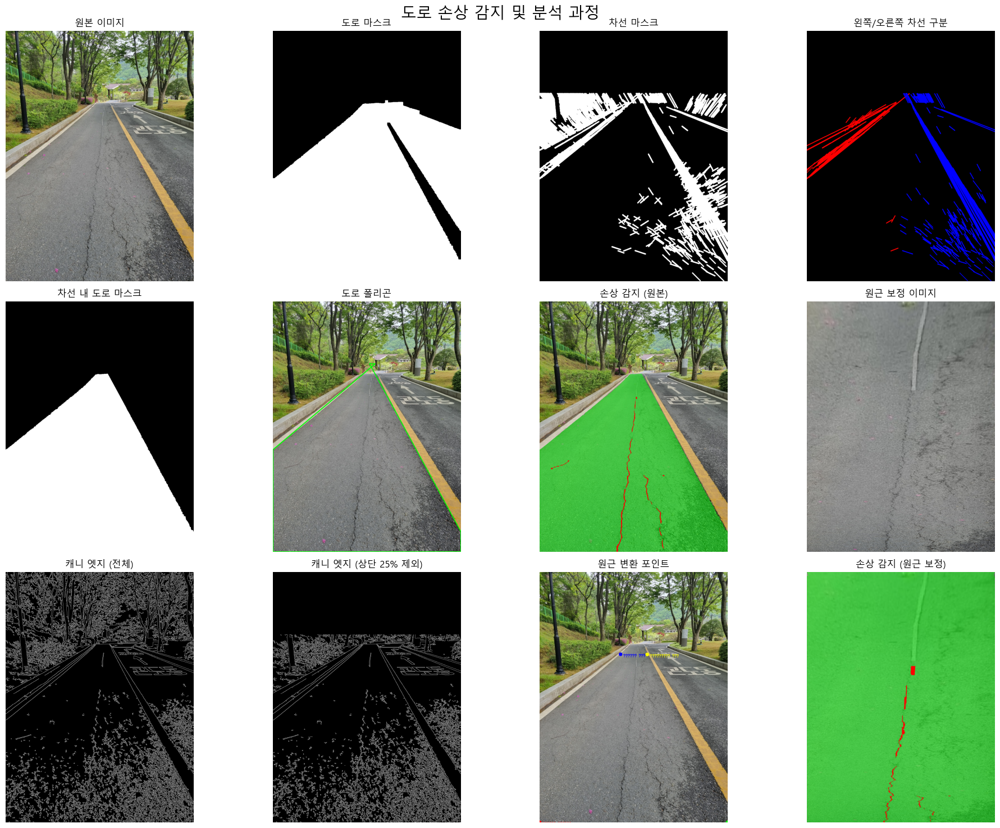


도로 영역 분석 결과:
도로 면적: 731523 픽셀
균열 면적: 10211 픽셀 (1.40%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 10211 픽셀 (1.40%)

원근 보정된 도로 영역 분석 결과:
도로 면적: 1492838 픽셀
균열 면적: 20694 픽셀 (1.39%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 20694 픽셀 (1.39%)


In [9]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    # 운영체제별 기본 폰트 설정
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def extract_road_mask(img):
    """도로 영역 추출 함수"""
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열)
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외)
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

def detect_lane_lines(img):
    """차선 감지 및 마스크 생성 함수"""
    # 그레이스케일 변환
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # 가우시안 블러 및 엣지 감지
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정 - 상단 25%를 제외한 영역만 고려
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    roi_mask[:int(height * 0.25), :] = 0
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=5
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이가 너무 짧으면 무시
            if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                cv2.line(lane_mask, (x1, y1), (x2, y2), 255, 3)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    cv2.line(left_line_mask, (x1, y1), (x2, y2), 255, 3)
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    cv2.line(right_line_mask, (x1, y1), (x2, y2), 255, 3)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """차선 내부의 도로 영역 추출 함수"""
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def get_default_perspective_points(road_polygon, height, width):
    """road_polygon이 있을 경우 사용하고, 없으면 기본값 설정"""
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])

def perspective_transform(img, mask, road_polygon=None):
    """
    원근 변환 함수 - 도로 마스크(road_lane_mask)의 모서리 포인트를 사용
    y값이 작은 지점을 우선적으로 선택하여 상단 포인트 설정
    """
    height, width = mask.shape
    
    # 도로 마스크에서 윤곽선 찾기
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours and len(contours) > 0:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            left_bottom = all_points[left_bottom_idx]
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            right_bottom = all_points[right_bottom_idx]
            
            # 상단 부분의 포인트 추출 (y값이 하위 10% 이내인 점들)
            y_threshold = np.percentile(all_points[:, 1], 10)
            top_points = all_points[all_points[:, 1] <= y_threshold]
            
            if len(top_points) > 0:
                # 왼쪽 상단: 상단 부분에서 x값이 가장 작은 점
                left_top_idx = np.argmin(top_points[:, 0])
                left_top = top_points[left_top_idx]
                
                # 오른쪽 상단: 상단 부분에서 x값이 가장 큰 점
                right_top_idx = np.argmax(top_points[:, 0])
                right_top = top_points[right_top_idx]
            else:
                # 상단 부분 포인트가 부족한 경우, y값을 우선 정렬하여 가장 작은 y값을 가진 포인트 중에서 선택
                sorted_by_y = all_points[np.argsort(all_points[:, 1])]
                top_n_points = sorted_by_y[:max(5, len(sorted_by_y) // 10)]  # 상위 10% 또는 최소 5개
                
                # 이 포인트들 중에서 왼쪽/오른쪽 구분
                left_top_idx = np.argmin(top_n_points[:, 0])
                left_top = top_n_points[left_top_idx]
                
                right_top_idx = np.argmax(top_n_points[:, 0])
                right_top = top_n_points[right_top_idx]
            
            src_points = np.float32([left_bottom, right_bottom, left_top, right_top])
        else:
            # 포인트가 없는 경우 기본값 사용
            src_points = get_default_perspective_points(road_polygon, height, width)
    else:
        # 윤곽선이 없는 경우 기본값 사용
        src_points = get_default_perspective_points(road_polygon, height, width)
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """마스크된 영역에서 YOLO 추론 수행"""
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     edges, masked_edges):
    """결과 시각화 함수"""
    plt.figure(figsize=(20, 15))
    
    # 첫 번째 행: 기본 이미지와 마스크
    plt.subplot(3, 4, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(3, 4, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 왼쪽/오른쪽 차선 구분
    plt.subplot(3, 4, 4)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('왼쪽/오른쪽 차선 구분')
    plt.axis('off')
    
    # 두 번째 행: 도로 분석
    plt.subplot(3, 4, 5)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 6)
    polygon_viz = original_img.copy()
    cv2.polylines(polygon_viz, [road_polygon], True, (0, 255, 0), 3)
    plt.imshow(polygon_viz)
    plt.title('도로 폴리곤')
    plt.axis('off')
    
    # 손상 감지 시각화
    plt.subplot(3, 4, 7)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(3, 4, 8)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 세 번째 행: 추가 분석
    plt.subplot(3, 4, 9)
    plt.imshow(edges, cmap='gray')
    plt.title('캐니 엣지 (전체)')
    plt.axis('off')
    
    plt.subplot(3, 4, 10)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('캐니 엣지 (상단 25% 제외)')
    plt.axis('off')
    
    # 원근 변환 포인트 시각화
    plt.subplot(3, 4, 11)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        cv2.putText(img_with_points, f'{point_names[i]}', 
                   (int(point[0]) + 15, int(point[1]) + 15), 
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, colors[i], 2)
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    # 원근 보정된 손상 감지
    plt.subplot(3, 4, 12)
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 과정", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    # 손상 면적 계산 및 출력
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    print(f"\n도로 영역 분석 결과:")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)")

    # 원근 보정된 이미지에서의 손상 면적 계산 및 출력
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    print(f"\n원근 보정된 도로 영역 분석 결과:")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)")

def main():
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = './model/yolo11l-seg.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'./image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
        edges, masked_edges
    )

if __name__ == "__main__":
    main()

# 취약점 개선 모델(진행중)

YOLOv11-seg 모델 './model/yolo11l-seg.pt'을(를) 로드했습니다.
이미지 './image/test_image_17.jpg'을(를) 로드했습니다.


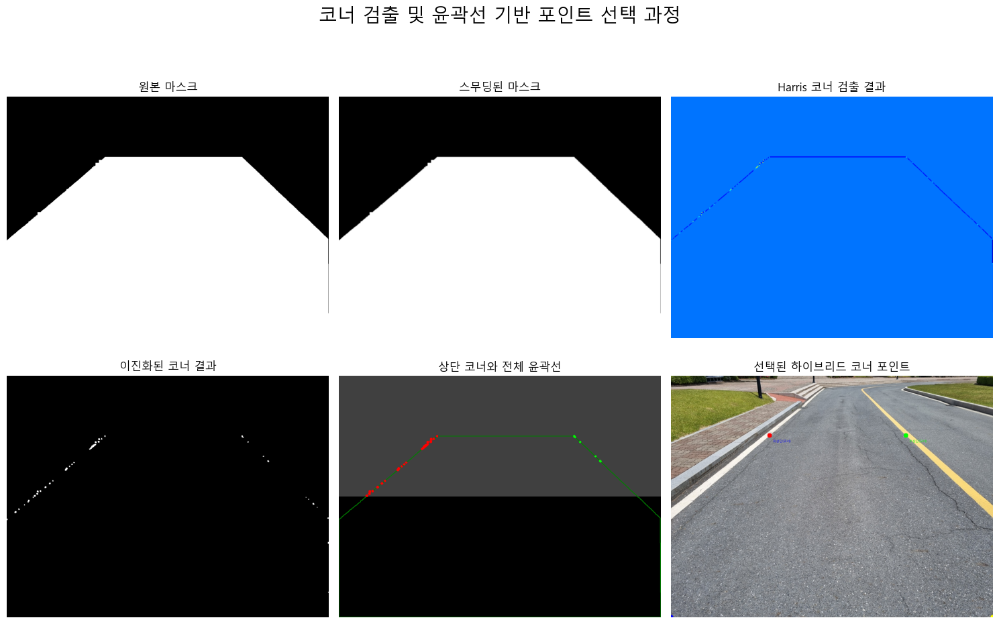


0: 768x1024 4 cracks, 1119.3ms
Speed: 8.6ms preprocess, 1119.3ms inference, 11.7ms postprocess per image at shape (1, 3, 768, 1024)


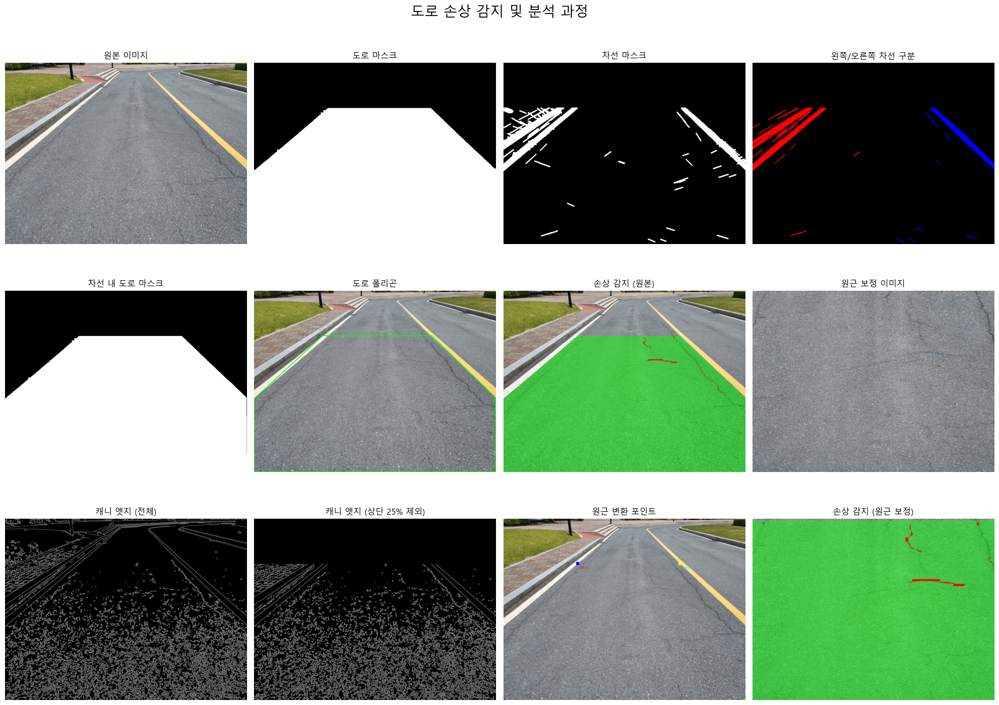


도로 영역 분석 결과:
도로 면적: 972032 픽셀
균열 면적: 5841 픽셀 (0.60%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 5841 픽셀 (0.60%)

원근 보정된 도로 영역 분석 결과:
도로 면적: 1482961 픽셀
균열 면적: 16332 픽셀 (1.10%)
포트홀 면적: 0 픽셀 (0.00%)
총 손상 면적: 16332 픽셀 (1.10%)


In [8]:
import cv2
import torch
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw, ImageFont
from ultralytics import YOLO

# matplotlib 한글 폰트 설정
import matplotlib.font_manager as fm
import platform

def setup_matplotlib_font():
    # 운영체제별 기본 폰트 설정
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕

    # 폰트 패스가 유효한지 확인
    try:
        font_prop = fm.FontProperties(fname=font_path)
        plt.rcParams['font.family'] = font_prop.get_name()
    except:
        print("기본 폰트를 사용합니다. 한글이 깨질 수 있습니다.")
        plt.rcParams['font.family'] = 'NanumGothic'  # 나눔고딕이 설치되어 있으면 사용

    # 그래프에서 마이너스 폰트 깨짐 방지
    plt.rcParams['axes.unicode_minus'] = False

def put_text_on_image(img, text, position, font_size=1, color=(255, 0, 0), thickness=2):
    """한글 텍스트를 이미지에 표시하는 함수"""
    # PIL 이미지로 변환
    pil_img = Image.fromarray(img)
    
    # 그리기 객체 생성
    draw = ImageDraw.Draw(pil_img)
    
    # 폰트 설정 (시스템에 맞게 조절 필요)
    system = platform.system()
    if system == 'Windows':
        font_path = 'C:/Windows/Fonts/malgun.ttf'  # 윈도우의 경우 맑은 고딕
    elif system == 'Darwin':  # macOS
        font_path = '/System/Library/Fonts/AppleSDGothicNeo.ttc'
    else:  # Linux
        font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'  # 우분투 기준 나눔고딕
    
    try:
        font = ImageFont.truetype(font_path, int(font_size * 20))
    except:
        print("폰트를 로드할 수 없습니다. 기본 폰트를 사용합니다.")
        font = ImageFont.load_default()
    
    # 텍스트 그리기
    draw.text(position, text, font=font, fill=color[::-1])  # RGB -> BGR 변환
    
    # NumPy 배열로 변환하여 반환
    return np.array(pil_img)

def extract_road_mask(img):
    """도로 영역 추출 함수"""
    # HSV 변환
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 도로 색상 범위 (회색 계열)
    lower_road = np.array([0, 0, 60])
    upper_road = np.array([180, 30, 160])
    road_mask = cv2.inRange(hsv, lower_road, upper_road)
    
    # 이미지 높이의 하단 75%만 고려 (상단 25% 제외)
    height = img.shape[0]
    road_mask[:int(height * 0.25), :] = 0
    
    # 노이즈 제거를 위한 모폴로지 연산
    kernel = np.ones((15, 15), np.uint8)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel)
    road_mask = cv2.morphologyEx(road_mask, cv2.MORPH_OPEN, np.ones((5, 5), np.uint8))
    
    # 가장 큰 연결 요소만 유지
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours:
        max_contour = max(contours, key=cv2.contourArea)
        if cv2.contourArea(max_contour) > (height * img.shape[1] * 0.1):
            refined_mask = np.zeros_like(road_mask)
            cv2.drawContours(refined_mask, [max_contour], 0, 255, -1)
            road_mask = refined_mask
    
    return road_mask

def detect_lane_lines(img):
    """차선 감지 및 마스크 생성 함수"""
    # 그레이스케일 변환
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    # 가우시안 블러 및 엣지 감지
    blur = cv2.GaussianBlur(gray, (5, 5), 0)
    edges = cv2.Canny(blur, 50, 150)
    
    # ROI 설정 - 상단 25%를 제외한 영역만 고려
    height, width = edges.shape
    roi_mask = np.ones_like(edges)
    roi_mask[:int(height * 0.25), :] = 0
    masked_edges = cv2.bitwise_and(edges, edges, mask=roi_mask)
    
    # 색상 기반 차선 추출 (흰색/노란색)
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # 흰색 및 노란색 범위 설정
    lower_white = np.array([0, 0, 200])
    upper_white = np.array([180, 30, 255])
    white_mask = cv2.inRange(hsv, lower_white, upper_white)
    
    lower_yellow = np.array([10, 60, 80])
    upper_yellow = np.array([40, 255, 255])
    yellow_mask = cv2.inRange(hsv, lower_yellow, upper_yellow)
    
    # 색상 마스크 통합 및 ROI 적용
    color_mask = cv2.bitwise_or(white_mask, yellow_mask)
    color_mask = cv2.bitwise_and(color_mask, color_mask, mask=roi_mask)
    
    # 최종 마스크 (엣지 + 색상)
    final_mask = cv2.bitwise_or(masked_edges, color_mask)
    
    # 호프 변환으로 직선 검출
    lines = cv2.HoughLinesP(
        final_mask, 
        rho=1, 
        theta=np.pi/180, 
        threshold=40,
        minLineLength=30,
        maxLineGap=5
    )
    
    # 차선 마스크 초기화
    lane_mask = np.zeros_like(gray)
    left_line_mask = np.zeros_like(gray)
    right_line_mask = np.zeros_like(gray)
    
    # 차선 필터링 및 분류
    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            
            # 선의 길이가 너무 짧으면 무시
            if np.sqrt((x2 - x1)**2 + (y2 - y1)**2) < 30:
                continue
                
            # 기울기 계산
            if x2 - x1 == 0:  # 수직선 방지
                continue
            else:
                slope = (y2 - y1) / (x2 - x1)
            
            # 적절한 기울기 범위만 선택 (약 15도 ~ 65도 범위)
            if 0.3 < abs(slope) < 2:  
                cv2.line(lane_mask, (x1, y1), (x2, y2), 255, 3)
                
                # 왼쪽/오른쪽 차선 구분
                mid_x = width // 2
                line_mid_x = (x1 + x2) // 2
                
                if slope < 0 and line_mid_x < mid_x:  # 왼쪽 차선 (음수 기울기)
                    cv2.line(left_line_mask, (x1, y1), (x2, y2), 255, 3)
                elif slope > 0 and line_mid_x > mid_x:  # 오른쪽 차선 (양수 기울기)
                    cv2.line(right_line_mask, (x1, y1), (x2, y2), 255, 3)
    
    # 차선 마스크 확장
    kernel = np.ones((3, 3), np.uint8)
    lane_mask = cv2.dilate(lane_mask, kernel, iterations=1)
    
    return lane_mask, left_line_mask, right_line_mask, edges, masked_edges

def extract_road_between_lanes(img, road_mask, left_lane_mask, right_lane_mask):
    """차선 내부의 도로 영역 추출 함수"""
    height, width = road_mask.shape
    
    # 왼쪽과 오른쪽 차선 윤곽선 찾기
    left_contours, _ = cv2.findContours(left_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    right_contours, _ = cv2.findContours(right_lane_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # 차선 마스크가 충분하지 않으면 기본 도로 마스크 반환
    if not left_contours or not right_contours:
        return road_mask, None
    
    # 가장 큰 왼쪽/오른쪽 차선 윤곽선 선택
    left_contour = max(left_contours, key=cv2.contourArea) if left_contours else None
    right_contour = max(right_contours, key=cv2.contourArea) if right_contours else None
    
    if left_contour is None or right_contour is None:
        return road_mask, None
    
    # 왼쪽/오른쪽 차선의 외곽점 찾기
    left_points = left_contour.reshape(-1, 2)
    right_points = right_contour.reshape(-1, 2)
    
    # 각 차선에서 가장 아래/위 지점 찾기
    left_bottom = left_points[np.argmax(left_points[:, 1])]
    right_bottom = right_points[np.argmax(right_points[:, 1])]
    left_top = left_points[np.argmin(left_points[:, 1])]
    right_top = right_points[np.argmin(right_points[:, 1])]
    
    # 차선이 충분히 감지되지 않은 경우 대체 포인트 설정
    if np.linalg.norm(left_top - left_bottom) < 50:
        left_top[1] = max(0, height - height//3)
    
    if np.linalg.norm(right_top - right_bottom) < 50:
        right_top[1] = max(0, height - height//3)
        
    # 이미지 하단 좌표 추가
    bottom_left = [0, height-1]
    bottom_right = [width-1, height-1]
    
    # 도로 폴리곤 생성 (차선 내부 + 차선 아래 영역)
    road_polygon = np.array([
        bottom_left, left_bottom, left_top, right_top, right_bottom, bottom_right
    ], dtype=np.int32)
    
    # 도로 영역 마스크 생성
    lane_road_mask = np.zeros_like(road_mask)
    cv2.fillPoly(lane_road_mask, [road_polygon], 255)
    
    # 원래 도로 마스크와 교차
    final_road_mask = cv2.bitwise_and(road_mask, lane_road_mask)
    
    return final_road_mask, road_polygon

def get_default_perspective_points(road_polygon, height, width):
    """road_polygon이 있을 경우 사용하고, 없으면 기본값 설정"""
    if road_polygon is not None and len(road_polygon) >= 6:
        # road_polygon에서 필요한 포인트 추출
        left_bottom = road_polygon[1]  # 왼쪽 차선 하단
        right_bottom = road_polygon[4] # 오른쪽 차선 하단
        left_top = road_polygon[2]     # 왼쪽 차선 상단
        right_top = road_polygon[3]    # 오른쪽 차선 상단
        
        # 사용할 코너 포인트
        return np.float32([left_bottom, right_bottom, left_top, right_top])
    else:
        # 기본값 설정
        bottom_left = np.array([0, height-1])
        bottom_right = np.array([width-1, height-1])
        top_left = np.array([width//4, height//3])
        top_right = np.array([width*3//4, height//3])
        
        return np.float32([bottom_left, bottom_right, top_left, top_right])

def perspective_transform(img, mask, road_polygon=None):
    """
    원근 변환 함수 - 상단 포인트는 코너 특징점으로, 하단 포인트는 기존 방식으로 찾기
    """
    height, width = mask.shape
    
    # 상단 포인트용 코너 검출에 적합한 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 코너 검출 결과를 이진화하고 팽창 (더 뚜렷하게)
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 포인트 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    corner_y = corner_coords[0]
    corner_x = corner_coords[1]
    
    # 모든 코너 좌표를 리스트로 변환
    all_corners = []
    for i in range(len(corner_y)):
        all_corners.append([corner_x[i], corner_y[i]])
    
    # 코너가 충분히 많지 않으면 대체 방식 사용
    if len(all_corners) < 10:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 이미지를 4분할하여 상단 영역에서 코너점 찾기
    h_mid = height // 2
    w_mid = width // 2
    
    # 상단 영역의 코너 포인트
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    
    # 상단 영역에 코너가 없는 경우 대체 방법 사용
    if not (top_left_corners and top_right_corners):
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 좌상단: 원점에서 가장 가까운 포인트
    top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    
    # 우상단: (width, 0)에서 가장 가까운 포인트
    top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
    
    # 하단 포인트는 기존 방식으로 찾기
    # 도로 마스크에서 윤곽선 찾기
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if not contours or len(contours) == 0:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 가장 큰 윤곽선 선택
    main_contour = max(contours, key=cv2.contourArea)
    all_points = main_contour.reshape(-1, 2)
    
    if len(all_points) == 0:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 왼쪽 하단: x값 최소, y값 최대
    left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
    bottom_left = all_points[left_bottom_idx]
    
    # 오른쪽 하단: x값 최대, y값 최대
    right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
    bottom_right = all_points[right_bottom_idx]
    
    # 포인트 추가 검증: y 좌표가 위아래 구분에 맞게 정렬
    if top_left[1] > bottom_left[1] or top_right[1] > bottom_right[1]:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 포인트 추가 검증: x 좌표가 좌우 구분에 맞게 정렬
    if top_left[0] > top_right[0] or bottom_left[0] > bottom_right[0]:
        return fallback_perspective_transform(img, mask, road_polygon)
    
    # 원근 변환에 사용할 소스 포인트
    src_points = np.float32([
        bottom_left,    # 좌하단
        bottom_right,   # 우하단
        top_left,       # 좌상단
        top_right       # 우상단
    ])
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def fallback_perspective_transform(img, mask, road_polygon=None):
    """
    코너 검출이 실패했을 때 사용하는 대체 원근 변환 함수
    기존의 방식을 사용
    """
    height, width = mask.shape
    
    # 도로 마스크에서 윤곽선 찾기
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    if contours and len(contours) > 0:
        # 가장 큰 윤곽선 선택
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            left_bottom = all_points[left_bottom_idx]
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            right_bottom = all_points[right_bottom_idx]
            
            # 상단 부분의 포인트 추출 (y값이 하위 10% 이내인 점들)
            y_threshold = np.percentile(all_points[:, 1], 10)
            top_points = all_points[all_points[:, 1] <= y_threshold]
            
            if len(top_points) > 0:
                # 왼쪽 상단: 상단 부분에서 x값이 가장 작은 점
                left_top_idx = np.argmin(top_points[:, 0])
                left_top = top_points[left_top_idx]
                
                # 오른쪽 상단: 상단 부분에서 x값이 가장 큰 점
                right_top_idx = np.argmax(top_points[:, 0])
                right_top = top_points[right_top_idx]
            else:
                # 상단 부분 포인트가 부족한 경우, y값을 우선 정렬하여 가장 작은 y값을 가진 포인트 중에서 선택
                sorted_by_y = all_points[np.argsort(all_points[:, 1])]
                top_n_points = sorted_by_y[:max(5, len(sorted_by_y) // 10)]  # 상위 10% 또는 최소 5개
                
                # 이 포인트들 중에서 왼쪽/오른쪽 구분
                left_top_idx = np.argmin(top_n_points[:, 0])
                left_top = top_n_points[left_top_idx]
                
                right_top_idx = np.argmax(top_n_points[:, 0])
                right_top = top_n_points[right_top_idx]
            
            src_points = np.float32([left_bottom, right_bottom, left_top, right_top])
        else:
            # 포인트가 없는 경우 기본값 사용
            src_points = get_default_perspective_points(road_polygon, height, width)
    else:
        # 윤곽선이 없는 경우 기본값 사용
        src_points = get_default_perspective_points(road_polygon, height, width)
    
    # 타겟 포인트 설정 (변환 후 이미지에서의 위치)
    dst_points = np.float32([
        [0, height-1],               # 왼쪽 하단
        [width-1, height-1],         # 오른쪽 하단
        [0, 0],                      # 왼쪽 상단
        [width-1, 0]                 # 오른쪽 상단
    ])
    
    # 원근 변환 행렬 계산 및 적용
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped_img = cv2.warpPerspective(img, M, (width, height))
    warped_mask = cv2.warpPerspective(mask, M, (width, height))
    
    return warped_img, warped_mask, M, src_points

def apply_yolo_on_masked_area(model, img, mask):
    """마스크된 영역에서 YOLO 추론 수행"""
    # 마스크를 3채널로 확장
    mask_3ch = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
    
    # 마스크 적용된 이미지 생성
    masked_img = cv2.bitwise_and(img, mask_3ch)
    
    # YOLO 추론
    results = model(masked_img)
    res = results[0]
    
    # 클래스별 마스크 생성
    mask_crack = np.zeros(img.shape[:2], dtype=np.uint8)
    mask_pothole = np.zeros(img.shape[:2], dtype=np.uint8)
    
    for i, box in enumerate(res.boxes):
        cls = int(box.cls[0])
        if i < len(res.masks):  # 안전하게 인덱스 확인
            single_mask = res.masks.data[i].cpu().numpy()
            binary_mask = (single_mask > 0.5).astype(np.uint8) * 255
            binary_mask_resized = cv2.resize(binary_mask, (img.shape[1], img.shape[0]))
            
            if cls == 0:  # crack
                mask_crack = cv2.bitwise_or(mask_crack, binary_mask_resized)
            elif cls == 1:  # pothole
                mask_pothole = cv2.bitwise_or(mask_pothole, binary_mask_resized)
    
    return mask_crack, mask_pothole

def visualize_corner_detection(img, mask):
    """코너 검출 과정과 결과를 시각화하는 함수 - 하이브리드 방식 시각화"""
    height, width = mask.shape
    
    # 코너 검출에 사용된 마스크 준비
    mask_smooth = cv2.GaussianBlur(mask, (5, 5), 0)
    
    # Harris 코너 검출
    corners = cv2.cornerHarris(mask_smooth, blockSize=5, ksize=3, k=0.04)
    
    # 결과 이진화 및 팽창
    corners_dilated = cv2.dilate(corners, None)
    _, corners_binary = cv2.threshold(corners_dilated, 0.01 * corners_dilated.max(), 255, 0)
    corners_binary = np.uint8(corners_binary)

    # 코너 좌표 추출
    corner_coords = np.where(corners_binary > 0)
    all_corners = []
    for i in range(len(corner_coords[0])):
        all_corners.append([corner_coords[1][i], corner_coords[0][i]])  # x, y 순서로 저장
    
    # 이미지 상단/하단 구분
    h_mid = height // 2
    w_mid = width // 2
    
    # 상단 영역의 코너 포인트 분류
    top_left_corners = [p for p in all_corners if p[0] < w_mid and p[1] < h_mid]
    top_right_corners = [p for p in all_corners if p[0] >= w_mid and p[1] < h_mid]
    
    # 최적의 상단 코너 포인트 계산
    selected_corners = []
    if top_left_corners:
        top_left = min(top_left_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_left)
    
    if top_right_corners:
        top_right = min(top_right_corners, key=lambda p: (p[0]-w_mid)**2 + p[1]**2)
        selected_corners.append(top_right)
    
    # 하단 포인트 계산 (기존 방식)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if contours and len(contours) > 0:
        main_contour = max(contours, key=cv2.contourArea)
        all_points = main_contour.reshape(-1, 2)
        
        if len(all_points) > 0:
            # 왼쪽 하단: x값 최소, y값 최대
            left_bottom_idx = np.lexsort((all_points[:, 0], -all_points[:, 1]))[0]
            bottom_left = all_points[left_bottom_idx]
            selected_corners.append(bottom_left)
            
            # 오른쪽 하단: x값 최대, y값 최대
            right_bottom_idx = np.lexsort((-all_points[:, 0], -all_points[:, 1]))[0]
            bottom_right = all_points[right_bottom_idx]
            selected_corners.append(bottom_right)
    
# 시각화
    plt.figure(figsize=(15, 10))
    
    # 원본 마스크
    plt.subplot(2, 3, 1)
    plt.imshow(mask, cmap='gray')
    plt.title('원본 마스크')
    plt.axis('off')
    
    # 스무딩된 마스크
    plt.subplot(2, 3, 2)
    plt.imshow(mask_smooth, cmap='gray')
    plt.title('스무딩된 마스크')
    plt.axis('off')
    
    # Harris 코너 검출 결과
    plt.subplot(2, 3, 3)
    plt.imshow(corners, cmap='jet')
    plt.title('Harris 코너 검출 결과')
    plt.axis('off')
    
    # 이진화된 코너 결과
    plt.subplot(2, 3, 4)
    plt.imshow(corners_binary, cmap='gray')
    plt.title('이진화된 코너 결과')
    plt.axis('off')
    
    # 상단 코너와 윤곽선 구분
    plt.subplot(2, 3, 5)
    visualization = np.zeros((height, width, 3), dtype=np.uint8)
    
    # 상단 영역 표시 (밝은 회색)
    visualization[:h_mid, :] = [64, 64, 64]
    
    # 윤곽선 표시
    if contours and len(contours) > 0:
        cv2.drawContours(visualization, [main_contour], 0, [0, 128, 0], 2)
    
    # 상단 코너 표시
    for p in top_left_corners:
        cv2.circle(visualization, tuple(p), 2, [255, 0, 0], -1)  # 빨간색
    for p in top_right_corners:
        cv2.circle(visualization, tuple(p), 2, [0, 255, 0], -1)  # 초록색
    
    plt.imshow(visualization)
    plt.title('상단 코너와 전체 윤곽선')
    plt.axis('off')
    
    # 선택된 코너 포인트
    plt.subplot(2, 3, 6)
    img_with_corners = img.copy()
    point_names = ['좌상단(코너)', '우상단(코너)', '좌하단(윤곽선)', '우하단(윤곽선)']
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    
    for i, p in enumerate(selected_corners):
        if i < len(point_names):
            cv2.circle(img_with_corners, tuple(p), 10, colors[i], -1)
            # PIL로 한글 텍스트 추가
            img_with_corners = put_text_on_image(
                img_with_corners, 
                point_names[i], 
                (p[0] + 15, p[1] + 15), 
                font_size=0.7, 
                color=colors[i]
            )
    
    plt.imshow(img_with_corners)
    plt.title('선택된 하이브리드 코너 포인트')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("코너 검출 및 윤곽선 기반 포인트 선택 과정", fontsize=20)
    plt.subplots_adjust(top=0.9)
    plt.show()

def visualize_results(original_img, road_mask, lane_mask, left_lane_mask, right_lane_mask,
                     road_lane_mask, road_polygon, mask_crack, mask_pothole, 
                     warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
                     edges, masked_edges):
    """결과 시각화 함수"""
    plt.figure(figsize=(20, 15))
    
    # 첫 번째 행: 기본 이미지와 마스크
    plt.subplot(3, 4, 1)
    plt.imshow(original_img)
    plt.title('원본 이미지')
    plt.axis('off')
    
    plt.subplot(3, 4, 2)
    plt.imshow(road_mask, cmap='gray')
    plt.title('도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 3)
    plt.imshow(lane_mask, cmap='gray')
    plt.title('차선 마스크')
    plt.axis('off')
    
    # 왼쪽/오른쪽 차선 구분
    plt.subplot(3, 4, 4)
    lane_combined = np.zeros((original_img.shape[0], original_img.shape[1], 3), dtype=np.uint8)
    lane_combined[left_lane_mask == 255] = [255, 0, 0]  # 왼쪽 차선: 빨간색
    lane_combined[right_lane_mask == 255] = [0, 0, 255]  # 오른쪽 차선: 파란색
    plt.imshow(lane_combined)
    plt.title('왼쪽/오른쪽 차선 구분')
    plt.axis('off')
    
    # 두 번째 행: 도로 분석
    plt.subplot(3, 4, 5)
    plt.imshow(road_lane_mask, cmap='gray')
    plt.title('차선 내 도로 마스크')
    plt.axis('off')
    
    plt.subplot(3, 4, 6)
    polygon_viz = original_img.copy()
    cv2.polylines(polygon_viz, [road_polygon], True, (0, 255, 0), 3)
    plt.imshow(polygon_viz)
    plt.title('도로 폴리곤')
    plt.axis('off')
    
    # 손상 감지 시각화
    plt.subplot(3, 4, 7)
    overlay_original = original_img.copy()
    alpha = 0.5
    road_overlay = overlay_original.copy()
    road_overlay[road_lane_mask == 255] = [0, 255, 0]  # 도로: 초록색
    overlay_original = cv2.addWeighted(road_overlay, alpha, overlay_original, 1-alpha, 0)
    overlay_original[mask_crack == 255] = [255, 0, 0]  # 균열: 빨간색
    overlay_original[mask_pothole == 255] = [0, 0, 255]  # 포트홀: 파란색
    plt.imshow(overlay_original)
    plt.title('손상 감지 (원본)')
    plt.axis('off')
    
    plt.subplot(3, 4, 8)
    plt.imshow(warped_img)
    plt.title('원근 보정 이미지')
    plt.axis('off')
    
    # 세 번째 행: 추가 분석
    plt.subplot(3, 4, 9)
    plt.imshow(edges, cmap='gray')
    plt.title('캐니 엣지 (전체)')
    plt.axis('off')
    
    plt.subplot(3, 4, 10)
    plt.imshow(masked_edges, cmap='gray')
    plt.title('캐니 엣지 (상단 25% 제외)')
    plt.axis('off')
    
    # 원근 변환 포인트 시각화
    plt.subplot(3, 4, 11)
    img_with_points = original_img.copy()
    colors = [(255, 0, 0), (0, 255, 0), (0, 0, 255), (255, 255, 0)]
    point_names = ['왼쪽 아래', '오른쪽 아래', '왼쪽 위', '오른쪽 위']
    
    for i, point in enumerate(corner_points):
        cv2.circle(img_with_points, (int(point[0]), int(point[1])), 10, colors[i], -1)
        # PIL로 한글 텍스트 추가
        img_with_points = put_text_on_image(
            img_with_points, 
            point_names[i], 
            (int(point[0]) + 15, int(point[1]) + 15), 
            font_size=0.7, 
            color=colors[i]
        )
    plt.imshow(img_with_points)
    plt.title('원근 변환 포인트')
    plt.axis('off')
    
    # 원근 보정된 손상 감지
    plt.subplot(3, 4, 12)
    overlay_warped = warped_img.copy()
    road_overlay_warped = overlay_warped.copy()
    road_overlay_warped[warped_mask == 255] = [0, 255, 0]
    overlay_warped = cv2.addWeighted(road_overlay_warped, alpha, overlay_warped, 1-alpha, 0)
    overlay_warped[warped_crack == 255] = [255, 0, 0]
    overlay_warped[warped_pothole == 255] = [0, 0, 255]
    plt.imshow(overlay_warped)
    plt.title('손상 감지 (원근 보정)')
    plt.axis('off')
    
    plt.tight_layout()
    plt.suptitle("도로 손상 감지 및 분석 과정", fontsize=20)
    plt.subplots_adjust(top=0.95)
    plt.show()
    
    # 손상 면적 계산 및 출력
    road_area = np.count_nonzero(road_lane_mask)
    crack_area = np.count_nonzero(cv2.bitwise_and(mask_crack, road_lane_mask))
    pothole_area = np.count_nonzero(cv2.bitwise_and(mask_pothole, road_lane_mask))
    
    print(f"\n도로 영역 분석 결과:")
    print(f"도로 면적: {road_area} 픽셀")
    print(f"균열 면적: {crack_area} 픽셀 ({crack_area/road_area*100:.2f}%)")
    print(f"포트홀 면적: {pothole_area} 픽셀 ({pothole_area/road_area*100:.2f}%)")
    print(f"총 손상 면적: {crack_area + pothole_area} 픽셀 ({(crack_area + pothole_area)/road_area*100:.2f}%)")

    # 원근 보정된 이미지에서의 손상 면적 계산 및 출력
    warped_road_area = np.count_nonzero(warped_mask)
    warped_crack_area = np.count_nonzero(cv2.bitwise_and(warped_crack, warped_mask))
    warped_pothole_area = np.count_nonzero(cv2.bitwise_and(warped_pothole, warped_mask))
    
    print(f"\n원근 보정된 도로 영역 분석 결과:")
    print(f"도로 면적: {warped_road_area} 픽셀")
    print(f"균열 면적: {warped_crack_area} 픽셀 ({warped_crack_area/warped_road_area*100:.2f}%)")
    print(f"포트홀 면적: {warped_pothole_area} 픽셀 ({warped_pothole_area/warped_road_area*100:.2f}%)")
    print(f"총 손상 면적: {warped_crack_area + warped_pothole_area} 픽셀 ({(warped_crack_area + warped_pothole_area)/warped_road_area*100:.2f}%)")

def main():
    # 폰트 설정
    setup_matplotlib_font()
    
    # 모델 로드
    model_path = './model/yolo11l-seg.pt'
    model = YOLO(model_path)
    print(f"YOLOv11-seg 모델 '{model_path}'을(를) 로드했습니다.")
    
    # 이미지 로드
    img_num = input("테스트할 이미지 번호를 입력하세요: ")
    img_path = f'./image/test_image_{img_num}.jpg'
    print(f"이미지 '{img_path}'을(를) 로드했습니다.")
    img_bgr = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
    img_height, img_width = img_rgb.shape[:2]
    
    # 도로 마스크 생성
    road_mask = extract_road_mask(img_bgr)
    
    # 차선 마스크 생성
    lane_mask, left_lane_mask, right_lane_mask, edges, masked_edges = detect_lane_lines(img_bgr)
    
    # 차선 내부의 도로와 아래 부분까지 마스크
    road_lane_mask, road_polygon = extract_road_between_lanes(img_bgr, road_mask, left_lane_mask, right_lane_mask)
    
    # 코너 검출 과정 시각화 (선택 사항)
    visualize_corner_detection(img_rgb, road_lane_mask)
    
    # 마스크된 영역에서 YOLO 추론
    mask_crack, mask_pothole = apply_yolo_on_masked_area(model, img_rgb, road_lane_mask)
    
    # 원근 변환 적용 - road_lane_mask를 사용
    warped_img, warped_mask, perspective_matrix, corner_points = perspective_transform(
        img_rgb, road_lane_mask, road_polygon)
    
    # 손상 마스크에도 원근 변환 적용
    warped_crack = cv2.warpPerspective(mask_crack, perspective_matrix, (img_width, img_height))
    warped_pothole = cv2.warpPerspective(mask_pothole, perspective_matrix, (img_width, img_height))
    
    # 결과 시각화
    visualize_results(
        img_rgb, road_mask, lane_mask, left_lane_mask, right_lane_mask,
        road_lane_mask, road_polygon, mask_crack, mask_pothole, 
        warped_img, warped_mask, warped_crack, warped_pothole, corner_points,
        edges, masked_edges
    )

if __name__ == "__main__":
    main()

# 마지막 지점